In [7]:
import importlib
categories = importlib.import_module('categories')

from categories import secondary_category_BoW_flattened, primary_category_BoW, secondary_category_BoW
from predict_string import rank_categories_by_features
import pandas as pd
import json

In [8]:
# About GT labelling - construct value pool templates
concrete_primary_categories = set(primary_category_BoW.keys()) - set(secondary_category_BoW)

all_concrete_categories = concrete_primary_categories.union(secondary_category_BoW_flattened.keys())
value_pool = {}

for cat in all_concrete_categories:
    value_pool[cat] = {
        'general': []
    }
    
import json
print(json.dumps(value_pool, indent=4))

{
    "phone": {
        "general": []
    },
    "news": {
        "general": []
    },
    "year": {
        "general": []
    },
    "album": {
        "general": []
    },
    "song": {
        "general": []
    },
    "music": {
        "general": []
    },
    "podcast": {
        "general": []
    },
    "email": {
        "general": []
    },
    "iot_device": {
        "general": []
    },
    "movie": {
        "general": []
    },
    "country_code": {
        "general": []
    },
    "month": {
        "general": []
    },
    "message": {
        "general": []
    },
    "time": {
        "general": []
    },
    "username": {
        "general": []
    },
    "ratio": {
        "general": []
    },
    "name": {
        "general": []
    },
    "company": {
        "general": []
    },
    "video": {
        "general": []
    },
    "department": {
        "general": []
    },
    "tv_show": {
        "general": []
    },
    "second": {
        "general": []
    },
    "a

In [9]:

with open('data/GT/labels.json') as f:
    labels = json.load(f)
    
for tf_path, data in labels.items():
    concrete_categories = []
    for pcat, scats in data['GT_categories']:
        if len(scats) == 0:
            concrete_categories.append(pcat)
        else:
            concrete_categories.extend(scats)
            
    for ct in concrete_categories:
        value_pool[ct]['general'].append(data['sample_text'])

In [10]:
for cat, values in value_pool.items():
    value_pool[cat]['general'] = list(set(values['general']))


print(json.dumps(value_pool, indent=4))

{
    "phone": {
        "general": [
            "(010) 4940-4583",
            "01049404583",
            "samsung3@samsung.com",
            "010-4940-4583",
            "556 123"
        ]
    },
    "news": {
        "general": [
            "elle",
            "worldcup"
        ]
    },
    "year": {
        "general": [
            "30",
            "2022"
        ]
    },
    "album": {
        "general": []
    },
    "song": {
        "general": [
            "love dive"
        ]
    },
    "music": {
        "general": [
            "love dive"
        ]
    },
    "podcast": {
        "general": [
            "bbc news"
        ]
    },
    "email": {
        "general": [
            "asdf123@naver.com",
            "samsung2@samsung.com",
            "01049404583",
            "abcd1234@kaist.ac.kr",
            "samsung3@samsung.com"
        ]
    },
    "iot_device": {
        "general": [
            "galaxy10"
        ]
    },
    "movie": {
        "general": [
    

In [11]:
def get_GT_categories(tf_label):
    categories = {}
    for cat in tf_label['GT_categories']:
        categories[cat[0]] = cat[1]
    
    pcats = list(categories.keys())
    
    return pcats, categories


def get_cat_rank(GT_cats, cats_ranked):
    cats_ranked = [c[0] for c in cats_ranked]
    min_rank = 100000
    for GT_cat in GT_cats:
        rank = cats_ranked.index(GT_cat) + 1
        if rank < min_rank:
            min_rank = rank
    
    return min_rank

In [83]:
with open('data/textfield_features_samsung.json') as f:
    d = json.load(f)
    
apps = []
for x in d:
    apps.append(d[x]['app_name'])

print(len(d))
for a in set(apps):
    print(a)
len(set(apps))

33
Galaxy Store
Calendar
Messages
Samsung Internet
Contacts
Gallery
Clock
Settings
My Files
SmartThings
Samsung Members


11

In [52]:
queue = ['data/textfield_features_OSS.json', 'data/textfield_features_samsung.json']

labels = json.load(open('data/GT/labels.json'))

ranking_result = []

settings_w = [
    {
        'setting_name': 'weight_g_0.0',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.0,
        'weight_g_s': 0.0,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.25',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.25,
        'weight_g_s': 0.25,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.5',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.5,
        'weight_g_s': 0.5,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.75',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.75,
        'weight_g_s': 0.75,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_1.0',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 1.0,
        'weight_g_s': 1.0,
        'extend_local_ctx': True
    }
]


for tf_feature_file in queue:
    tf_features = json.load(open(tf_feature_file))
    
    for tf_path, tf in tqdm(tf_features.items()):
        if tf_path not in labels:
            continue # skip not yet labelled data
        
        GT_pcats, GT_categories = get_GT_categories(labels[tf_path])
        
        for s in settings_w:

            primary_rank_result = rank_categories_by_features(tf['textfield_tokens'], tf['local_context'], tf['global_context'], category_BoW=primary_category_BoW, prune=s['prune'], prune_count=s['prune_count'], weight_g=s['weight_g_p'], extend_local_ctx=s['extend_local_ctx'], baseline=s['baseline_dist_func'])
            pcat = primary_rank_result[0][0]
            # TODO: try top2/top3 ranked primary categories too? 

            secondary_rank_result = []
            scat = None

            if pcat in secondary_category_BoW:
                secondary_rank_result = rank_categories_by_features(tf['textfield_tokens'], tf['local_context'], tf['global_context'], category_BoW=secondary_category_BoW[pcat], prune=s['prune'], prune_count=s['prune_count'], weight_g=s['weight_g_s'], extend_local_ctx=s['extend_local_ctx'], baseline=s['baseline_dist_func'])
                scat = secondary_rank_result[0][0]
                if pcat in GT_pcats:
                    scat_rank = get_cat_rank(GT_categories[pcat], secondary_rank_result)

                else:
                    scat_rank = -1
            elif pcat in GT_pcats:
                scat_rank = 1
            else:
                scat_rank = -1


            ranking_result.append({
                'source': tf_feature_file,
                'setting': s['setting_name'],
                'app_name': tf['app_name'],
                'tf_path': tf_path,
                'pred_top1': [pcat, scat],
                'GT_categories': GT_categories,
                'pcat_rank': get_cat_rank(GT_pcats, primary_rank_result),
                'scat_rank': scat_rank,
                'primary_categories_ranked': primary_rank_result,
                'secondary_categories_ranked': secondary_rank_result
            })
        
w_rank_df = pd.DataFrame(ranking_result)

100%|██████████| 33/33 [00:42<00:00,  1.29s/it]


In [53]:
w_rank_df

,source,setting,app_name,tf_path,pred_top1,GT_categories,pcat_rank,scat_rank,primary_categories_ranked,secondary_categories_ranked
0,data/textfield_features_OSS.json,weight_g_0.0,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.37276495123902953), (auth_code, 0...","[(email, 0.2147888019680977), (password, 0.645..."
1,data/textfield_features_OSS.json,weight_g_0.25,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.3218121575191617), (auth_code, 0....","[(email, 0.2086115845789512), (phone, 0.582067..."
2,data/textfield_features_OSS.json,weight_g_0.5,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.2708593637992938), (auth_code, 0....","[(email, 0.20243436718980473), (phone, 0.50456..."
3,data/textfield_features_OSS.json,weight_g_0.75,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.21990657007942596), (auth_code, 0...","[(email, 0.19625714980065823), (phone, 0.42705..."
4,data/textfield_features_OSS.json,weight_g_1.0,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.1689537763595581), (auth_code, 0....","[(email, 0.19007993241151175), (samsung_accoun..."
...,...,...,...,...,...,...,...,...,...,...
520,data/textfield_features_samsung.json,weight_g_0.0,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.36422119041283924), (messenge...",[]
521,data/textfield_features_samsung.json,weight_g_0.25,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.37368349110086757), (auth_cod...",[]
522,data/textfield_features_samsung.json,weight_g_0.5,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.3831457917888959), (auth_code...",[]
523,data/textfield_features_samsung.json,weight_g_0.75,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.39260809247692424), (datetime...",[]


<AxesSubplot:xlabel='secondary_category_rank', ylabel='setting'>

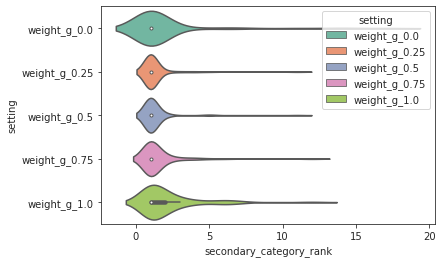

In [67]:
# plt.figure(figsize=(15,8))
sns.violinplot(data=w_rank_df[w_rank_df.scat_rank != -1].rename(columns={"scat_rank": "secondary_category_rank"}), x="secondary_category_rank", y="setting", hue="setting", palette="Set2", dodge=False)

<AxesSubplot:xlabel='primary_category_rank', ylabel='setting'>

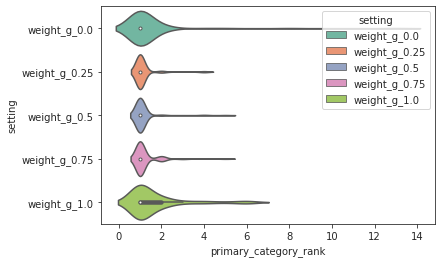

In [70]:
# plt.figure(figsize=(15,8))
sns.violinplot(data=w_rank_df.rename(columns={"pcat_rank": "primary_category_rank"}), x="primary_category_rank", y="setting", hue="setting", palette="Set2", dodge=False)

In [71]:
for s in settings_w:
    print(s['setting_name'])
    print(w_rank_df[w_rank_df.setting == s['setting_name']].describe())

weight_g_0.0
        pcat_rank   scat_rank
count  105.000000  105.000000
mean     1.361905    1.457143
std      1.441979    2.875723
min      1.000000   -1.000000
25%      1.000000    1.000000
50%      1.000000    1.000000
75%      1.000000    1.000000
max     13.000000   17.000000
weight_g_0.25
        pcat_rank   scat_rank
count  105.000000  105.000000
mean     1.133333    1.114286
std      0.538278    1.303208
min      1.000000   -1.000000
25%      1.000000    1.000000
50%      1.000000    1.000000
75%      1.000000    1.000000
max      4.000000   11.000000
weight_g_0.5
        pcat_rank   scat_rank
count  105.000000  105.000000
mean     1.123810    1.161905
std      0.583346    1.301802
min      1.000000   -1.000000
25%      1.000000    1.000000
50%      1.000000    1.000000
75%      1.000000    1.000000
max      5.000000   11.000000
weight_g_0.75
        pcat_rank   scat_rank
count  105.000000  105.000000
mean     1.200000    1.123810
std      0.561591    1.621343
min      1.00000

In [49]:
categories = importlib.reload(categories)
from categories import *
from tqdm import tqdm

queue = ['data/textfield_features_OSS.json', 'data/textfield_features_samsung.json']

labels = json.load(open('data/GT/labels.json'))

ranking_result = []

settings = [
    {
        'setting_name': 'keyword_baseline',
        'baseline_dist_func': True,
        'prune': False,
        'prune_count': 0,
        'weight_g_p': 0,
        'weight_g_s': 0,
        'extend_local_ctx': False
    },
    {
        'setting_name': 'fasttext_baseline',
        'baseline_dist_func': False,
        'prune': False,
        'prune_count': 0,
        'weight_g_p': 0,
        'weight_g_s': 0,
        'extend_local_ctx': False
    },
    {
        'setting_name': 'prune_3',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0,
        'weight_g_s': 0,
        'extend_local_ctx': False
    },
    {
        'setting_name': 'ext_local_ctx',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0,
        'weight_g_s': 0,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.3_0.5',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.3,
        'weight_g_s': 0.5,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.3_0.3',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.3,
        'weight_g_s': 0.3,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.3_0.0',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.3,
        'weight_g_s': 0.0,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.5_0.3',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.5,
        'weight_g_s': 0.3,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.5_0.0',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.5,
        'weight_g_s': 0.0,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.5_0.5',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.5,
        'weight_g_s': 0.5,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.0_0.3',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.0,
        'weight_g_s': 0.3,
        'extend_local_ctx': True
    },
    {
        'setting_name': 'weight_g_0.0_0.5',
        'baseline_dist_func': False,
        'prune': True,
        'prune_count': 3,
        'weight_g_p': 0.0,
        'weight_g_s': 0.5,
        'extend_local_ctx': True
    }
]

for tf_feature_file in queue:
    tf_features = json.load(open(tf_feature_file))
    
    for tf_path, tf in tqdm(tf_features.items()):
        if tf_path not in labels:
            continue # skip not yet labelled data
        
        GT_pcats, GT_categories = get_GT_categories(labels[tf_path])
        
        for s in settings:

            primary_rank_result = rank_categories_by_features(tf['textfield_tokens'], tf['local_context'], tf['global_context'], category_BoW=primary_category_BoW, prune=s['prune'], prune_count=s['prune_count'], weight_g=s['weight_g_p'], extend_local_ctx=s['extend_local_ctx'], baseline=s['baseline_dist_func'])
            pcat = primary_rank_result[0][0]
            # TODO: try top2/top3 ranked primary categories too? 

            secondary_rank_result = []
            scat = None

            if pcat in secondary_category_BoW:
                secondary_rank_result = rank_categories_by_features(tf['textfield_tokens'], tf['local_context'], tf['global_context'], category_BoW=secondary_category_BoW[pcat], prune=s['prune'], prune_count=s['prune_count'], weight_g=s['weight_g_s'], extend_local_ctx=s['extend_local_ctx'], baseline=s['baseline_dist_func'])
                scat = secondary_rank_result[0][0]
                if pcat in GT_pcats:
                    scat_rank = get_cat_rank(GT_categories[pcat], secondary_rank_result)

                else:
                    scat_rank = -1
            elif pcat in GT_pcats:
                scat_rank = 1
            else:
                scat_rank = -1


            ranking_result.append({
                'source': tf_feature_file,
                'setting': s['setting_name'],
                'app_name': tf['app_name'],
                'tf_path': tf_path,
                'pred_top1': [pcat, scat],
                'GT_categories': GT_categories,
                'pcat_rank': get_cat_rank(GT_pcats, primary_rank_result),
                'scat_rank': scat_rank,
                'primary_categories_ranked': primary_rank_result,
                'secondary_categories_ranked': secondary_rank_result
            })
        
agg_rank_df = pd.DataFrame(ranking_result)

100%|██████████| 33/33 [01:26<00:00,  2.63s/it]


In [57]:
for s in settings:
    print(f'[{s["setting_name"]}]')
    rank_df = agg_rank_df[agg_rank_df.setting == s['setting_name']]
    print(len(rank_df[rank_df.pcat_rank == 1])/len(rank_df), len(rank_df[rank_df.scat_rank == 1])/len(rank_df))
    print(rank_df.pcat_rank.mean())
    print(rank_df[rank_df.scat_rank != -1].scat_rank.mean())
    print(len(rank_df[rank_df.pcat_rank == 1]), len(rank_df[rank_df.scat_rank == 1]), end='\n\n')


[keyword_baseline]
0.6761904761904762 0.4857142857142857
2.6095238095238096
3.7183098591549295
71 51

[fasttext_baseline]
0.7333333333333333 0.6190476190476191
1.6571428571428573
1.87012987012987
77 65

[prune_3]
0.8285714285714286 0.7142857142857143
1.5333333333333334
1.8160919540229885
87 75

[ext_local_ctx]
0.8476190476190476 0.7238095238095238
1.361904761904762
1.898876404494382
89 76

[weight_g_0.3_0.5]
0.9428571428571428 0.8476190476190476
1.1142857142857143
1.2525252525252526
99 89

[weight_g_0.3_0.3]
0.9428571428571428 0.8380952380952381
1.1142857142857143
1.2828282828282829
99 88

[weight_g_0.3_0.0]
0.9428571428571428 0.819047619047619
1.1142857142857143
1.8080808080808082
99 86

[weight_g_0.5_0.3]
0.9428571428571428 0.8285714285714286
1.1238095238095238
1.303030303030303
99 87

[weight_g_0.5_0.0]
0.9428571428571428 0.8095238095238095
1.1238095238095238
1.8181818181818181
99 85

[weight_g_0.5_0.5]
0.9428571428571428 0.8380952380952381
1.1238095238095238
1.292929292929293
99 88

In [51]:
agg_rank_df

,source,setting,app_name,tf_path,pred_top1,GT_categories,pcat_rank,scat_rank,primary_categories_ranked,secondary_categories_ranked
0,data/textfield_features_OSS.json,keyword_baseline,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[auth_code, None]",{'profile': ['email']},2,-1,"[(auth_code, 0.8333333333333334), (profile, 0....",[]
1,data/textfield_features_OSS.json,fasttext_baseline,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[auth_code, None]",{'profile': ['email']},2,-1,"[(auth_code, 0.47988347212473553), (profile, 0...",[]
2,data/textfield_features_OSS.json,prune_3,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.37276495123902953), (auth_code, 0...","[(email, 0.2147888019680977), (password, 0.645..."
3,data/textfield_features_OSS.json,ext_local_ctx,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.37276495123902953), (auth_code, 0...","[(email, 0.2147888019680977), (password, 0.645..."
4,data/textfield_features_OSS.json,weight_g_0.3_0.5,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.3116215987751881), (auth_code, 0....","[(email, 0.20243436718980473), (phone, 0.50456..."
...,...,...,...,...,...,...,...,...,...,...
1255,data/textfield_features_samsung.json,weight_g_0.5_0.3,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.3831457917888959), (auth_code...",[]
1256,data/textfield_features_samsung.json,weight_g_0.5_0.0,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.3831457917888959), (auth_code...",[]
1257,data/textfield_features_samsung.json,weight_g_0.5_0.5,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.3831457917888959), (auth_code...",[]
1258,data/textfield_features_samsung.json,weight_g_0.0_0.3,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[description, None]",{'description': []},1,1,"[(description, 0.36422119041283924), (messenge...",[]


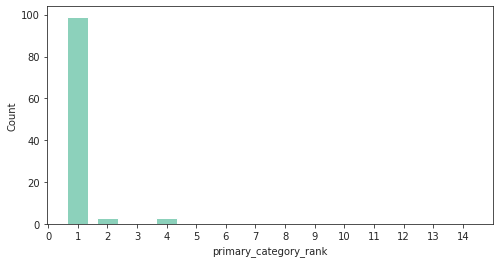

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,4))
sns.set_style("ticks")

ax = sns.histplot(data=rank_df.rename(columns={"pcat_rank": "primary_category_rank"}), x="primary_category_rank", discrete=True, binrange=(1, len(primary_category_BoW)), color=sns.color_palette("Set2")[0], shrink=0.7)
ax.set_xticks(range(0, len(primary_category_BoW)+1, 1))


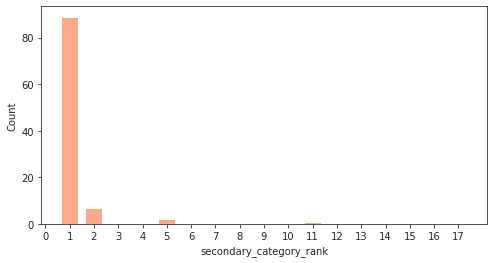

In [26]:
plt.figure(figsize=(8,4))
sns.set_style("ticks")
bins = max([len(secondary_category_BoW[pcat]) for pcat in secondary_category_BoW])
ax = sns.histplot(data=rank_df[rank_df.scat_rank != -1].rename(columns={"scat_rank": "secondary_category_rank"}), x="secondary_category_rank", discrete=True, binrange=(1, bins), color=sns.color_palette("Set2")[1], shrink=0.7)
ax.set_xticks(range(0, bins+1, 1))


In [22]:
rank_df[rank_df.scat_rank != -1].scat_rank.describe()

count    99.000000
mean      1.252525
std       1.163593
min       1.000000
25%       1.000000
50%       1.000000
75%       1.000000
max      11.000000
Name: scat_rank, dtype: float64

In [23]:
df = rank_df[rank_df.scat_rank != -1]
print(len(df[df.scat_rank == 1]))
print(len(df))
len(df[df.scat_rank == 1])/len(df)

89
99


0.898989898989899

In [24]:
print(len(rank_df[rank_df.pcat_rank == 1]))
print(len(rank_df))
len(rank_df[rank_df.pcat_rank == 1])/len(rank_df)

99
105


0.9428571428571428

In [74]:
rank_df[(rank_df.scat_rank == 1)]

,source,setting,app_name,tf_path,pred_top1,GT_categories,pcat_rank,scat_rank,primary_categories_ranked,secondary_categories_ranked
11,data/textfield_features_OSS.json,weight_g_0.0_0.5,Instagram,data/OSS/textfield_contexts/Instagram_1/email_...,"[profile, email]",{'profile': ['email']},1,1,"[(profile, 0.37276495123902953), (auth_code, 0...","[(email, 0.20243436718980473), (phone, 0.50456..."
23,data/textfield_features_OSS.json,weight_g_0.0_0.5,HERE_WeGo_Maps_Navigation_v4.4.200,data/OSS/textfield_contexts/HERE_WeGo_Maps_Nav...,"[search, location]",{'search': ['location']},1,1,"[(search, 0.6540699079632759), (location, 0.71...","[(location, 0.39269808307290077), (tv_show, 0...."
35,data/textfield_features_OSS.json,weight_g_0.0_0.5,me.hackerchick.catima,data/OSS/textfield_contexts/me.hackerchick.cat...,"[search, storage]",{'search': ['storage']},1,1,"[(search, 0.4863956930736701), (auth_code, 0.6...","[(storage, 0.6230052461226782), (web, 0.660388..."
47,data/textfield_features_OSS.json,weight_g_0.0_0.5,me.hackerchick.catima,data/OSS/textfield_contexts/me.hackerchick.cat...,"[code, card_id]",{'code': ['card_id']},1,1,"[(code, 0.23469410339991253), (profile, 0.6648...","[(card_id, 0.1142329846819242), (coupon_code, ..."
71,data/textfield_features_OSS.json,weight_g_0.0_0.5,Brave_Private_Web_Browser_v1.39.115,data/OSS/textfield_contexts/Brave_Private_Web_...,"[search, web]",{'search': ['web']},1,1,"[(search, 0.65195155578355), (auth_code, 0.731...","[(web, 0.5445189382880926), (location, 0.63358..."
...,...,...,...,...,...,...,...,...,...,...
1199,data/textfield_features_samsung.json,weight_g_0.0_0.5,Clock,data/samsung_internal/Clock/state_2022-11-01_1...,"[datetime, minute]",{'datetime': ['minute']},1,1,"[(datetime, 0.6234048331777255), (numerical, 0...","[(minute, 0.45477667450904846), (hour, 0.57855..."
1211,data/textfield_features_samsung.json,weight_g_0.0_0.5,Clock,data/samsung_internal/Clock/state_2022-11-01_1...,"[datetime, second]",{'datetime': ['second']},1,1,"[(datetime, 0.6410585244496663), (profile, 0.7...","[(second, 0.5160047913280627), (time, 0.673015..."
1235,data/textfield_features_samsung.json,weight_g_0.0_0.5,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[label, None]",{'label': []},1,1,"[(label, 0.1837732195854187), (tag, 0.60183712...",[]
1247,data/textfield_features_samsung.json,weight_g_0.0_0.5,Calendar,data/samsung_internal/Calendar/state_2022-11-0...,"[location, location]",{'location': ['location']},1,1,"[(location, 0.20663351317246756), (datetime, 0...","[(location, 0.11815407623847325), (city, 0.632..."


In [86]:
rank_df = agg_rank_df[agg_rank_df.setting=='weight_g_0.3_0.5']

In [87]:
print(len(rank_df[(rank_df.pcat_rank > 1) | (rank_df.scat_rank > 1)]))
rank_df[(rank_df.pcat_rank > 1) | (rank_df.scat_rank > 1)]
# maybe adding the app name to the global context would be helpful?

16


,source,setting,app_name,tf_path,pred_top1,GT_categories,pcat_rank,scat_rank,primary_categories_ranked,secondary_categories_ranked
52,data/textfield_features_OSS.json,weight_g_0.3_0.5,me.hackerchick.catima,data/OSS/textfield_contexts/me.hackerchick.cat...,"[code, card_id]",{'label': []},4,-1,"[(code, 0.5019051998853683), (profile, 0.57909...","[(card_id, 0.38993662036955357), (coupon_code,..."
100,data/textfield_features_OSS.json,weight_g_0.3_0.5,org.billthefarmer.currency,data/OSS/textfield_contexts/org.billthefarmer....,"[datetime, date]",{'numerical': ['ratio']},4,-1,"[(datetime, 0.6476847601433594), (description,...","[(date, 0.5402269102632999), (time, 0.69208676..."
124,data/textfield_features_OSS.json,weight_g_0.3_0.5,Ratios,data/OSS/textfield_contexts/Ratios_1/157233290,"[numerical, ratio]",{'numerical': ['amount']},1,2,"[(numerical, 0.2483247622847557), (datetime, 0...","[(ratio, 0.3857275918126106), (amount, 0.49343..."
268,data/textfield_features_OSS.json,weight_g_0.3_0.5,de.kromke.andreas.opus1musicplayer,data/OSS/textfield_contexts/de.kromke.andreas....,"[search, app]","{'search': ['music', 'storage']}",1,2,"[(search, 0.4552300407240788), (description, 0...","[(app, 0.5372341523567835), (storage, 0.606888..."
460,data/textfield_features_OSS.json,weight_g_0.3_0.5,Plex_Stream_Movies_TV,data/OSS/textfield_contexts/Plex_Stream_Movies...,"[search, music]",{'search': ['movie']},1,11,"[(search, 0.34821588223179184), (music, 0.4757...","[(music, 0.6064514455695946), (location, 0.611..."
496,data/textfield_features_OSS.json,weight_g_0.3_0.5,AOL_News_Mail_Video_v6.47.2,data/OSS/textfield_contexts/AOL_News_Mail_Vide...,"[search, app]","{'search': ['news', 'video']}",1,5,"[(search, 0.4527788343528906), (description, 0...","[(app, 0.5884032882750034), (storage, 0.610802..."
748,data/textfield_features_OSS.json,weight_g_0.3_0.5,Issuu_magazines_news_books_v5.67.0,data/OSS/textfield_contexts/Issuu_magazines_ne...,"[search, storage]","{'search': ['megazine', 'book', 'news']}",1,2,"[(search, 0.4438951211671034), (description, 0...","[(storage, 0.5350351060430208), (megazine, 0.6..."
928,data/textfield_features_samsung.json,weight_g_0.3_0.5,Messages,data/samsung_internal/Messages/state_2022-11-0...,"[search, web]","{'messenger': ['recipient', 'message'], 'searc...",1,2,"[(search, 0.4556399515519539), (auth_code, 0.6...","[(web, 0.7136156621078651), (storage, 0.729493..."
976,data/textfield_features_samsung.json,weight_g_0.3_0.5,Galaxy Store,data/samsung_internal/Galaxy Store/state_2022-...,"[numerical, enum]",{'profile': ['phone']},2,-1,"[(numerical, 0.35050805012385045), (profile, 0...","[(enum, 0.38534513985117275), (amount, 0.64750..."
1012,data/textfield_features_samsung.json,weight_g_0.3_0.5,Contacts,data/samsung_internal/Contacts/state_2022-11-0...,"[search, web]",{'search': ['storage']},1,2,"[(search, 0.4556399515519539), (auth_code, 0.6...","[(web, 0.7136156621078651), (storage, 0.729493..."


## Debugging

##5


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Instagram
tf_path                        data/OSS/textfield_contexts/Instagram_1/email_...
pred_top1                                                       [profile, email]
GT_categories                                             {'profile': ['email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.3116215987751881), (auth_code, 0....
secondary_categories_ranked    [(email, 0.20243436718980473), (phone, 0.50456...
Name: 4, dtype: object

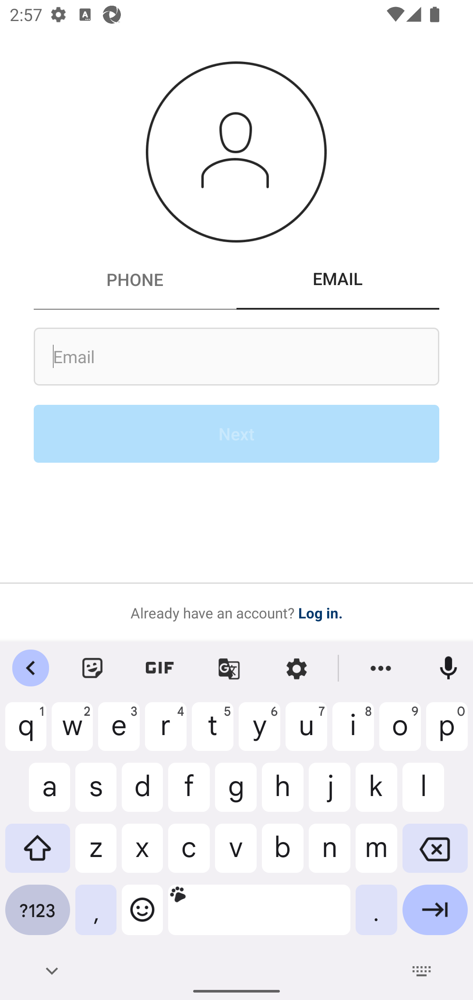

{'textfield_path': 'data/OSS/textfield_contexts/Instagram_1/email_field', 'textfield_info': {'index': '0', 'package': 'com.instagram.android', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Email', 'resource-id': 'email_field', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[77,747][1003,879]', 'displayed': 'true'}, 'app_name': 'Instagram', 'screenshot_path': 'data/OSS/snapshots/Instagram/178737488/screenshot.png', 'textfield_tokens': ['field', 'email'], 'local_context': ['switcher', 'container', 'next', 'right', 'tab', 'button'], 'global_context': ['container', 'selection', 'field', 'icon', 'selected', 'margin', 'left', 'reg', 'account', 'have', 'action', 'footer', 'divider', 'parent', 'landing', 'log', 'tab', 'content', 'background', 'horizontal', 'an', 'inline', 'view', 'button', 'error', 'right', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                      HERE_WeGo_Maps_Navigation_v4.4.200
tf_path                        data/OSS/textfield_contexts/HERE_WeGo_Maps_Nav...
pred_top1                                                     [search, location]
GT_categories                                           {'search': ['location']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.555601317435503), (datetime, 0.680...
secondary_categories_ranked    [(location, 0.39269808307290077), (tv_show, 0....
Name: 16, dtype: object

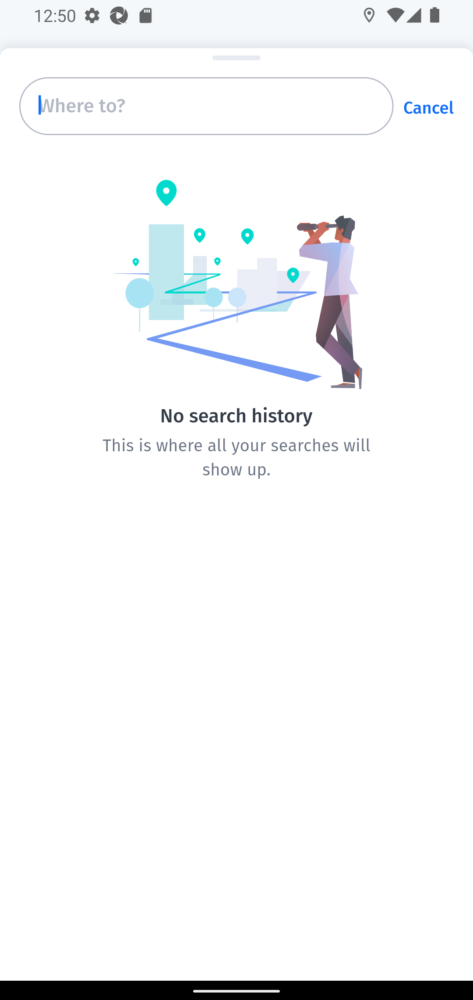

{'textfield_path': 'data/OSS/textfield_contexts/HERE_WeGo_Maps_Navigation_v4.4.200_5/-1630317872', 'textfield_info': {'index': '0', 'package': 'com.here.app.maps', 'class': 'android.widget.EditText', 'text': 'Where to?', 'resource-id': '', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'false', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,176][899,308]', 'displayed': 'true'}, 'app_name': 'HERE_WeGo_Maps_Navigation_v4.4.200', 'screenshot_path': 'data/OSS/snapshots/HERE_WeGo_Maps_Navigation_v4.4.200/156770900/screenshot.png', 'textfield_tokens': ['to', 'where'], 'local_context': ['to', 'where', 'cancel'], 'global_context': ['bar', 'cancel', 'history', 'is', 'this', 'all', 'no', 'navigation', 'content', 'your', 'searches', 'will', 'where', 'up', 'show', 'search', 'background', 'to']}

##29


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                   me.hackerchick.catima
tf_path                        data/OSS/textfield_contexts/me.hackerchick.cat...
pred_top1                                                      [search, storage]
GT_categories                                            {'search': ['storage']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.45762317764262356), (description, ...
secondary_categories_ranked    [(storage, 0.6230052461226782), (web, 0.660388...
Name: 28, dtype: object

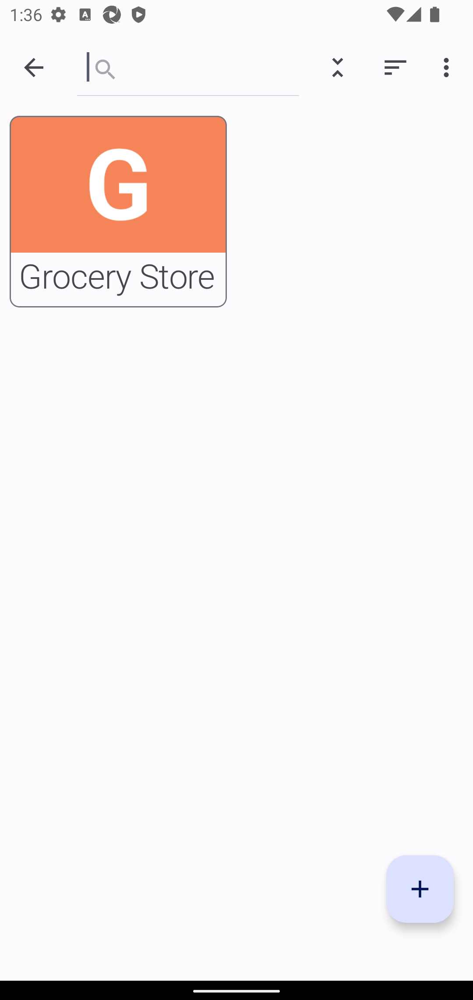

{'textfield_path': 'data/OSS/textfield_contexts/me.hackerchick.catima_1/search_src_text', 'textfield_info': {'index': '0', 'package': 'me.hackerchick.catima', 'class': 'android.widget.AutoCompleteTextView', 'text': '   ', 'resource-id': 'search_src_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[176,103][683,202]', 'displayed': 'true'}, 'app_name': 'me.hackerchick.catima', 'screenshot_path': 'data/OSS/snapshots/me.hackerchick.catima/-1021118874/screenshot.png', 'textfield_tokens': ['search', 'src', 'text'], 'local_context': ['search', 'plate', 'search', 'src', 'text'], 'global_context': ['row', 'icon', 'grocery', 'sort', 'action', 'more', 'add', 'content', 'src', 'background', 'collapse', 'hide', 'search', 'list', 'toolbar', 'store', 'frame', 'options', 'fab', 'layout', 'text', 'edit', 'bar', 'details', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                   me.hackerchick.catima
tf_path                        data/OSS/textfield_contexts/me.hackerchick.cat...
pred_top1                                                        [code, card_id]
GT_categories                                              {'code': ['card_id']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(code, 0.16428587237993877), (auth_code, 0.60...
secondary_categories_ranked    [(card_id, 0.1142329846819242), (coupon_code, ...
Name: 40, dtype: object

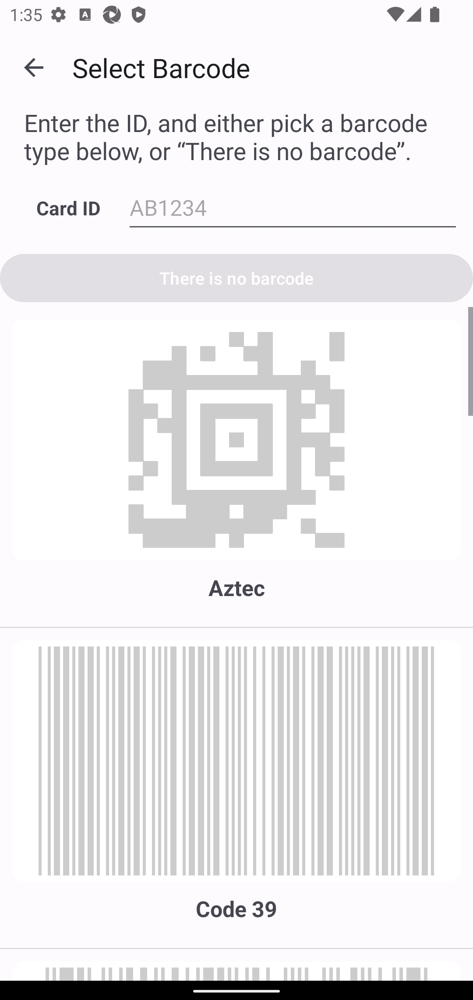

{'textfield_path': 'data/OSS/textfield_contexts/me.hackerchick.catima_1/cardId', 'textfield_info': {'index': '1', 'package': 'me.hackerchick.catima', 'class': 'android.widget.EditText', 'text': 'AB1234', 'resource-id': 'cardId', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[285,408][1052,540]', 'displayed': 'true'}, 'app_name': 'me.hackerchick.catima', 'screenshot_path': 'data/OSS/snapshots/me.hackerchick.catima/530085251/screenshot.png', 'textfield_tokens': ['ab', 'id', '1234', 'card'], 'local_context': ['layout', 'id', 'barcode', 'card', 'id', 'ab', 'id', '1234', 'card'], 'global_context': ['is', 'name', 'pick', 'explanation', 'code', 'below', 'action', 'a', 'card', 'navigate', 'either', 'content', 'background', '1234', 'or', 'enter', '39', '93', 'aztec', 'toolbar', 'and', 'select', 'there', 'layout', 'imag

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                     Brave_Private_Web_Browser_v1.39.115
tf_path                        data/OSS/textfield_contexts/Brave_Private_Web_...
pred_top1                                                          [search, web]
GT_categories                                                {'search': ['web']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.5625915736580889), (description, 0...
secondary_categories_ranked    [(web, 0.5445189382880926), (location, 0.63358...
Name: 64, dtype: object

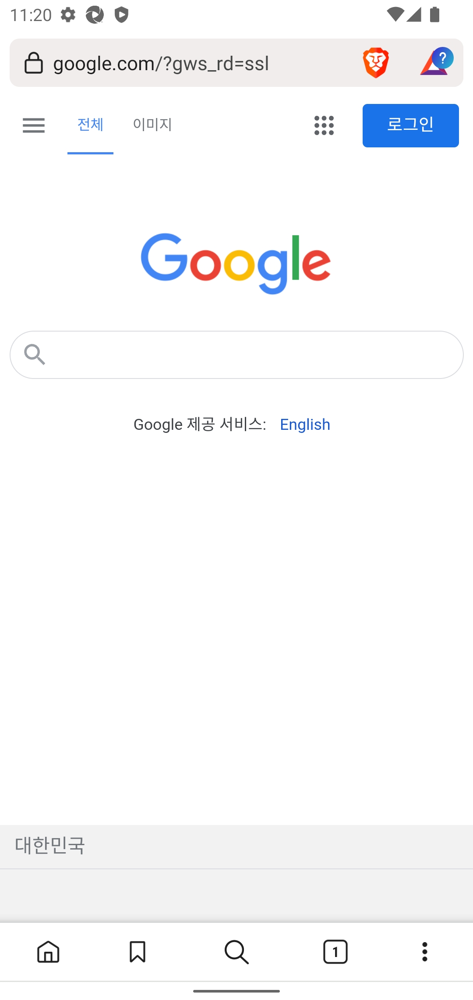

{'textfield_path': 'data/OSS/textfield_contexts/Brave_Private_Web_Browser_v1.39.115_1/-1629784746', 'textfield_info': {'index': '0', 'package': 'com.brave.browser', 'class': 'android.widget.EditText', 'text': '', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'false', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[110,772][1067,847]', 'displayed': 'true'}, 'app_name': 'Brave_Private_Web_Browser_v1.39.115', 'screenshot_path': 'data/OSS/snapshots/Brave_Private_Web_Browser_v1.39.115/-29924823/screenshot.png', 'textfield_tokens': [], 'local_context': ['tsf', 'google'], 'global_context': ['rdssl', 'enable', 'switch', 'additional', 'secure', 'open', 'background', 'wrapper', 'search', 'toolbar', 'button', 'swml', 'br', 'gb', 'tap', 'bottom', 'gbwa', 'boarding', 'main', 'browsing', 's', 'zd', 'footer', 'control', 'location', 'more', 'tab', 'content', 'controls', 'manage',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                     Brave_Private_Web_Browser_v1.39.115
tf_path                        data/OSS/textfield_contexts/Brave_Private_Web_...
pred_top1                                                          [search, web]
GT_categories                                                {'search': ['web']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.3985832467675208), (profile, 0.558...
secondary_categories_ranked    [(web, 0.0), (location, 0.5493147497375805), (...
Name: 76, dtype: object

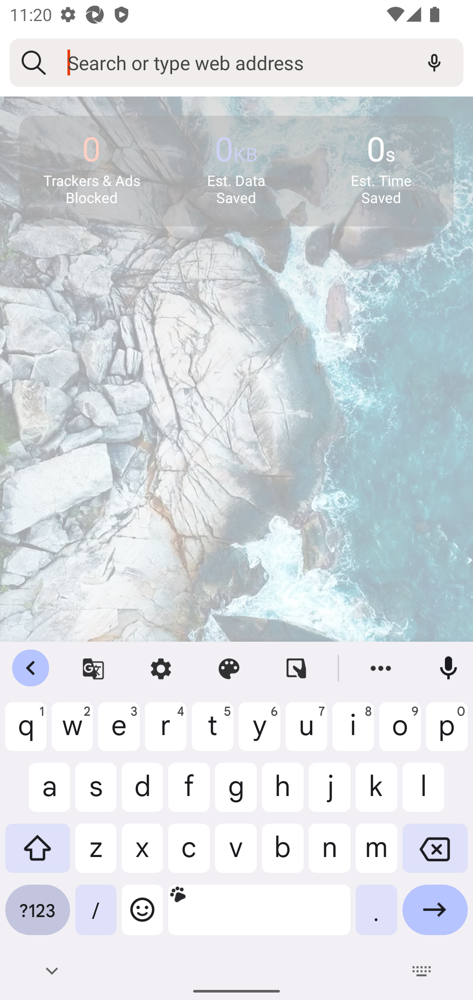

{'textfield_path': 'data/OSS/textfield_contexts/Brave_Private_Web_Browser_v1.39.115_1/url_bar', 'textfield_info': {'index': '1', 'package': 'com.brave.browser', 'class': 'android.widget.EditText', 'text': 'Search or type web address', 'resource-id': 'url_bar', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[154,74][926,212]', 'displayed': 'true'}, 'app_name': 'Brave_Private_Web_Browser_v1.39.115', 'screenshot_path': 'data/OSS/snapshots/Brave_Private_Web_Browser_v1.39.115/-2130272688/screenshot.png', 'textfield_tokens': ['bar', 'web', 'url', 'address', 'search', 'or', 'type'], 'local_context': ['location', 'bar', 'location', 'bar', 'status', 'url', 'container', 'action', 'bar', 'web', 'url', 'address', 'search', 'or', 'type'], 'global_context': ['ads', 'trackers', 'switch', 'value', 'time', 'open', 'mic', 'backgr

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                            Opera_Mini_fast_web_browser_v63.0.2254.61942
tf_path                        data/OSS/textfield_contexts/Opera_Mini_fast_we...
pred_top1                                                          [search, web]
GT_categories                                                {'search': ['web']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.4164590229590734), (profile, 0.547...
secondary_categories_ranked    [(web, 0.1825300057729085), (news, 0.478883701...
Name: 88, dtype: object

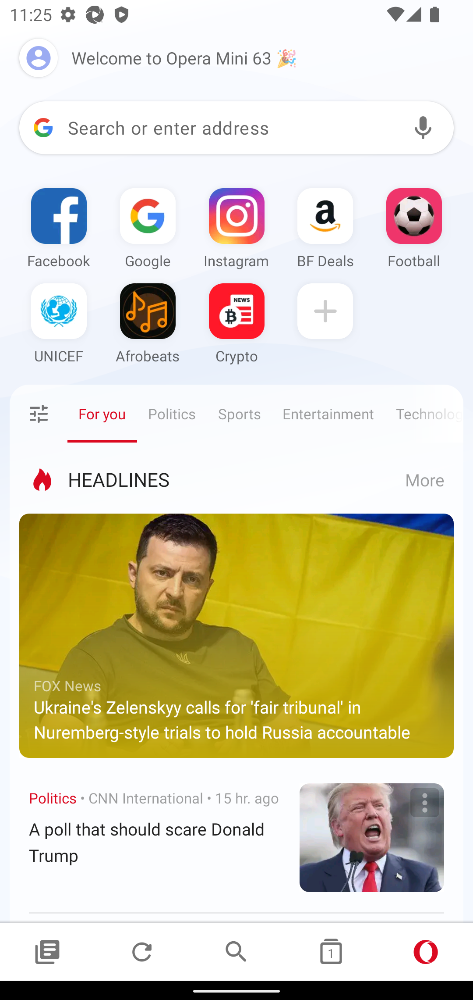

{'textfield_path': 'data/OSS/textfield_contexts/Opera_Mini_fast_web_browser_v63.0.2254.61942_1/url_field', 'textfield_info': {'index': '2', 'package': 'com.opera.mini.native', 'class': 'android.widget.EditText', 'text': 'Search or enter address', 'resource-id': 'url_field', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'false', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[140,231][918,352]', 'displayed': 'true'}, 'app_name': 'Opera_Mini_fast_web_browser_v63.0.2254.61942', 'screenshot_path': 'data/OSS/snapshots/Opera_Mini_fast_web_browser_v63.0.2254.61942/70984969/screenshot.png', 'textfield_tokens': ['enter', 'field', 'url', 'address', 'search', 'or'], 'local_context': ['bar', 'omni', 'bar', 'left', 'omni', 'container', 'enter', 'field', 'url', 'address', 'search', 'or', 'search', 'button', 'page', 'menu'], 'global_context': ['engines', 'swipe', 'header', 'dial

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                  Ratios
tf_path                          data/OSS/textfield_contexts/Ratios_1/2113677831
pred_top1                                                     [numerical, ratio]
GT_categories                                           {'numerical': ['ratio']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(numerical, 0.2483247622847557), (datetime, 0...
secondary_categories_ranked    [(ratio, 0.3857275918126106), (amount, 0.49343...
Name: 112, dtype: object

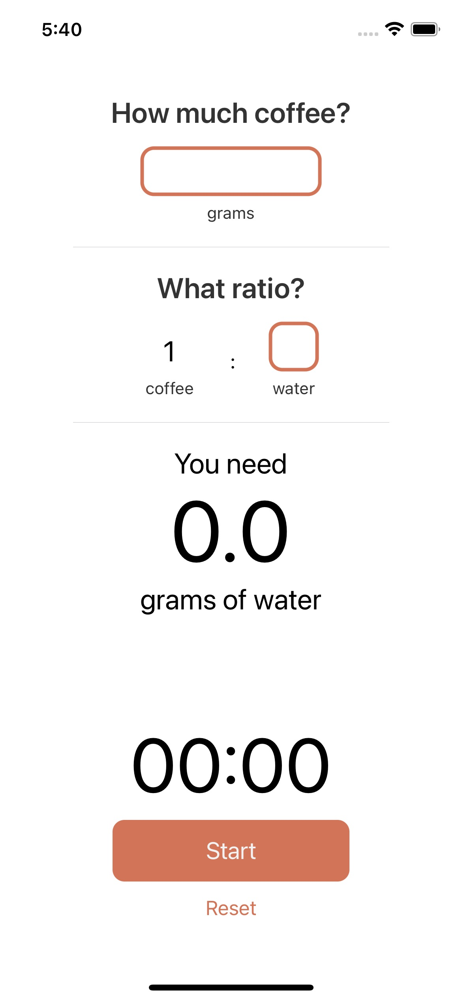

{'textfield_path': 'data/OSS/textfield_contexts/Ratios_1/2113677831', 'textfield_info': {'type': 'XCUIElementTypeTextField', 'label': '', 'enabled': 'true', 'visible': 'true', 'accessible': 'true', 'x': '228', 'y': '277', 'width': '40', 'height': '31', 'index': '7'}, 'app_name': 'Ratios', 'screenshot_path': 'data/OSS/snapshots/Ratios/-1499365203/screenshot.png', 'textfield_tokens': [], 'local_context': ['much', 'coffee', 'how', 'grams', 'what', 'ratio', '1', 'coffee', 'water', 'need', 'you', '0', 'of', 'water', 'grams', '00', 'start', 'reset'], 'global_context': ['00', '0', 'of', 'start', '1', 'grams', 'water', 'much', 'ratios', 'coffee', 'what', 'need', 'you', 'how', 'reset', 'ratio']}

##137


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Instagram
tf_path                        data/OSS/textfield_contexts/Instagram_3/full_name
pred_top1                                                        [profile, name]
GT_categories                                  {'profile': ['name', 'username']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.5234472591429948), (label, 0.5261...
secondary_categories_ranked    [(name, 0.3702681337793668), (password, 0.4603...
Name: 136, dtype: object

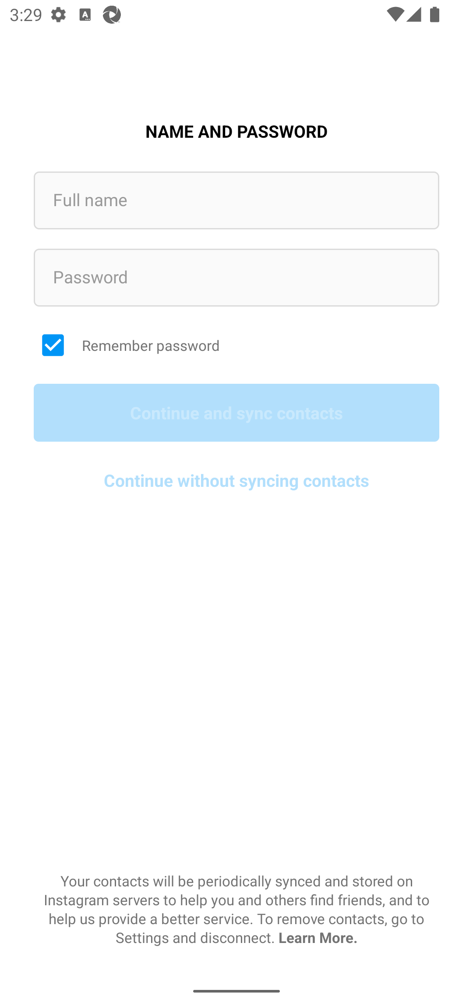

{'textfield_path': 'data/OSS/textfield_contexts/Instagram_3/full_name', 'textfield_info': {'index': '0', 'package': 'com.instagram.android', 'class': 'android.widget.EditText', 'text': 'Full name', 'resource-id': 'full_name', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[77,391][1003,523]', 'displayed': 'true'}, 'app_name': 'Instagram', 'screenshot_path': 'data/OSS/snapshots/Instagram/973891293/screenshot.png', 'textfield_tokens': ['name', 'full'], 'local_context': ['name', 'full', 'inline', 'error', 'name', 'full'], 'global_context': ['container', 'field', 'input', 'name', 'explanation', 'margin', 'on', 'action', 'periodically', 'a', 'go', 'parent', 'landing', 'remember', 'stored', 'continue', 'full', 'others', 'without', 'more', 'one', 'disconnect', 'content', 'background', 'will', 'search', 'synced', 'help

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Instagram
tf_path                        data/OSS/textfield_contexts/Instagram_3/phone_...
pred_top1                                                       [profile, phone]
GT_categories                                             {'profile': ['phone']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.3185626409947872), (auth_code, 0....
secondary_categories_ranked    [(phone, 0.36393347258369124), (email, 0.41215...
Name: 148, dtype: object

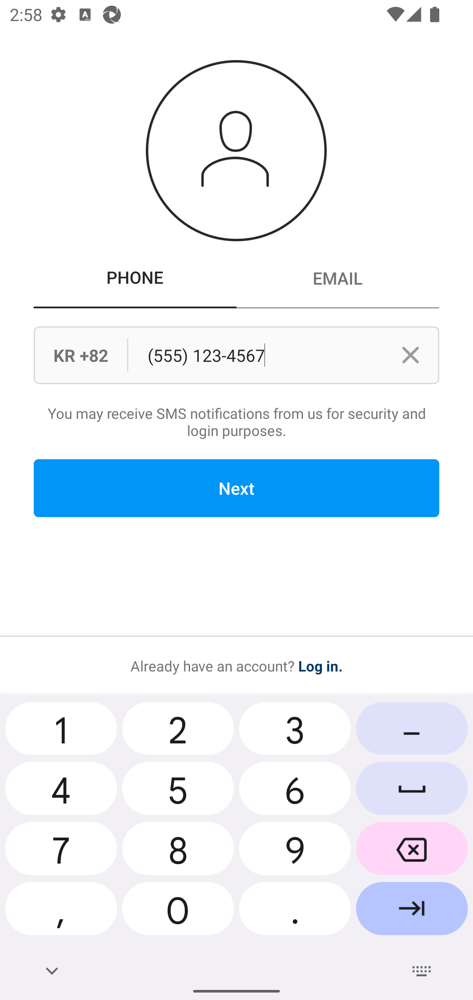

{'textfield_path': 'data/OSS/textfield_contexts/Instagram_3/phone_field', 'textfield_info': {'index': '2', 'package': 'com.instagram.android', 'class': 'android.widget.AutoCompleteTextView', 'text': '(555) 123-4567', 'resource-id': 'phone_field', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[293,1070][915,1202]', 'displayed': 'true'}, 'app_name': 'Instagram', 'screenshot_path': 'data/OSS/snapshots/Instagram/-628214519/screenshot.png', 'textfield_tokens': ['field', '555', 'phone', '123', '4567'], 'local_context': [], 'global_context': ['container', 'selection', 'field', 'korea', 'security', '555', 'icon', 'code', '4567', 'selected', 'margin', 'left', 'reg', 'account', 'have', 'purposes', 'action', 'footer', 'divider', 'picker', 'parent', 'landing', 'clear', 'for', 'log', 'tab', 'content', 'background', 'horizon

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Instagram
tf_path                         data/OSS/textfield_contexts/Instagram_3/password
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.19083366046349204), (auth_code, 0...
secondary_categories_ranked    [(password, 0.1102337787548701), (username, 0....
Name: 160, dtype: object

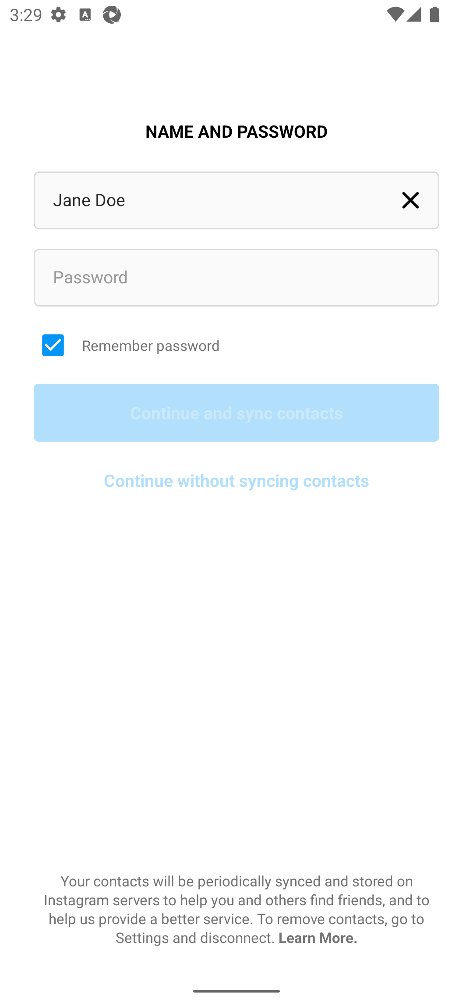

{'textfield_path': 'data/OSS/textfield_contexts/Instagram_3/password', 'textfield_info': {'index': '0', 'package': 'com.instagram.android', 'class': 'android.widget.EditText', 'text': 'Password', 'resource-id': 'password', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[77,567][1003,699]', 'displayed': 'true'}, 'app_name': 'Instagram', 'screenshot_path': 'data/OSS/snapshots/Instagram/215427127/screenshot.png', 'textfield_tokens': ['password'], 'local_context': ['container', 'page', 'input', 'one', 'name', 'full', 'inline', 'error', 'inline', 'password', 'error', 'checkbox', 'password', 'remember', 'next', 'button', 'ci', 'continue', 'without', 'contacts', 'syncing'], 'global_context': ['container', 'field', 'input', 'name', 'explanation', 'margin', 'on', 'action', 'periodically', 'a', 'go', 'parent', 'landing', 

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Instagram
tf_path                        data/OSS/textfield_contexts/Instagram_3/confir...
pred_top1                                                      [auth_code, None]
GT_categories                                                  {'auth_code': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(auth_code, 0.15484397361675897), (code, 0.45...
secondary_categories_ranked                                                   []
Name: 172, dtype: object

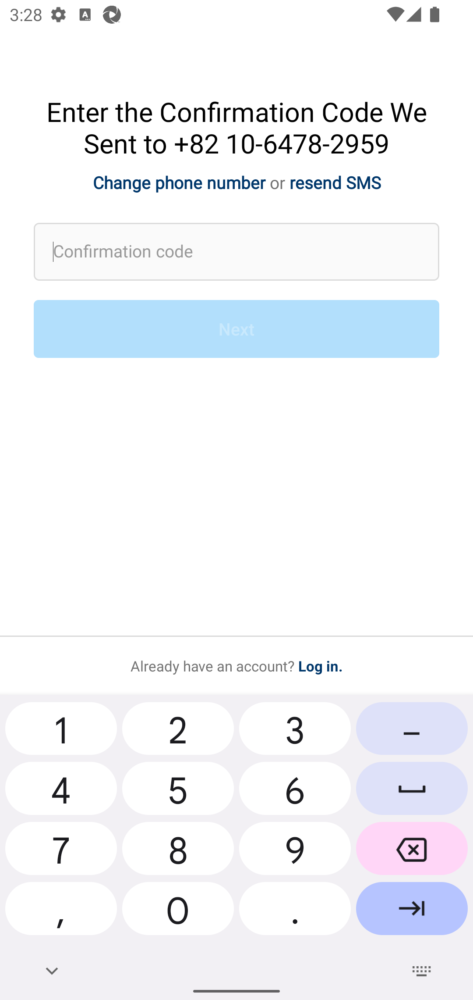

{'textfield_path': 'data/OSS/textfield_contexts/Instagram_3/confirmation_field', 'textfield_info': {'index': '0', 'package': 'com.instagram.android', 'class': 'android.widget.EditText', 'text': 'Confirmation code', 'resource-id': 'confirmation_field', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[77,508][1003,640]', 'displayed': 'true'}, 'app_name': 'Instagram', 'screenshot_path': 'data/OSS/snapshots/Instagram/1954100112/screenshot.png', 'textfield_tokens': ['code', 'confirmation', 'field'], 'local_context': ['container', 'confirmation', 'field', 'inline', 'confirmation', 'field', 'error', 'next', 'button'], 'global_context': ['container', 'field', '6478', '10', 'code', 'margin', 'reg', 'account', 'have', '2959', 'action', 'footer', 'divider', 'parent', 'landing', 'log', 'content', 'resend', 'background', 'ent

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Instagram
tf_path                           data/OSS/textfield_contexts/Instagram_3/search
pred_top1                                                     [profile, country]
GT_categories                  {'search': ['country', 'country_code'], 'profi...
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.3638448943694433), (location, 0.4...
secondary_categories_ranked    [(country, 0.323786439994971), (name, 0.391636...
Name: 184, dtype: object

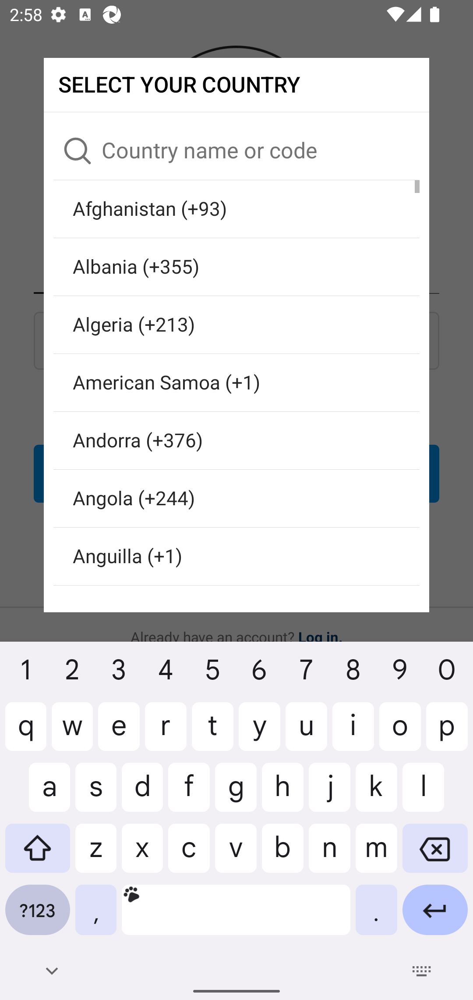

{'textfield_path': 'data/OSS/textfield_contexts/Instagram_3/search', 'textfield_info': {'index': '0', 'package': 'com.instagram.android', 'class': 'android.widget.EditText', 'text': 'Country name or code', 'resource-id': 'search', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[122,665][925,797]', 'displayed': 'true'}, 'app_name': 'Instagram', 'screenshot_path': 'data/OSS/snapshots/Instagram/1381772643/screenshot.png', 'textfield_tokens': ['name', 'code', 'search', 'or', 'country'], 'local_context': [], 'global_context': ['algeria', 'container', 'row', 'anguilla', 'name', '355', 'end', '1', 'code', 'panel', 'andorra', 'divider', 'parent', 'custom', 'american', 'albania', 'content', 'search', 'afghanistan', 'or', 'simple', 'samoa', 'angola', 'list', '93', 'antigua', 'view', 'select', '244', 'text', 'country', 't

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                               Petal_Maps–GPS_Navigation_v2.5.0.303(002)
tf_path                        data/OSS/textfield_contexts/Petal_Maps–GPS_Nav...
pred_top1                                                     [search, location]
GT_categories                                           {'search': ['location']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.38900688091913854), (description, ...
secondary_categories_ranked    [(location, 0.3065021658937136), (video, 0.479...
Name: 196, dtype: object

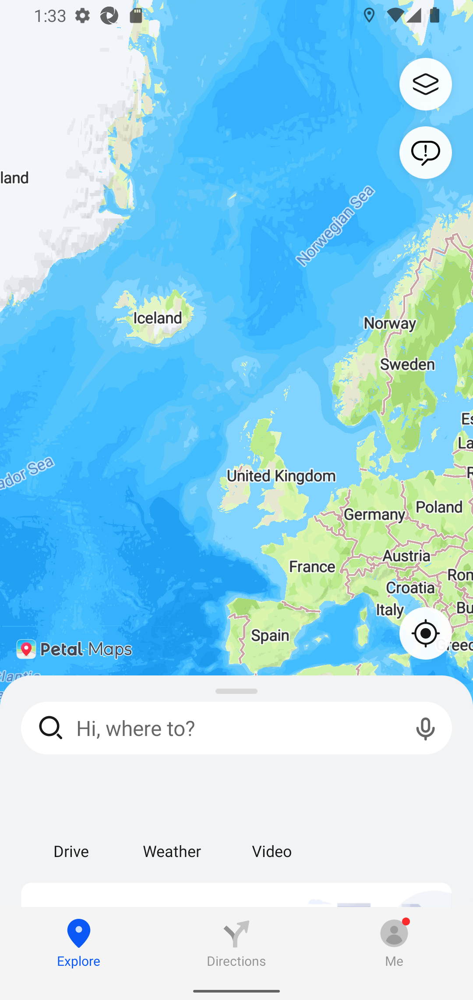

{'textfield_path': 'data/OSS/textfield_contexts/Petal_Maps–GPS_Navigation_v2.5.0.303(002)_1/search_src_text', 'textfield_info': {'index': '1', 'package': 'com.huawei.maps.app', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Hi, where to?', 'resource-id': 'search_src_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[174,1600][912,1720]', 'displayed': 'true'}, 'app_name': 'Petal_Maps–GPS_Navigation_v2.5.0.303(002)', 'screenshot_path': 'data/OSS/snapshots/Petal_Maps–GPS_Navigation_v2.5.0.303(002)/-1677063389/screenshot.png', 'textfield_tokens': ['hi', 'src', 'where', 'search', 'text', 'to'], 'local_context': ['search', 'plate', 'search', 'src', 'hwsearchview', 'icon', 'hi', 'src', 'where', 'search', 'text', 'to'], 'global_context': ['container', 'iv', 'end', 'icon', 'llt', 'maps', 'common', 'drive',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                   Firefox_Fast_Private_Browser_v101.1.1
tf_path                        data/OSS/textfield_contexts/Firefox_Fast_Priva...
pred_top1                                                          [search, web]
GT_categories                                                {'search': ['web']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.42050420319040616), (profile, 0.56...
secondary_categories_ranked    [(web, 0.15714422861735025), (storage, 0.64458...
Name: 208, dtype: object

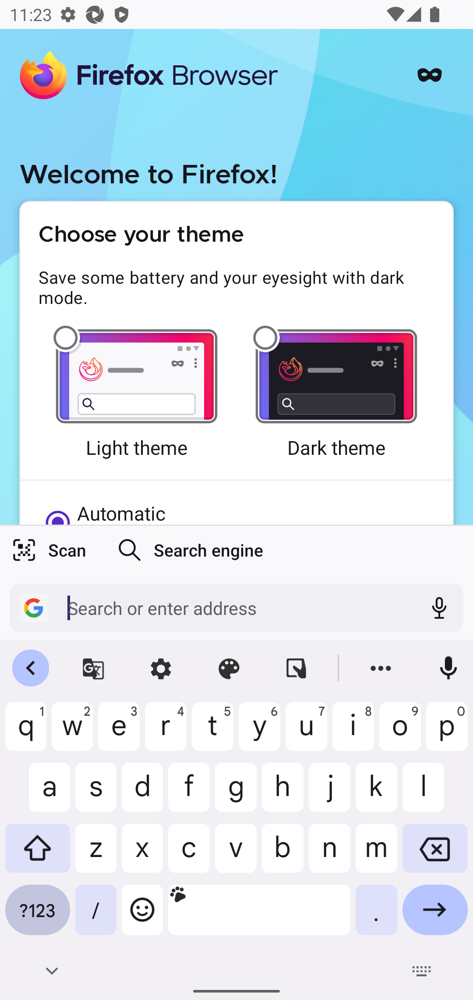

{'textfield_path': 'data/OSS/textfield_contexts/Firefox_Fast_Private_Browser_v101.1.1_1/mozac_browser_toolbar_edit_url_view', 'textfield_info': {'index': '2', 'package': 'org.mozilla.firefox', 'class': 'android.widget.EditText', 'text': 'Search or enter address', 'resource-id': 'mozac_browser_toolbar_edit_url_view', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[154,1331][948,1441]', 'displayed': 'true'}, 'app_name': 'Firefox_Fast_Private_Browser_v101.1.1', 'screenshot_path': 'data/OSS/snapshots/Firefox_Fast_Private_Browser_v101.1.1/1018090987/screenshot.png', 'textfield_tokens': ['enter', 'view', 'toolbar', 'edit', 'url', 'mozac', 'address', 'search', 'browser', 'or'], 'local_context': ['browser', 'mozac', 'container', 'toolbar', 'browser', 'mozac', 'background', 'toolbar', 'toolbar', 'icon', 'mozac', 'google'

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               BookStore
tf_path                           data/OSS/textfield_contexts/BookStore_1/Search
pred_top1                                                         [search, book]
GT_categories                                               {'search': ['book']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.2787898493309816), (description, 0...
secondary_categories_ranked    [(book, 0.5218050008018812), (storage, 0.67434...
Name: 220, dtype: object

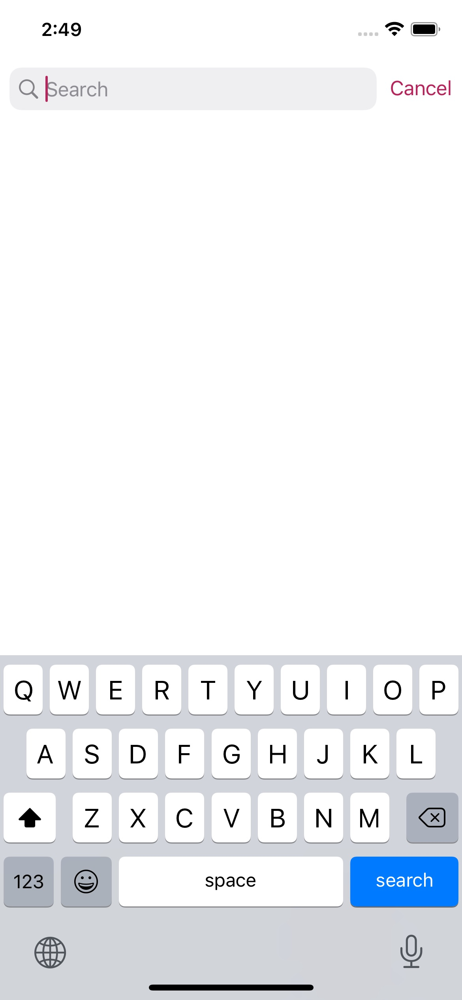

{'textfield_path': 'data/OSS/textfield_contexts/BookStore_1/Search', 'textfield_info': {'type': 'XCUIElementTypeSearchField', 'name': 'Search', 'label': 'Search', 'enabled': 'true', 'visible': 'true', 'accessible': 'true', 'x': '8', 'y': '57', 'width': '310', 'height': '36', 'index': '0'}, 'app_name': 'BookStore', 'screenshot_path': 'data/OSS/snapshots/BookStore/516307039/screenshot.png', 'textfield_tokens': ['search'], 'local_context': ['search', 'cancel'], 'global_context': ['s', 'dictate', 'w', 'd', 'f', 'j', 'c', 'i', 'b', 'e', 'empty', 'z', 'q', 'y', 'shift', 'numbers', 'u', 'dictation', 'a', 'delete', 'new', 'k', 'more', 'book', 'tab', 'emoji', 'search', 'l', 'list', 'g', 'view', 'store', 'o', 'v', 'p', 'keyboard', 'next', 'bar', 'cancel', 'r', 'x', 'm', 'h', 'space', 'table', 'n', 't']}

##233


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                WhatsApp
tf_path                        data/OSS/textfield_contexts/WhatsApp_1/registr...
pred_top1                                                [profile, country_code]
GT_categories                                      {'profile': ['country_code']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.5620858751237392), (auth_code, 0....
secondary_categories_ranked    [(country_code, 0.4430426054944595), (phone, 0...
Name: 232, dtype: object

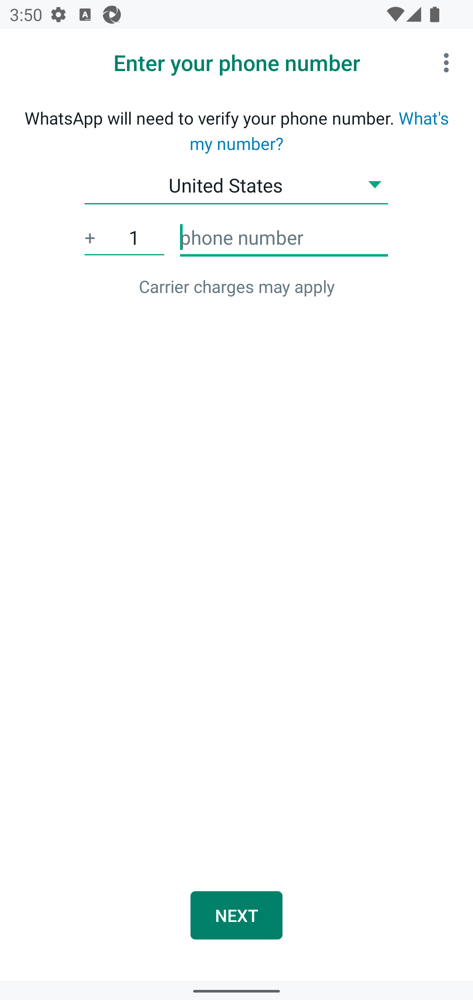

{'textfield_path': 'data/OSS/textfield_contexts/WhatsApp_1/registration_cc', 'textfield_info': {'index': '0', 'package': 'com.whatsapp', 'class': 'android.widget.EditText', 'text': '1', 'resource-id': 'registration_cc', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[182,480][386,604]', 'displayed': 'true'}, 'app_name': 'WhatsApp', 'screenshot_path': 'data/OSS/snapshots/WhatsApp/-960371024/screenshot.png', 'textfield_tokens': ['cc', '1', 'registration'], 'local_context': ['fields', 'registration', 'phone', 'number', 'registration'], 'global_context': ['registration', '1', 'register', 'charge', 'selected', 'action', 'app', 'submit', 'description', 'more', 'content', 'states', 'background', 'will', 'cc', 'enter', 'view', 'carrier', 'toolbar', 'united', 'options', 'phone', 'warning', 'charges', 'next', 'country', 

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                WhatsApp
tf_path                        data/OSS/textfield_contexts/WhatsApp_1/verify_...
pred_top1                                                      [auth_code, None]
GT_categories                                                  {'auth_code': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(auth_code, 0.0), (code, 0.43661815424760186)...
secondary_categories_ranked                                                   []
Name: 244, dtype: object

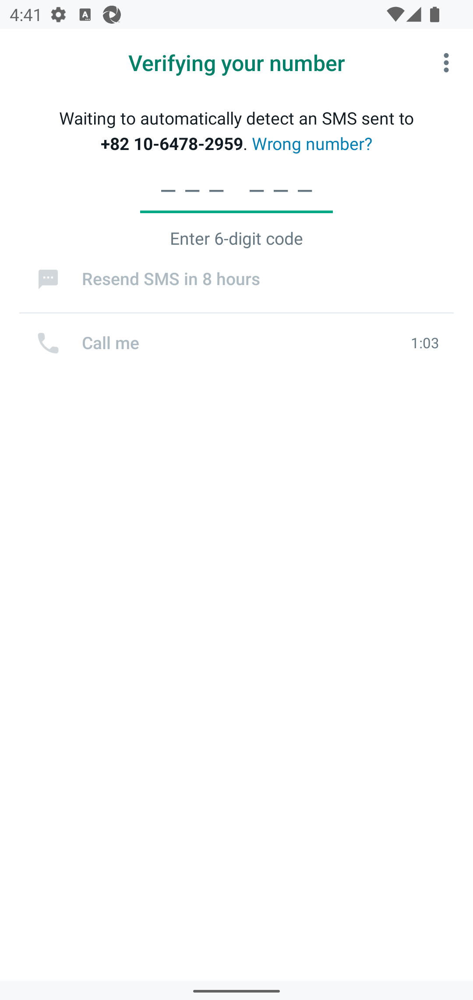

{'textfield_path': 'data/OSS/textfield_contexts/WhatsApp_1/verify_sms_code_input', 'textfield_info': {'index': '0', 'package': 'com.whatsapp', 'class': 'android.widget.EditText', 'text': '–––\xa0–––', 'resource-id': 'verify_sms_code_input', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[320,392][760,474]', 'displayed': 'true'}, 'app_name': 'WhatsApp', 'screenshot_path': 'data/OSS/snapshots/WhatsApp/-1824722619/screenshot.png', 'textfield_tokens': ['code', 'sms', 'input', 'verify'], 'local_context': ['code', 'input', 'code', 'sms', 'input', 'verify', 'bar', 'input', 'blocked', 'progress', '100', 'code', '0'], 'global_context': ['wrong', 'input', '6478', '10', '6', 'code', 'verifying', '2959', 'action', 'divider', 'group', 'automatically', 'description', 'more', 'content', 'resend', 'background', 'enter', 'an', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                WhatsApp
tf_path                        data/OSS/textfield_contexts/WhatsApp_1/registr...
pred_top1                                                       [profile, phone]
GT_categories                                             {'profile': ['phone']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.35259995112816495), (numerical, 0...
secondary_categories_ranked    [(phone, 0.358405914157629), (country, 0.58046...
Name: 256, dtype: object

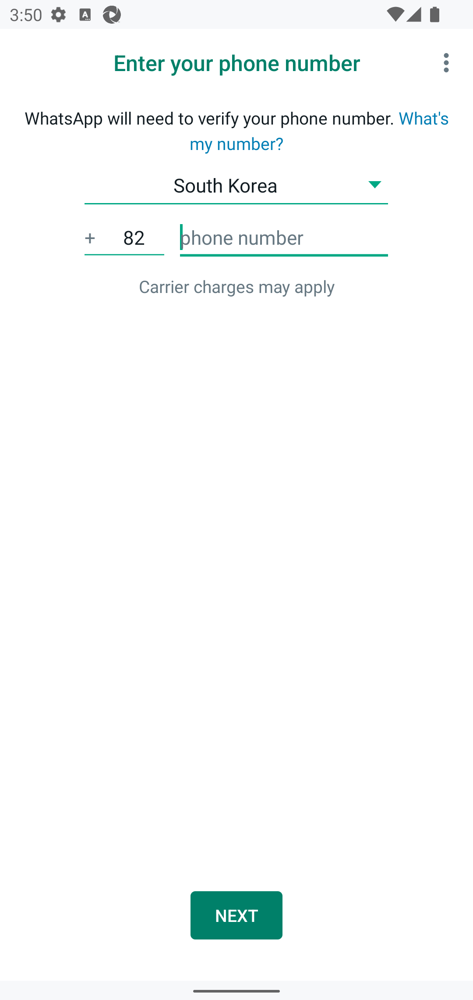

{'textfield_path': 'data/OSS/textfield_contexts/WhatsApp_1/registration_phone', 'textfield_info': {'index': '1', 'package': 'com.whatsapp', 'class': 'android.widget.EditText', 'text': 'phone number', 'resource-id': 'registration_phone', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[400,480][897,604]', 'displayed': 'true'}, 'app_name': 'WhatsApp', 'screenshot_path': 'data/OSS/snapshots/WhatsApp/1298032692/screenshot.png', 'textfield_tokens': ['phone', 'number', 'registration'], 'local_context': ['fields', 'registration', 'phone', 'number', 'registration'], 'global_context': ['registration', 'korea', 'register', 'charge', 'selected', 'action', 'app', 'submit', 'description', 'more', 'content', 'background', 'will', 'cc', 'enter', 'view', 'carrier', 'toolbar', 'south', 'options', 'phone', 'warning', 'charges', 'n

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      co.appreactor.news
tf_path                        data/OSS/textfield_contexts/co.appreactor.news...
pred_top1                                                    [profile, username]
GT_categories                                          {'profile': ['username']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.14969951063394546), (auth_code, 0...
secondary_categories_ranked    [(username, 0.19328247010707855), (password, 0...
Name: 280, dtype: object

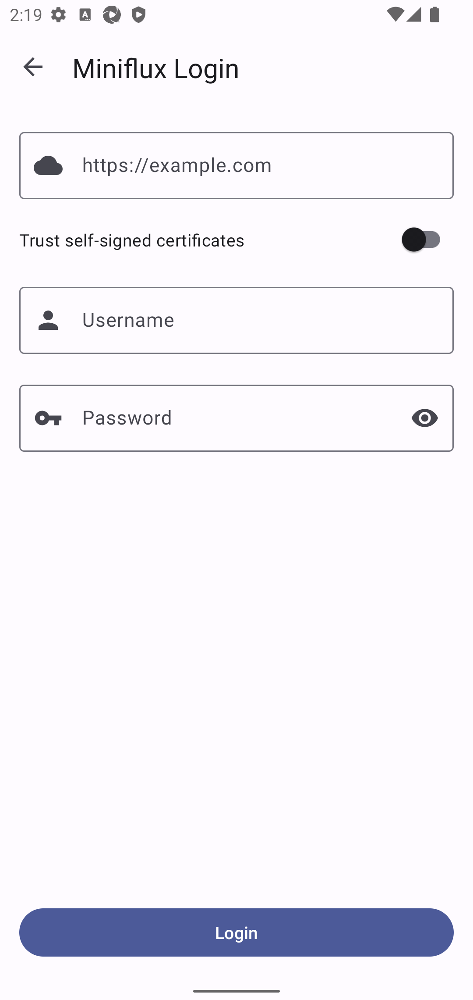

{'textfield_path': 'data/OSS/textfield_contexts/co.appreactor.news_1/username', 'textfield_info': {'index': '0', 'package': 'co.appreactor.news', 'class': 'android.widget.EditText', 'text': 'Username', 'resource-id': 'username', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,654][1036,807]', 'displayed': 'true'}, 'app_name': 'co.appreactor.news', 'screenshot_path': 'data/OSS/snapshots/co.appreactor.news/-1160844204/screenshot.png', 'textfield_tokens': ['username'], 'local_context': ['layout', 'username'], 'global_context': ['input', 'end', 'icon', 'i', 'username', 'self', 'action', 'app', 'drawer', 'fragment', 'flux', 'open', 'content', 'background', 'certificates', 'show', 'toolbar', 'server', 'start', 'signed', 'url', 'layout', 'password', 'text', 'host', 'login', 'bar', 'trust', 'nav', 'https', 'root', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      co.appreactor.news
tf_path                        data/OSS/textfield_contexts/co.appreactor.news...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.14977331558863322), (auth_code, 0...
secondary_categories_ranked    [(password, 0.05680548151334127), (username, 0...
Name: 292, dtype: object

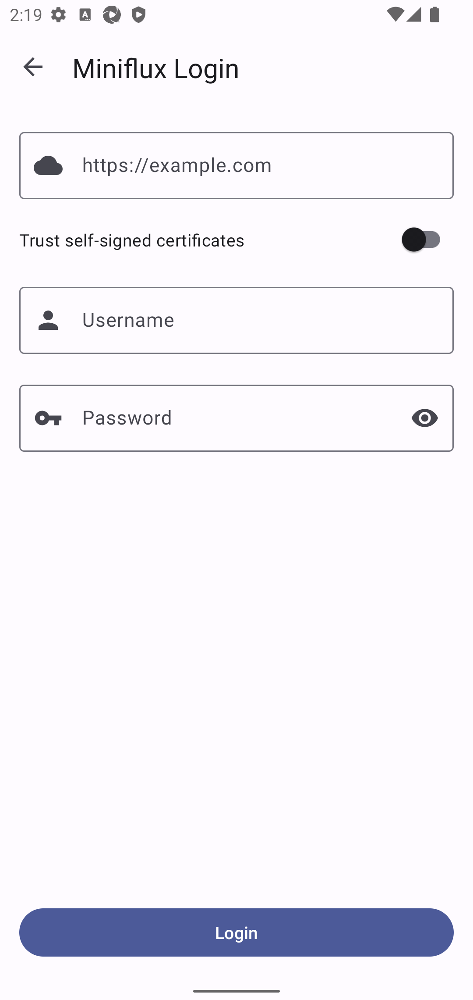

{'textfield_path': 'data/OSS/textfield_contexts/co.appreactor.news_1/password', 'textfield_info': {'index': '0', 'package': 'co.appreactor.news', 'class': 'android.widget.EditText', 'text': 'Password', 'resource-id': 'password', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,877][1036,1030]', 'displayed': 'true'}, 'app_name': 'co.appreactor.news', 'screenshot_path': 'data/OSS/snapshots/co.appreactor.news/-1160844204/screenshot.png', 'textfield_tokens': ['password'], 'local_context': ['layout', 'password'], 'global_context': ['input', 'end', 'icon', 'i', 'username', 'self', 'action', 'app', 'drawer', 'fragment', 'flux', 'open', 'content', 'background', 'certificates', 'show', 'toolbar', 'server', 'start', 'signed', 'url', 'layout', 'password', 'text', 'host', 'login', 'bar', 'trust', 'nav', 'https', 'root', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      co.appreactor.news
tf_path                        data/OSS/textfield_contexts/co.appreactor.news...
pred_top1                                                         [profile, url]
GT_categories                                               {'profile': ['url']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.5502259351313114), (auth_code, 0....
secondary_categories_ranked    [(url, 0.16170352324843407), (password, 0.4278...
Name: 304, dtype: object

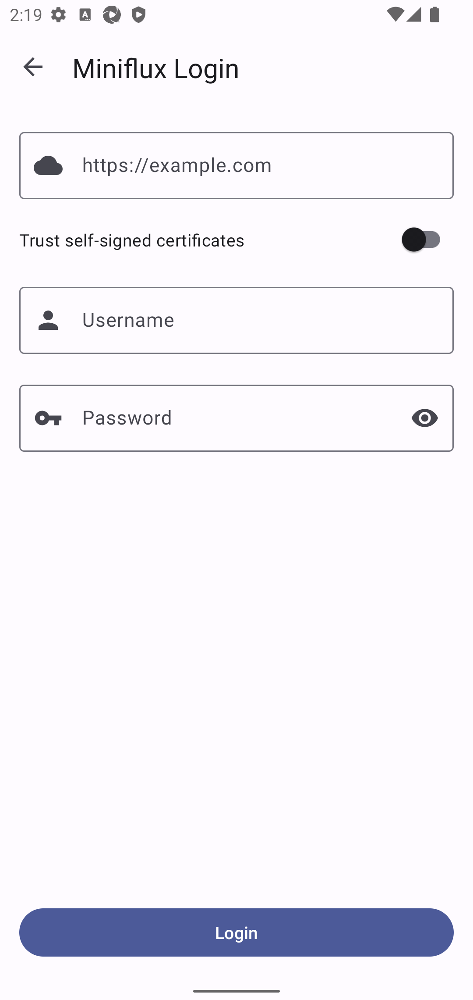

{'textfield_path': 'data/OSS/textfield_contexts/co.appreactor.news_1/serverUrl', 'textfield_info': {'index': '0', 'package': 'co.appreactor.news', 'class': 'android.widget.EditText', 'text': 'https', 'resource-id': 'serverUrl', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,301][1036,454]', 'displayed': 'true'}, 'app_name': 'co.appreactor.news', 'screenshot_path': 'data/OSS/snapshots/co.appreactor.news/-1160844204/screenshot.png', 'textfield_tokens': ['server', 'https', 'url'], 'local_context': ['server', 'layout', 'url'], 'global_context': ['input', 'end', 'icon', 'i', 'username', 'self', 'action', 'app', 'drawer', 'fragment', 'flux', 'open', 'content', 'background', 'certificates', 'show', 'toolbar', 'server', 'start', 'signed', 'url', 'layout', 'password', 'text', 'host', 'login', 'bar', 'trust', 'nav', 

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                    com.invoiceninja.app
tf_path                        data/OSS/textfield_contexts/com.invoiceninja.a...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.13837434897820153), (auth_code, 0...
secondary_categories_ranked    [(password, 0.07301108787457149), (email, 0.38...
Name: 316, dtype: object

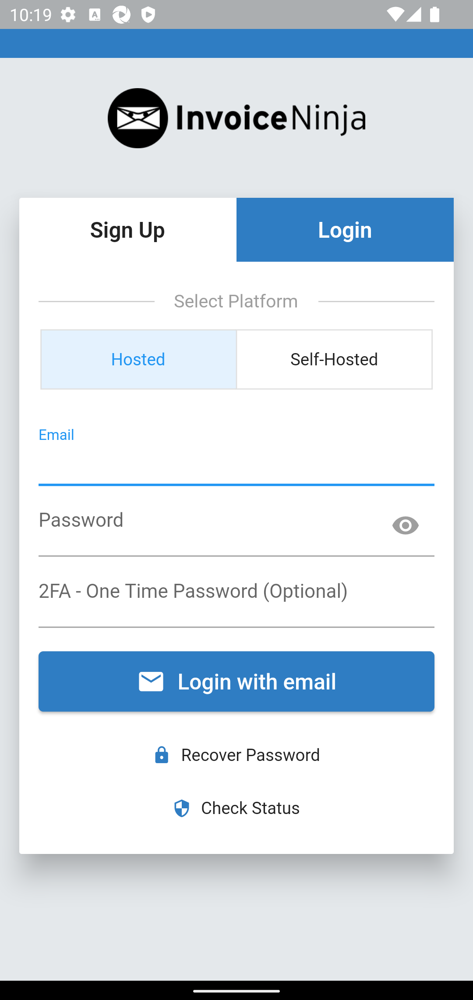

{'textfield_path': 'data/OSS/textfield_contexts/com.invoiceninja.app_1/1271870479', 'textfield_info': {'index': '5', 'package': 'com.invoiceninja.app', 'class': 'android.widget.EditText', 'text': 'Password', 'resource-id': '', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'false', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[88,1106][992,1268]', 'displayed': 'true'}, 'app_name': 'com.invoiceninja.app', 'screenshot_path': 'data/OSS/snapshots/com.invoiceninja.app/950430309/screenshot.png', 'textfield_tokens': ['password'], 'local_context': ['platform', 'select', 'up', 'sign', 'login', 'password', 'recover', 'check', 'status', 'hosted', 'hosted', 'self', 'login', 'email', 'with', 'email', 'password', 'optional', 'time', 'one', 'password', '2fa'], 'global_context': ['optional', 'check', 'sign', 'hosted', 'self', 'time', 'one', 'content', 'background', '2fa', 'show',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                    com.invoiceninja.app
tf_path                        data/OSS/textfield_contexts/com.invoiceninja.a...
pred_top1                                                       [profile, email]
GT_categories                                             {'profile': ['email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.16348261932531993), (auth_code, 0...
secondary_categories_ranked    [(email, 0.0962940181295077), (password, 0.358...
Name: 328, dtype: object

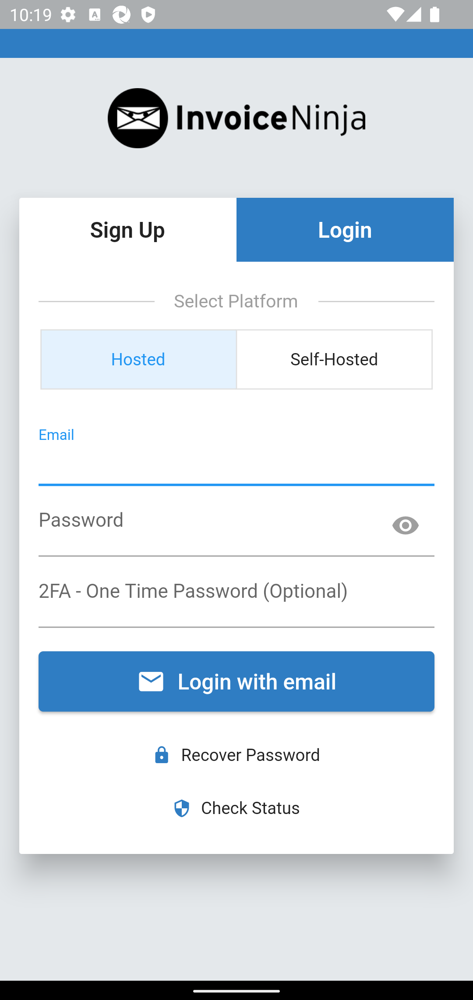

{'textfield_path': 'data/OSS/textfield_contexts/com.invoiceninja.app_1/1230535790', 'textfield_info': {'index': '4', 'package': 'com.invoiceninja.app', 'class': 'android.widget.EditText', 'text': 'Email', 'resource-id': '', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'false', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[88,943][992,1106]', 'displayed': 'true'}, 'app_name': 'com.invoiceninja.app', 'screenshot_path': 'data/OSS/snapshots/com.invoiceninja.app/950430309/screenshot.png', 'textfield_tokens': ['email'], 'local_context': ['platform', 'select', 'up', 'sign', 'login', 'password', 'recover', 'check', 'status', 'hosted', 'hosted', 'self', 'login', 'email', 'with', 'email', 'password', 'optional', 'time', 'one', 'password', '2fa'], 'global_context': ['optional', 'check', 'sign', 'hosted', 'self', 'time', 'one', 'content', 'background', '2fa', 'show', 'recov

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                       BOTIM_Video_and_Voice_Call_v2.7.9
tf_path                        data/OSS/textfield_contexts/BOTIM_Video_and_Vo...
pred_top1                                                      [search, country]
GT_categories                                            {'search': ['country']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.46850565389419596), (location, 0.6...
secondary_categories_ranked    [(country, 0.564749609058102), (country_code, ...
Name: 340, dtype: object

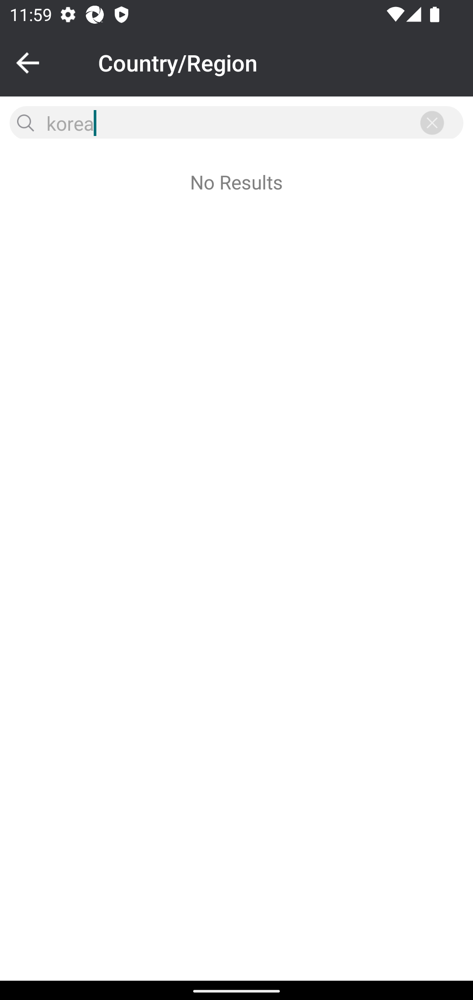

{'textfield_path': 'data/OSS/textfield_contexts/BOTIM_Video_and_Voice_Call_v2.7.9_1/search_box', 'textfield_info': {'index': '0', 'package': 'im.thebot.messenger', 'class': 'android.widget.EditText', 'text': '8', 'resource-id': 'search_box', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'false', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[22,242][916,319]', 'displayed': 'true'}, 'app_name': 'BOTIM_Video_and_Voice_Call_v2.7.9', 'screenshot_path': 'data/OSS/snapshots/BOTIM_Video_and_Voice_Call_v2.7.9/-315433776/screenshot.png', 'textfield_tokens': ['8', 'search', 'box'], 'local_context': ['search', 'view', 'box', 'search', 'box', 'korea'], 'global_context': ['korea', 'tool', 'region', 'icon', 'img', 'action', 'index', 'content', 'background', 'wrapper', 'search', 'list', 'view', 'with', 'layout', 'text', 'no', 'em', 'country', 'bar', 'whole', 'lv', 'box', 'root',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                 com.velas.mobile_wallet
tf_path                        data/OSS/textfield_contexts/com.velas.mobile_w...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.22277010778586065), (auth_code, 0...
secondary_categories_ranked    [(password, 0.12302133440971375), (username, 0...
Name: 352, dtype: object

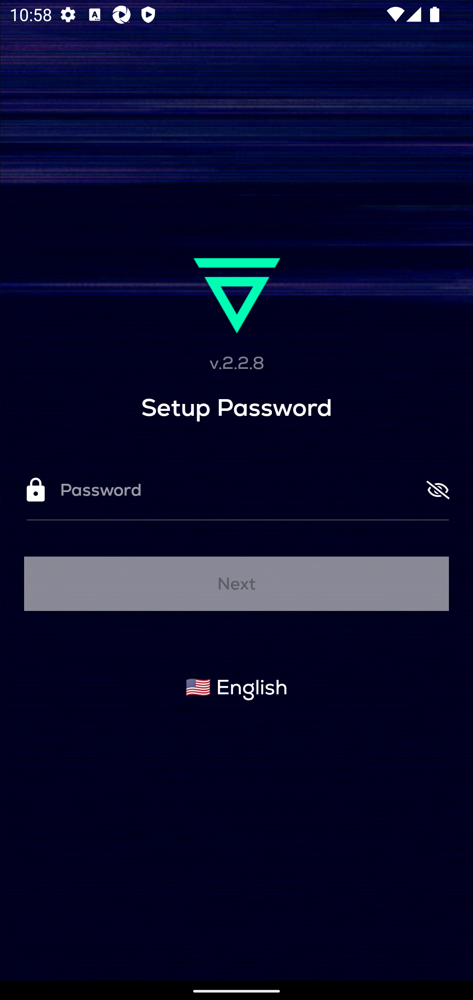

{'textfield_path': 'data/OSS/textfield_contexts/com.velas.mobile_wallet_1/735730464', 'textfield_info': {'index': '1', 'package': 'com.velas.mobile_wallet', 'class': 'android.widget.EditText', 'text': 'Password', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[124,1048][973,1185]', 'displayed': 'true'}, 'app_name': 'com.velas.mobile_wallet', 'screenshot_path': 'data/OSS/snapshots/com.velas.mobile_wallet/2009846125/screenshot.png', 'textfield_tokens': ['password'], 'local_context': ['password'], 'global_context': ['action', 'bar', '8', '2', 'setup', 'english', 'v', 'root', 'navigation', 'content', 'password', 'background', 'next']}

##365


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                  Waze_Navigation_Live_Traffic_v4.84.0.2
tf_path                        data/OSS/textfield_contexts/Waze_Navigation_Li...
pred_top1                                                     [search, location]
GT_categories                                           {'search': ['location']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.37559593568245564), (label, 0.6066...
secondary_categories_ranked    [(location, 0.3805679827928543), (web, 0.54364...
Name: 364, dtype: object

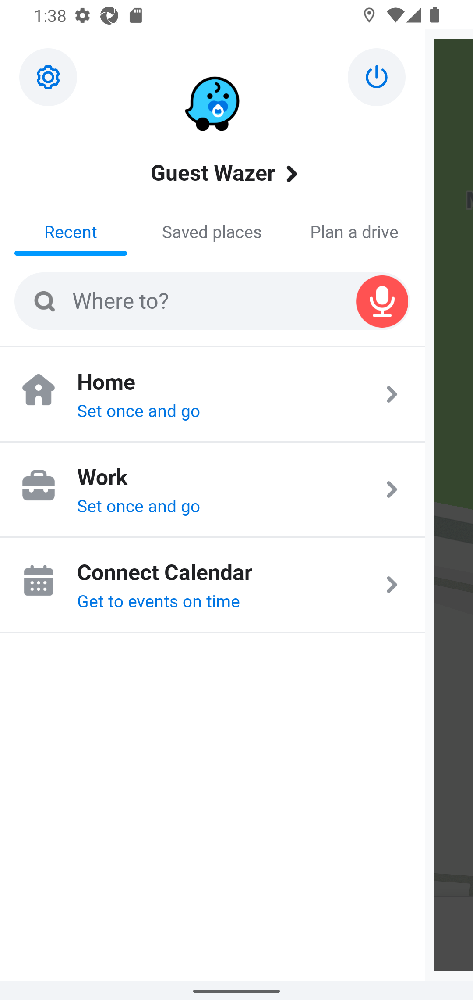

{'textfield_path': 'data/OSS/textfield_contexts/Waze_Navigation_Live_Traffic_v4.84.0.2_1/searchBox', 'textfield_info': {'index': '0', 'package': 'com.waze', 'class': 'android.widget.EditText', 'text': 'Where to?', 'content-desc': 'sideMenuSearchBox', 'resource-id': 'searchBox', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'false', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[33,621][937,753]', 'displayed': 'true'}, 'app_name': 'Waze_Navigation_Live_Traffic_v4.84.0.2', 'screenshot_path': 'data/OSS/snapshots/Waze_Navigation_Live_Traffic_v4.84.0.2/-1669109699/screenshot.png', 'textfield_tokens': ['side', 'box', 'where', 'menu', 'search', 'to'], 'local_context': ['search', 'container', 'box', 'side', 'box', 'where', 'menu', 'search', 'to', 'img', 'mag', 'glass', 'speech', 'container', 'button'], 'global_context': ['swipe', 'header', 'switch', 'a', 'speech', 'time'

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                    org.koitharu.kotatsu
tf_path                        data/OSS/textfield_contexts/org.koitharu.kotat...
pred_top1                                                        [search, manga]
GT_categories                                              {'search': ['manga']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.4025154160956541), (description, 0...
secondary_categories_ranked    [(manga, 0.27691755133370555), (app, 0.5876400...
Name: 376, dtype: object

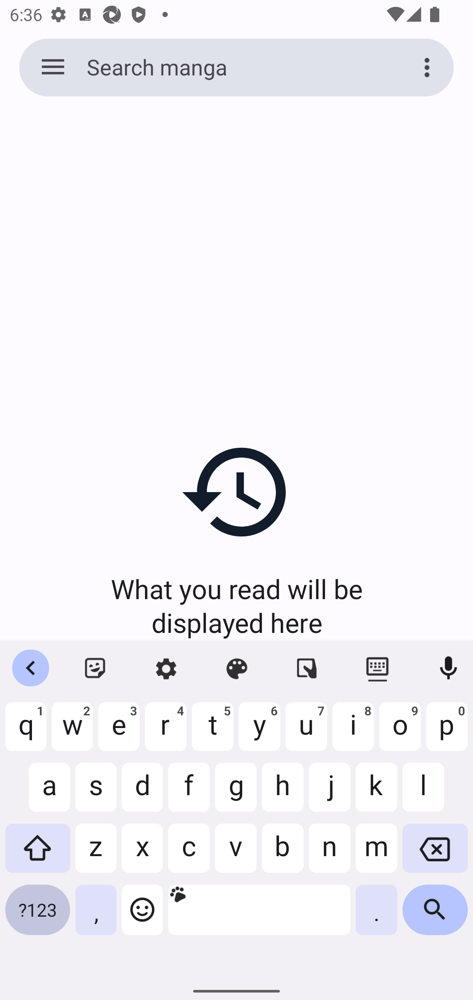

{'textfield_path': 'data/OSS/textfield_contexts/org.koitharu.kotatsu_1/searchView', 'textfield_info': {'index': '2', 'package': 'org.koitharu.kotatsu', 'class': 'android.widget.EditText', 'text': 'Search manga', 'resource-id': 'searchView', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[198,119][919,189]', 'displayed': 'true'}, 'app_name': 'org.koitharu.kotatsu', 'screenshot_path': 'data/OSS/snapshots/org.koitharu.kotatsu/-1399196902/screenshot.png', 'textfield_tokens': ['search', 'manga', 'view'], 'local_context': ['toolbar', 'open', 'menu', 'search', 'manga', 'view'], 'global_context': ['container', 'displayed', 'icon', 'swipe', 'action', 'app', 'card', 'more', 'open', 'read', 'content', 'what', 'background', 'will', 'search', 'secondary', 'primary', 'view', 'be', 'toolbar', 'side', 'options', 'refresh', 'yo

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                               nl.asymmetrics.droidshows
tf_path                        data/OSS/textfield_contexts/nl.asymmetrics.dro...
pred_top1                                                      [search, tv_show]
GT_categories                                            {'search': ['tv_show']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.41208333894610405), (description, ...
secondary_categories_ranked    [(tv_show, 0.4573947799702485), (app, 0.583017...
Name: 388, dtype: object

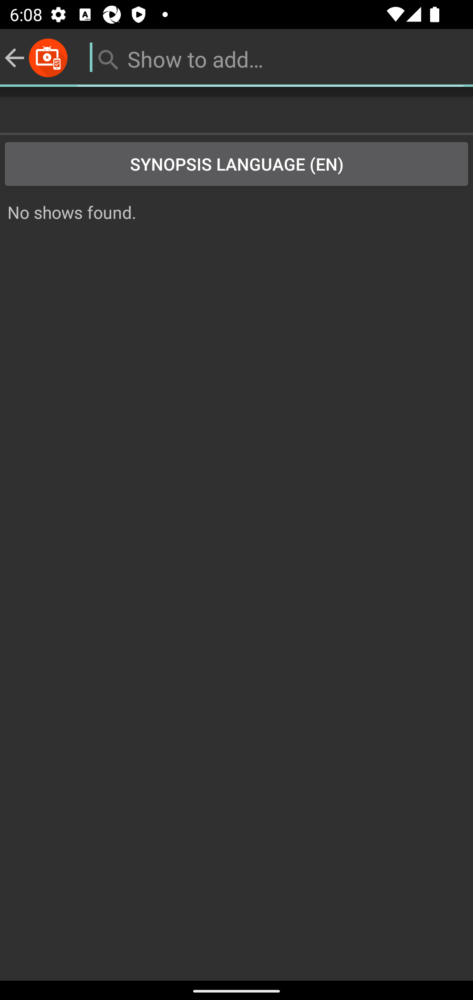

{'textfield_path': 'data/OSS/textfield_contexts/nl.asymmetrics.droidshows_1/search_src_text', 'textfield_info': {'index': '0', 'package': 'nl.asymmetrics.droidshows', 'class': 'android.widget.AutoCompleteTextView', 'text': '   Show to add…', 'resource-id': 'search_src_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[183,81][1058,180]', 'displayed': 'true'}, 'app_name': 'nl.asymmetrics.droidshows', 'screenshot_path': 'data/OSS/snapshots/nl.asymmetrics.droidshows/-924464529/screenshot.png', 'textfield_tokens': ['add', 'src', 'text', 'search', 'show', 'to'], 'local_context': ['search', 'plate', 'add', 'src', 'text', 'search', 'show', 'to'], 'global_context': ['bar', 'app', 'view', 'button', 'plate', 'frame', 'close', 'add', 'icon', 'content', 'src', 'text', 'search', 'show', 'edit', 'to']}

##401


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                               nl.asymmetrics.droidshows
tf_path                        data/OSS/textfield_contexts/nl.asymmetrics.dro...
pred_top1                                                      [search, tv_show]
GT_categories                                            {'search': ['tv_show']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.40504570975899695), (description, ...
secondary_categories_ranked    [(tv_show, 0.6161713631202776), (storage, 0.61...
Name: 400, dtype: object

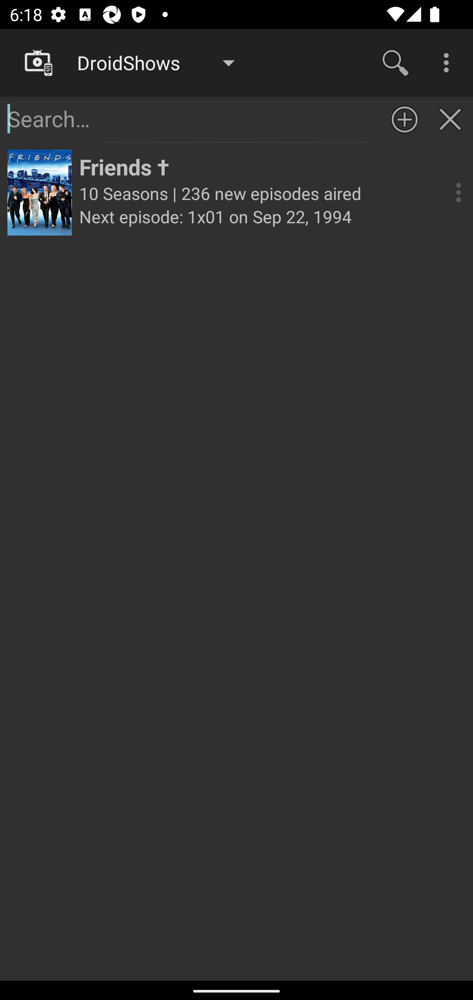

{'textfield_path': 'data/OSS/textfield_contexts/nl.asymmetrics.droidshows_1/search_text', 'textfield_info': {'index': '0', 'package': 'nl.asymmetrics.droidshows', 'class': 'android.widget.EditText', 'text': 'Search…', 'resource-id': 'search_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[0,220][872,321]', 'displayed': 'true'}, 'app_name': 'nl.asymmetrics.droidshows', 'screenshot_path': 'data/OSS/snapshots/nl.asymmetrics.droidshows/-52577856/screenshot.png', 'textfield_tokens': ['search', 'text'], 'local_context': ['search', 'search', 'text'], 'global_context': ['container', 'name', '1', 'ser', '10', '01', 'con', 'on', 'action', 'decor', 'parent', 'new', 'aired', 'more', 'shows', 'dr', 'content', 'background', 'search', 'list', '22', 'episode', 'friends', 'sep', 'options', 'oid', 'ie', 'text', 'seasons', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                             ExampleMVVM
tf_path                        data/OSS/textfield_contexts/ExampleMVVM_1/Acce...
pred_top1                                                        [search, movie]
GT_categories                                              {'search': ['movie']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.44176705082257584), (music, 0.6633...
secondary_categories_ranked    [(movie, 0.49144857935607433), (tv_show, 0.664...
Name: 412, dtype: object

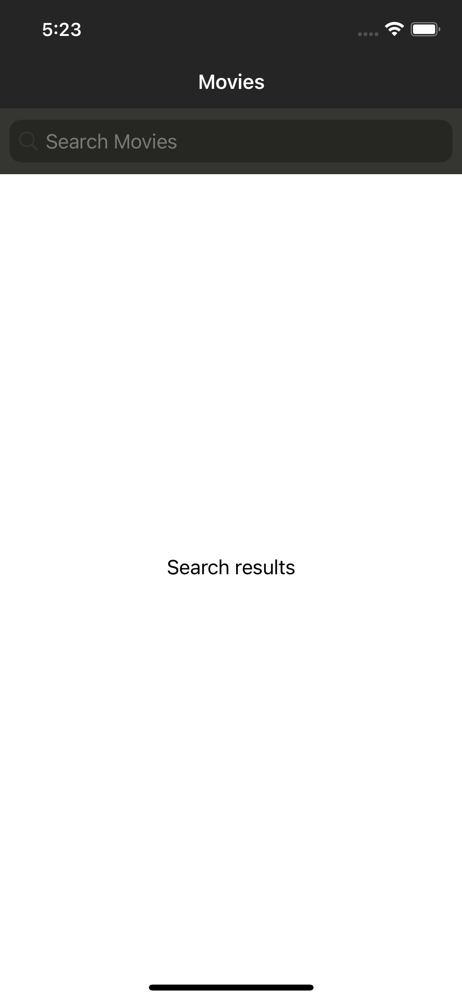

{'textfield_path': 'data/OSS/textfield_contexts/ExampleMVVM_1/AccessibilityIdentifierSearchMovies', 'textfield_info': {'type': 'XCUIElementTypeSearchField', 'name': 'AccessibilityIdentifierSearchMovies', 'label': 'Search Movies', 'enabled': 'true', 'visible': 'true', 'accessible': 'true', 'x': '8', 'y': '101', 'width': '374', 'height': '36', 'index': '0'}, 'app_name': 'ExampleMVVM', 'screenshot_path': 'data/OSS/snapshots/ExampleMVVM/47995988/screenshot.png', 'textfield_tokens': ['accessibility', 'movies', 'search', 'identifier'], 'local_context': ['accessibility', 'movies', 'search', 'identifier'], 'global_context': ['mvvm', 'accessibility', 'example', 'identifier', 'results', 'movies', 'search']}

##425


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                               AutoScout24_Buy_sell_cars
tf_path                        data/OSS/textfield_contexts/AutoScout24_Buy_se...
pred_top1                                                    [search, car_model]
GT_categories                                          {'search': ['car_model']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.442582239707311), (description, 0....
secondary_categories_ranked    [(car_model, 0.5306239637235801), (storage, 0....
Name: 424, dtype: object

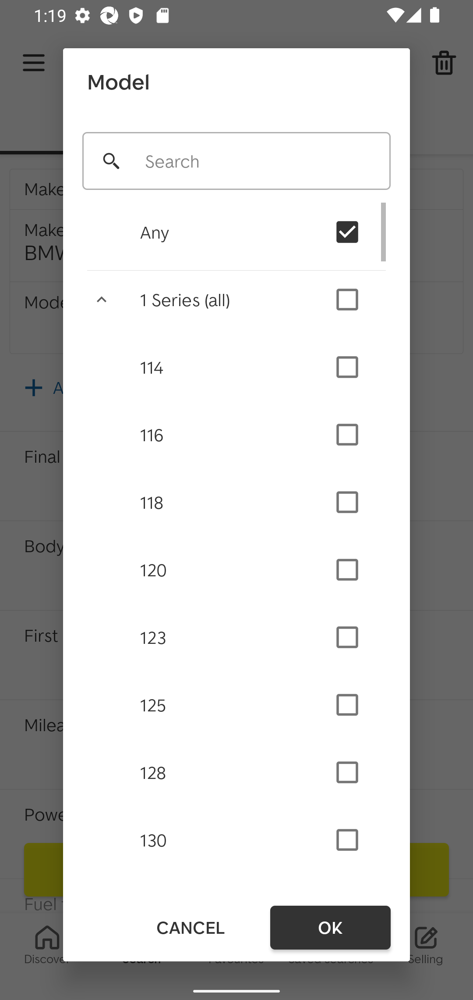

{'textfield_path': 'data/OSS/textfield_contexts/AutoScout24_Buy_sell_cars_v9.8/textinput_filter_edittext', 'textfield_info': {'index': '0', 'package': 'com.autoscout24', 'class': 'android.widget.EditText', 'text': 'Search', 'resource-id': 'textinput_filter_edittext', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[188,301][892,433]', 'displayed': 'true'}, 'app_name': 'AutoScout24_Buy_sell_cars', 'screenshot_path': 'data/OSS/snapshots/AutoScout24_Buy_sell_cars/1694299268/screenshot.png', 'textfield_tokens': ['input', 'text', 'search', 'filter', 'edit'], 'local_context': ['filter', 'input', 'container', 'text'], 'global_context': ['container', 'input', 'expand', '130', '1', 'icon', 'touch', '116', 'header', '19084', '135', 'filter', 'default', 'any', 'action', '19078', 'divider', '37', '120', '20149', 'ok', '118'

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Messenger
tf_path                        data/OSS/textfield_contexts/Messenger_1/131573223
pred_top1                                                       [profile, email]
GT_categories                                    {'profile': ['phone', 'email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.1404540518919627), (auth_code, 0....
secondary_categories_ranked    [(email, 0.20320130263765654), (phone, 0.34160...
Name: 436, dtype: object

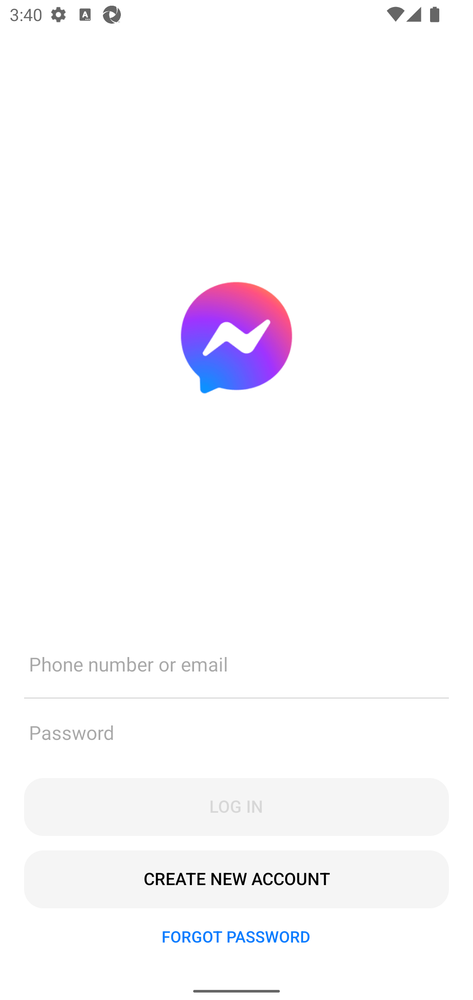

{'textfield_path': 'data/OSS/textfield_contexts/Messenger_1/131573223', 'textfield_info': {'index': '0', 'package': 'com.facebook.orca', 'class': 'android.widget.EditText', 'text': 'Phone number or email', 'content-desc': 'Phone number or email', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[55,1442][1025,1585]', 'displayed': 'true'}, 'app_name': 'Messenger', 'screenshot_path': 'data/OSS/snapshots/Messenger/-1496142319/screenshot.png', 'textfield_tokens': ['phone', 'or', 'number', 'email'], 'local_context': ['in', 'log', 'create', 'account', 'new', 'password', 'forgot'], 'global_context': ['number', 'bar', 'new', 'log', 'create', 'name', 'account', 'removed', 'forgot', 'phone', 'navigation', 'content', 'password', 'background', 'or', 'email', 'in']}

##449


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                               Messenger
tf_path                        data/OSS/textfield_contexts/Messenger_1/-14780...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.10429106007019677), (auth_code, 0...
secondary_categories_ranked    [(password, 0.09240498145421346), (email, 0.37...
Name: 448, dtype: object

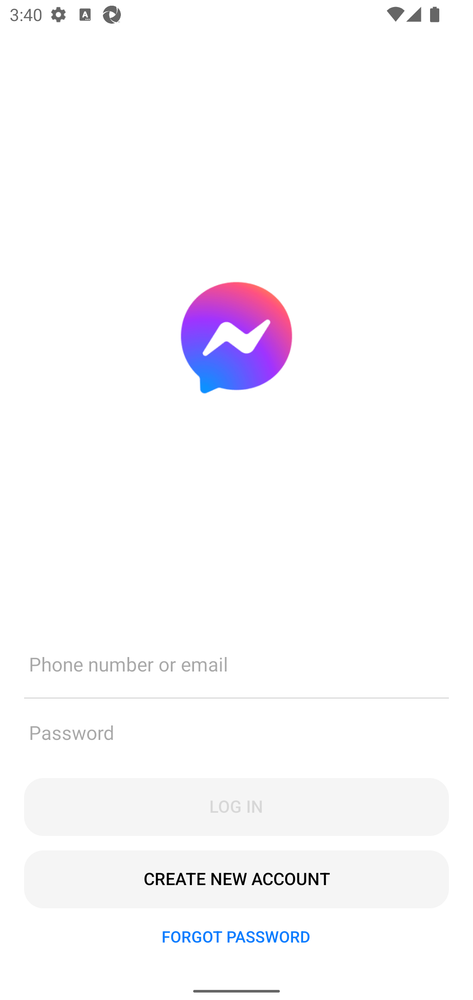

{'textfield_path': 'data/OSS/textfield_contexts/Messenger_1/-1478030010', 'textfield_info': {'index': '0', 'package': 'com.facebook.orca', 'class': 'android.widget.EditText', 'text': 'Password', 'content-desc': 'Password', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[55,825][1025,968]', 'displayed': 'true'}, 'app_name': 'Messenger', 'screenshot_path': 'data/OSS/snapshots/Messenger/-1496142319/screenshot.png', 'textfield_tokens': ['password'], 'local_context': [], 'global_context': ['number', 'bar', 'new', 'log', 'create', 'name', 'account', 'removed', 'forgot', 'phone', 'navigation', 'content', 'password', 'background', 'or', 'email', 'in']}

##473


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                   de.chaosdorf.meteroid
tf_path                        data/OSS/textfield_contexts/de.chaosdorf.meter...
pred_top1                                                         [profile, url]
GT_categories                                               {'profile': ['url']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.6115506559610366), (auth_code, 0....
secondary_categories_ranked    [(url, 0.237607870871822), (username, 0.603023...
Name: 472, dtype: object

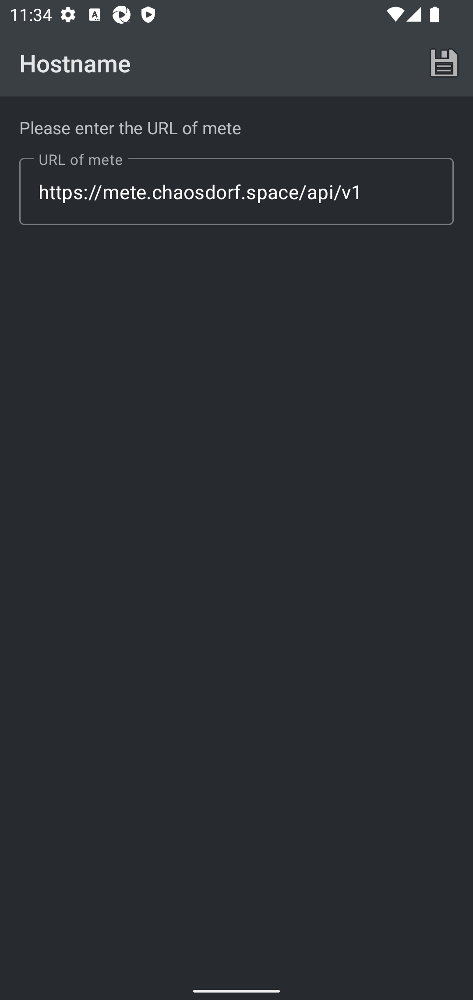

{'textfield_path': 'data/OSS/textfield_contexts/de.chaosdorf.meteroid_1/-1344947040', 'textfield_info': {'index': '0', 'package': 'de.chaosdorf.meteroid', 'class': 'android.widget.EditText', 'text': 'https', 'resource-id': 'hostname', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,360][1036,513]', 'displayed': 'true'}, 'app_name': 'de.chaosdorf.meteroid', 'screenshot_path': 'data/OSS/snapshots/de.chaosdorf.meteroid/-597245818/screenshot.png', 'textfield_tokens': ['hostname', 'https'], 'local_context': ['please', 'of', 'the', 'url', 'text', 'enter', 'mete'], 'global_context': ['action', 'bar', 'container', 'decor', 'parent', 'please', 'of', 'the', 'https', 'save', 'url', 'navigation', 'content', 'hostname', 'background', 'text', 'enter', 'mete']}

##485


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      org.y20k.escapepod
tf_path                        data/OSS/textfield_contexts/org.y20k.escapepod...
pred_top1                                                      [search, podcast]
GT_categories                                            {'search': ['podcast']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.37459213982025774), (profile, 0.50...
secondary_categories_ranked    [(podcast, 0.294582836329937), (web, 0.4117391...
Name: 484, dtype: object

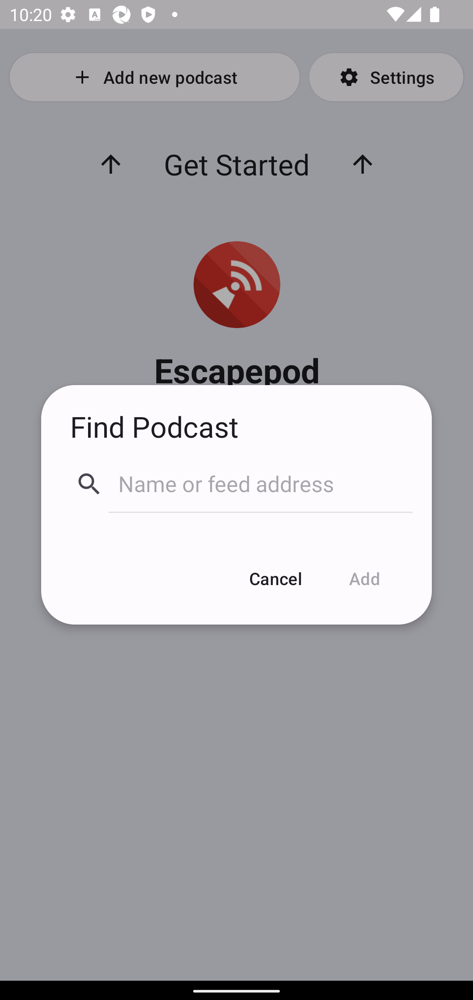

{'textfield_path': 'data/OSS/textfield_contexts/org.y20k.escapepod_1/search_src_text', 'textfield_info': {'index': '0', 'package': 'org.y20k.escapepod', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Name or feed address', 'resource-id': 'search_src_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[248,1053][942,1152]', 'displayed': 'true'}, 'app_name': 'org.y20k.escapepod', 'screenshot_path': 'data/OSS/snapshots/org.y20k.escapepod/966430078/screenshot.png', 'textfield_tokens': ['name', 'feed', 'text', 'src', 'address', 'search', 'or'], 'local_context': ['search', 'plate', 'name', 'feed', 'text', 'src', 'address', 'search', 'or'], 'global_context': ['result', 'name', '1', 'icon', 'panel', 'action', 'parent', 'custom', 'add', 'content', 'src', 'address', 'search', 'or', 'list', 'view', 'button', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                   Raivo
tf_path                        data/OSS/textfield_contexts/Raivo_1/passwordIn...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.3568024060378472), (auth_code, 0....
secondary_categories_ranked    [(password, 0.22293628845363855), (username, 0...
Name: 508, dtype: object

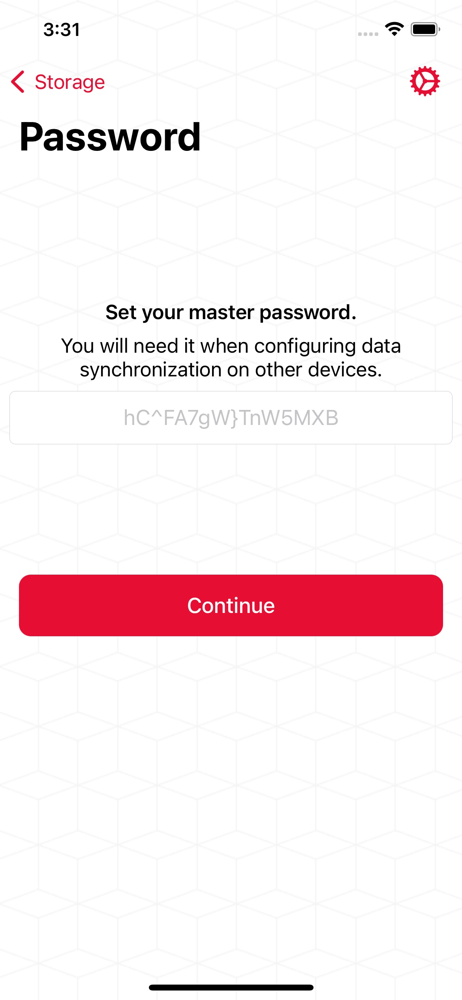

{'textfield_path': 'data/OSS/textfield_contexts/Raivo_1/passwordInitial', 'textfield_info': {'type': 'XCUIElementTypeSecureTextField', 'value': 'hC^FA7gW}TnW5MXB', 'name': 'passwordInitial', 'label': '', 'enabled': 'true', 'visible': 'true', 'accessible': 'true', 'x': '8', 'y': '330', 'width': '374', 'height': '45', 'index': '2'}, 'app_name': 'Raivo', 'screenshot_path': 'data/OSS/snapshots/Raivo/797759489/screenshot.png', 'textfield_tokens': ['initial', 'password'], 'local_context': ['your', 'set', 'password', 'master', 'synchronization', 'config', 'you', 'uring', 'it', 'need', 'will', 'data', 'when', 'other', 'devices', 'on', 'initial', 'password'], 'global_context': ['synchronization', 'setup', 'set', 's', 'w', 'd', 'f', 'j', 'c', 'i', 'uring', 'it', 'e', 'z', 'b', 'storage', 'devices', 'q', 'y', 'shift', 'numbers', 'on', 'u', 'a', 'delete', 'k', 'debug', 'continue', 't', 'more', 'master', 'will', 'data', 'when', 'other', 'raivo', 'l', 'g', 'o', 'v', 'you', 'p', 'password', 'next', '

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                   Raivo
tf_path                        data/OSS/textfield_contexts/Raivo_1/passwordCo...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.27793530796964966), (auth_code, 0...
secondary_categories_ranked    [(password, 0.18897887070973712), (username, 0...
Name: 520, dtype: object

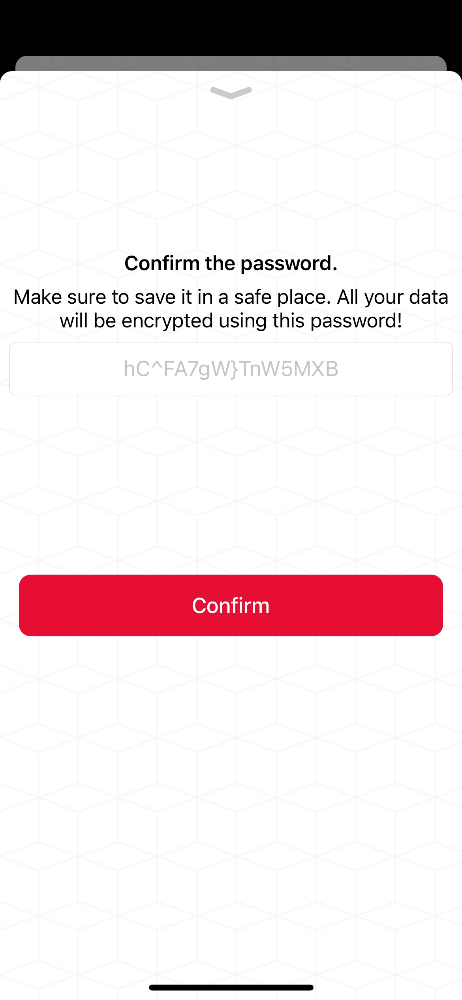

{'textfield_path': 'data/OSS/textfield_contexts/Raivo_1/passwordConfirmation', 'textfield_info': {'type': 'XCUIElementTypeSecureTextField', 'value': 'hC^FA7gW}TnW5MXB', 'name': 'passwordConfirmation', 'label': '', 'enabled': 'true', 'visible': 'true', 'accessible': 'true', 'x': '8', 'y': '288', 'width': '374', 'height': '46', 'index': '2'}, 'app_name': 'Raivo', 'screenshot_path': 'data/OSS/snapshots/Raivo/159475504/screenshot.png', 'textfield_tokens': ['confirmation', 'password'], 'local_context': ['password', 'the', 'confirm', 'make', 'sure', 'a', 'be', 'safe', 'in', 'this', 'all', 'using', 'save', 'it', 'your', 'password', 'will', 'data', 'encrypted', 'to', 'place', 'confirmation', 'password'], 'global_context': ['synchronization', 'make', 'setup', 'set', 's', 'w', 'd', 'f', 'close', 'j', 'c', 'save', 'uring', 'it', 'e', 'i', 'z', 'storage', 'devices', 'q', 'b', 'y', 'shift', 'numbers', 'on', 'confirm', 'place', 'a', 'u', 'delete', 'k', 'debug', 'continue', 't', 'more', 'master', 'wi

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                             Tubi_Movies
tf_path                          data/OSS/textfield_contexts/Tubi_Movies_1/email
pred_top1                                                       [profile, email]
GT_categories                                             {'profile': ['email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.16837060550848643), (auth_code, 0...
secondary_categories_ranked    [(email, 0.08717694133520126), (password, 0.38...
Name: 532, dtype: object

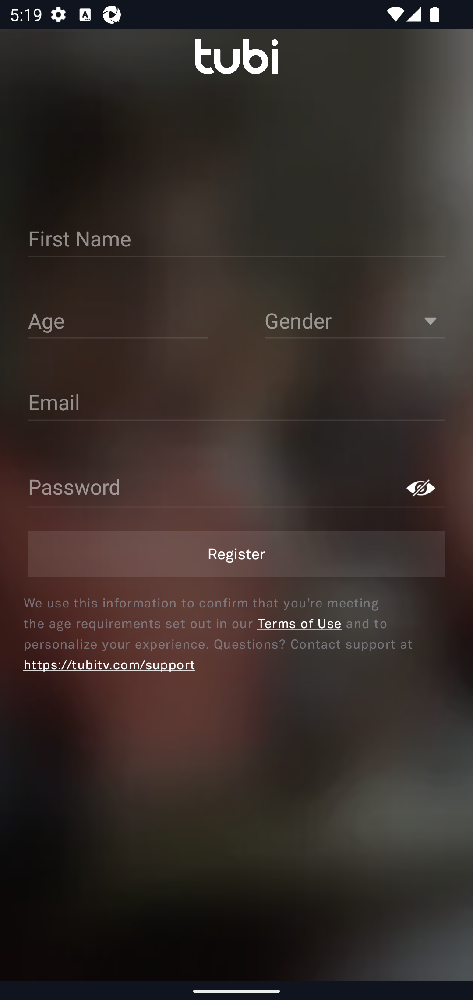

{'textfield_path': 'data/OSS/textfield_contexts/Tubi_Movies_1/email', 'textfield_info': {'index': '0', 'package': 'com.tubitv', 'class': 'android.widget.EditText', 'text': 'Email', 'resource-id': 'email', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[53,859][1027,981]', 'displayed': 'true'}, 'app_name': 'Tubi_Movies', 'screenshot_path': 'data/OSS/snapshots/Tubi_Movies/-1563197355/screenshot.png', 'textfield_tokens': ['email'], 'local_context': [], 'global_context': ['container', 'gender', 'input', 'activity', 'set', 'tubitv', 'name', 'of', 'end', 'register', 'icon', 'at', 'sign', 'out', 'youre', 'confirm', 'action', 'year', 'support', 'content', 'show', 'or', 'personalize', 'use', 'and', 'button', 'questions', 'this', 'first', 'information', 'our', 'layout', 'password', 'text', 'up', 'terms', 'that', 'email',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                             Tubi_Movies
tf_path                        data/OSS/textfield_contexts/Tubi_Movies_1/sear...
pred_top1                                                      [search, tv_show]
GT_categories                                   {'search': ['tv_show', 'movie']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.21236620868245762), (music, 0.5833...
secondary_categories_ranked    [(tv_show, 0.26662324368953705), (movie, 0.406...
Name: 544, dtype: object

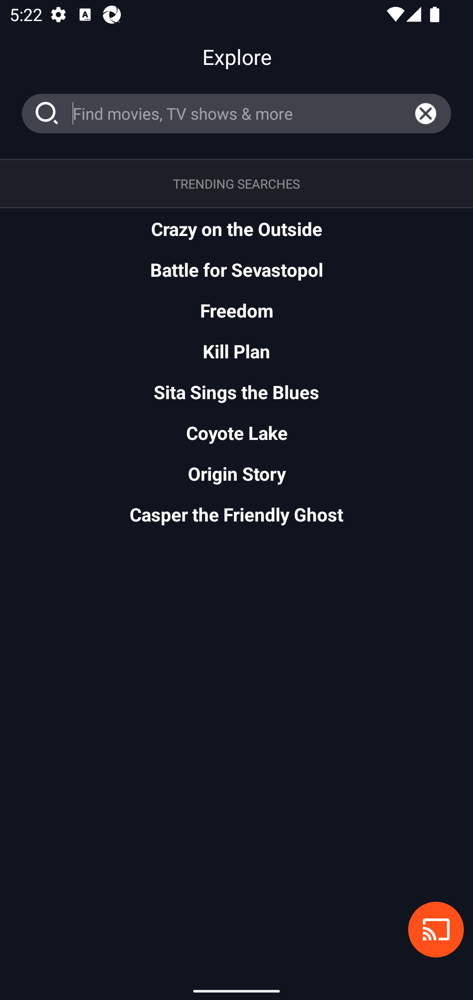

{'textfield_path': 'data/OSS/textfield_contexts/Tubi_Movies_1/search_input_box', 'textfield_info': {'index': '1', 'package': 'com.tubitv', 'class': 'android.widget.EditText', 'text': 'Find movies, TV shows & more', 'resource-id': 'search_input_box', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[50,214][1030,304]', 'displayed': 'true'}, 'app_name': 'Tubi_Movies', 'screenshot_path': 'data/OSS/snapshots/Tubi_Movies/-73242223/screenshot.png', 'textfield_tokens': ['input', 'find', 'more', 'box', 'shows', 'tv', 'movies', 'search'], 'local_context': ['search', 'icon', 'clear', 'button', 'input', 'find', 'more', 'box', 'shows', 'tv', 'movies', 'search', 'search', 'layout', 'detail'], 'global_context': ['container', 'plan', 'controller', 'input', 'activity', 'story', 'tubi', 'player', 'icon', 'outside', 'casper', 'sita

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                             Tubi_Movies
tf_path                        data/OSS/textfield_contexts/Tubi_Movies_1/pass...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.14326233516136802), (auth_code, 0...
secondary_categories_ranked    [(password, 0.09984838217496872), (email, 0.37...
Name: 556, dtype: object

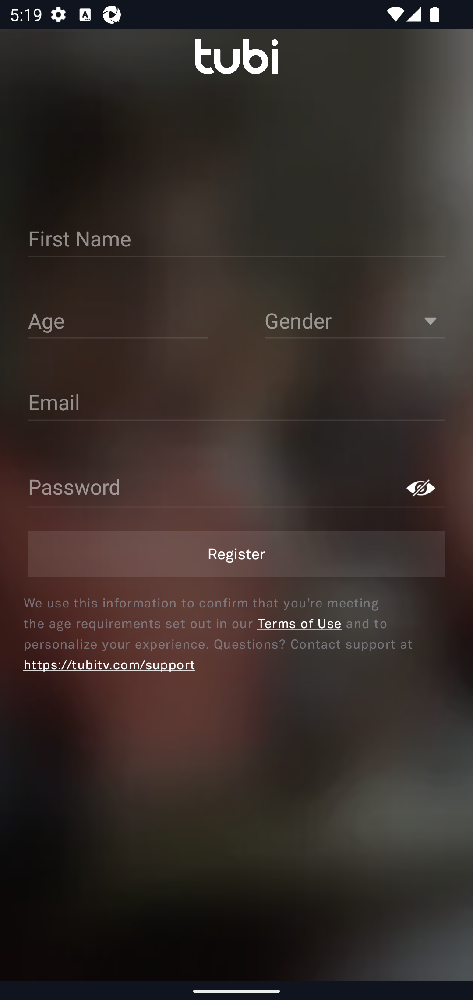

{'textfield_path': 'data/OSS/textfield_contexts/Tubi_Movies_1/password', 'textfield_info': {'index': '0', 'package': 'com.tubitv', 'class': 'android.widget.EditText', 'text': 'Password', 'resource-id': 'password', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[53,1047][1027,1179]', 'displayed': 'true'}, 'app_name': 'Tubi_Movies', 'screenshot_path': 'data/OSS/snapshots/Tubi_Movies/-1563197355/screenshot.png', 'textfield_tokens': ['password'], 'local_context': [], 'global_context': ['container', 'gender', 'input', 'activity', 'set', 'tubitv', 'name', 'of', 'end', 'register', 'icon', 'at', 'sign', 'out', 'youre', 'confirm', 'action', 'year', 'support', 'content', 'show', 'or', 'personalize', 'use', 'and', 'button', 'questions', 'this', 'first', 'information', 'our', 'layout', 'password', 'text', 'up', 'terms', 'th

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                             Tubi_Movies
tf_path                           data/OSS/textfield_contexts/Tubi_Movies_1/name
pred_top1                                                        [profile, name]
GT_categories                                              {'profile': ['name']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.44529060274362564), (datetime, 0....
secondary_categories_ranked    [(name, 0.36885304749011993), (username, 0.450...
Name: 568, dtype: object

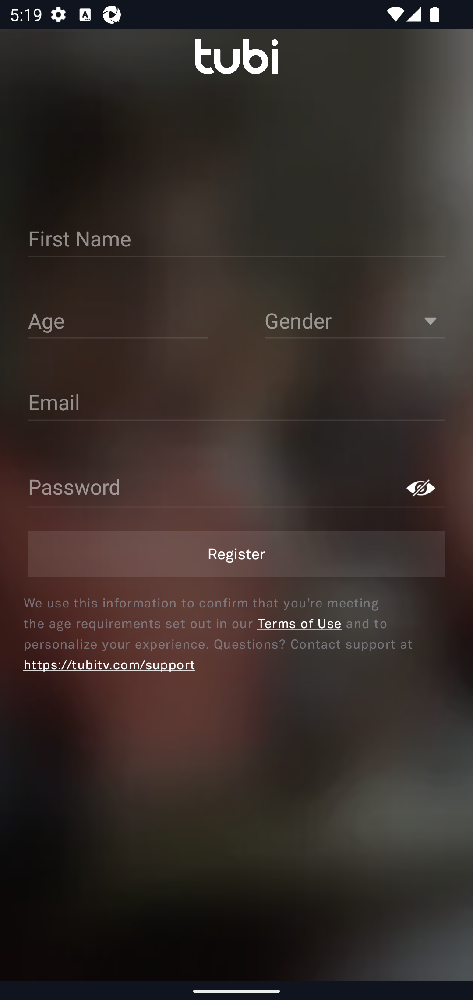

{'textfield_path': 'data/OSS/textfield_contexts/Tubi_Movies_1/name', 'textfield_info': {'index': '0', 'package': 'com.tubitv', 'class': 'android.widget.EditText', 'text': 'First Name', 'resource-id': 'name', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[53,486][1027,608]', 'displayed': 'true'}, 'app_name': 'Tubi_Movies', 'screenshot_path': 'data/OSS/snapshots/Tubi_Movies/-1563197355/screenshot.png', 'textfield_tokens': ['name', 'first'], 'local_context': [], 'global_context': ['container', 'gender', 'input', 'activity', 'set', 'tubitv', 'name', 'of', 'end', 'register', 'icon', 'at', 'sign', 'out', 'youre', 'confirm', 'action', 'year', 'support', 'content', 'show', 'or', 'personalize', 'use', 'and', 'button', 'questions', 'this', 'first', 'information', 'our', 'layout', 'password', 'text', 'up', 'terms', 'that

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                             Tubi_Movies
tf_path                        data/OSS/textfield_contexts/Tubi_Movies_1/text...
pred_top1                                                       [datetime, year]
GT_categories                         {'profile': ['age'], 'datetime': ['year']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(datetime, 0.34274365355571107), (profile, 0....
secondary_categories_ranked    [(year, 0.22105044685304165), (month, 0.384812...
Name: 580, dtype: object

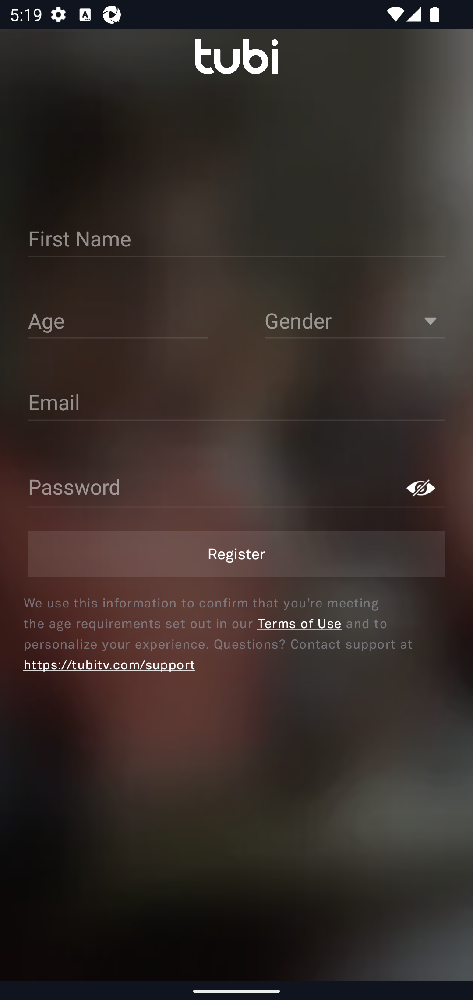

{'textfield_path': 'data/OSS/textfield_contexts/Tubi_Movies_1/text_year_or_age', 'textfield_info': {'index': '0', 'package': 'com.tubitv', 'class': 'android.widget.EditText', 'text': 'Age', 'resource-id': 'text_year_or_age', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'false', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[53,674][487,793]', 'displayed': 'true'}, 'app_name': 'Tubi_Movies', 'screenshot_path': 'data/OSS/snapshots/Tubi_Movies/-1563197355/screenshot.png', 'textfield_tokens': ['year', 'or', 'age', 'text'], 'local_context': ['or', 'layout', 'age', 'year'], 'global_context': ['container', 'gender', 'input', 'activity', 'set', 'tubitv', 'name', 'of', 'end', 'register', 'icon', 'at', 'sign', 'out', 'youre', 'confirm', 'action', 'year', 'support', 'content', 'show', 'or', 'personalize', 'use', 'and', 'button', 'questions', 'this', 'first', 'information',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                       [datetime, year]
GT_categories                                             {'datetime': ['year']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(datetime, 0.30557634035746256), (music, 0.62...
secondary_categories_ranked    [(year, 0.20744122316439945), (month, 0.375334...
Name: 592, dtype: object

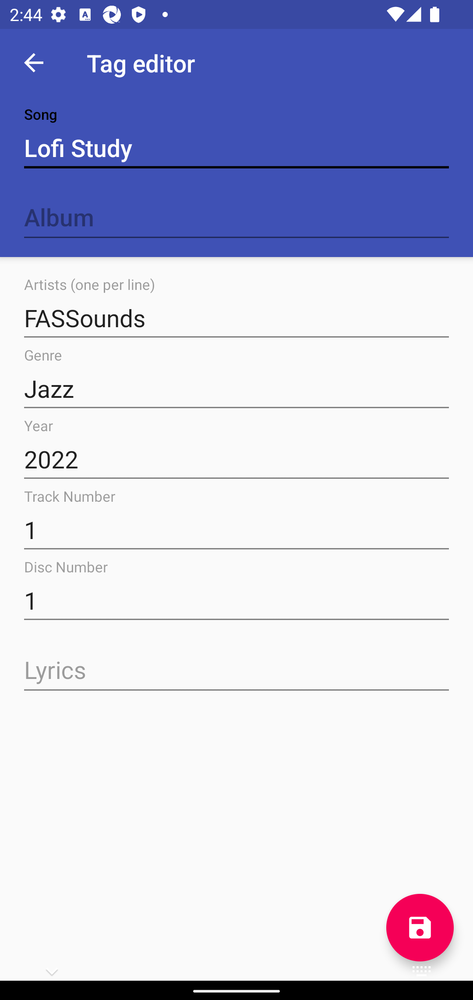

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/year', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.EditText', 'text': '2022', 'resource-id': 'year', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,982][1036,1113]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/-979703431/screenshot.png', 'textfield_tokens': ['2022', 'year'], 'local_context': ['editables'], 'global_context': ['fas', 'jazz', '1', 'sounds', 'header', '2022', 'genre', 'album', 'action', 'track', 'lyrics', 'artist', 'navigate', 'year', 'content', 'background', 'lofi', 'study', 'view', 'disc', 'toolbar', 'observable', 'fab', 'up', 'title', 'number', 'bar', '2', 'play', 'root', 'edit

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                         [music, genre]
GT_categories                                               {'music': ['genre']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(music, 0.1815588360031446), (label, 0.612288...
secondary_categories_ranked    [(genre, 0.17505273471275967), (album, 0.40306...
Name: 604, dtype: object

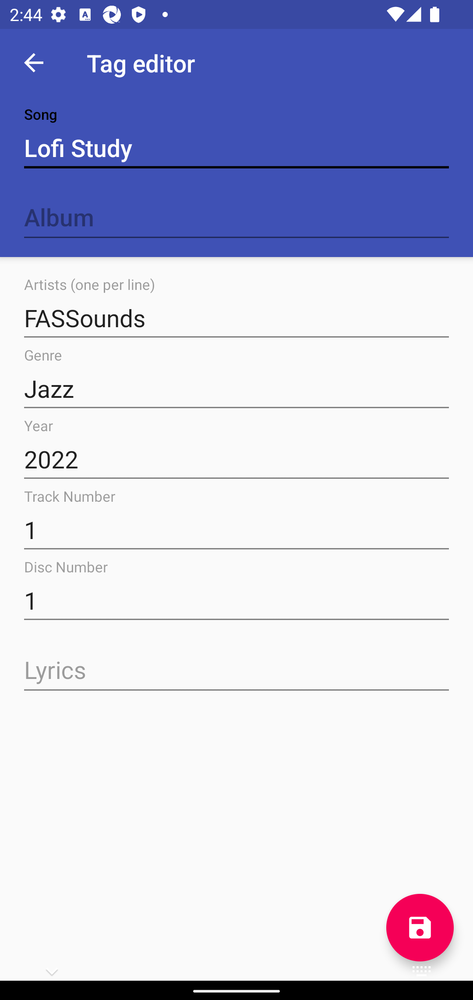

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/genre', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.EditText', 'text': 'Jazz', 'resource-id': 'genre', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,821][1036,952]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/-979703431/screenshot.png', 'textfield_tokens': ['jazz', 'genre'], 'local_context': ['editables'], 'global_context': ['fas', 'jazz', '1', 'sounds', 'header', '2022', 'genre', 'album', 'action', 'track', 'lyrics', 'artist', 'navigate', 'year', 'content', 'background', 'lofi', 'study', 'view', 'disc', 'toolbar', 'observable', 'fab', 'up', 'title', 'number', 'bar', '2', 'play', 'root', 'ed

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                          [label, None]
GT_categories                                   {'music': ['song'], 'label': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(label, 0.4261359594762325), (music, 0.459070...
secondary_categories_ranked                                                   []
Name: 616, dtype: object

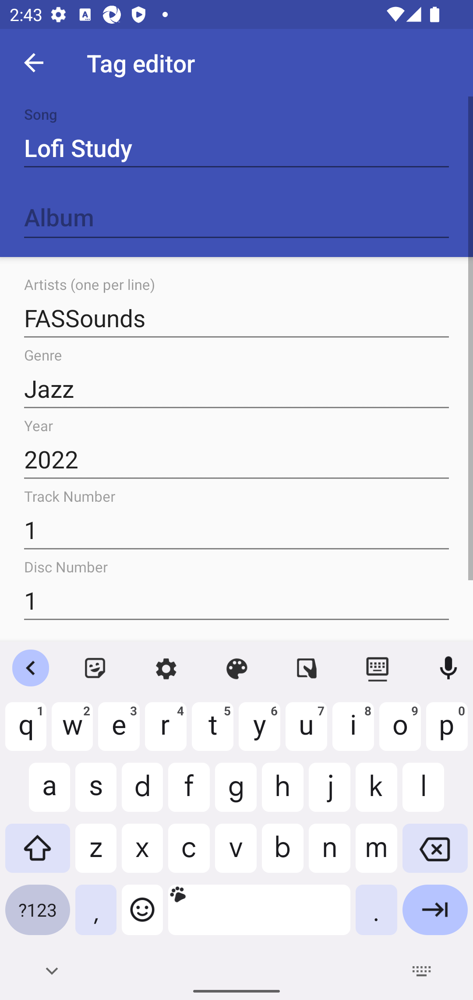

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/title1', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.EditText', 'text': 'Lofi Study', 'resource-id': 'title1', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,272][1036,403]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/-141330720/screenshot.png', 'textfield_tokens': ['lofi', '1', 'title', 'study'], 'local_context': ['header'], 'global_context': ['fas', 'jazz', '1', 'sounds', 'header', '2022', 'genre', 'album', 'action', 'track', 'artist', 'navigate', 'year', 'content', 'background', 'lofi', 'study', 'view', 'disc', 'toolbar', 'observable', 'up', 'title', 'number', 'bar', '2', 'root', 'editor', 

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                      [search, storage]
GT_categories                                   {'search': ['music', 'storage']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.4300210252404213), (description, 0...
secondary_categories_ranked    [(storage, 0.40740493436654407), (book, 0.6390...
Name: 628, dtype: object

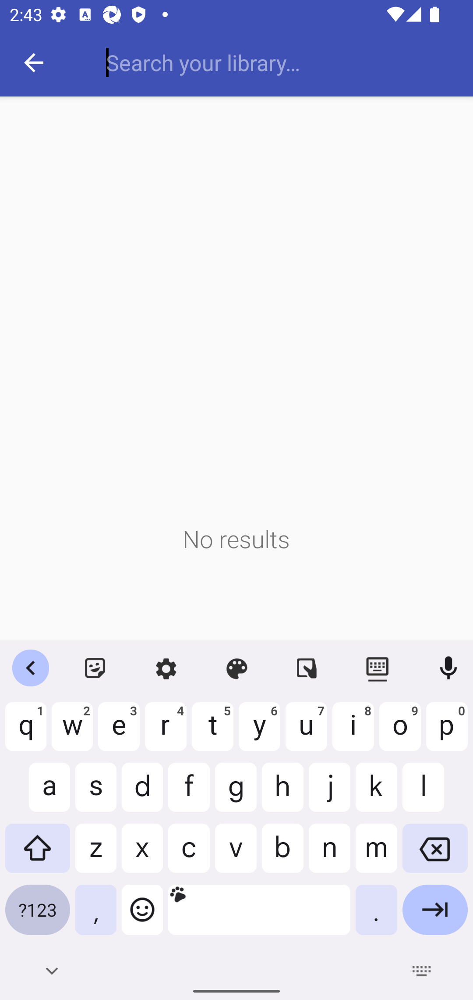

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/search_src_text', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Search your library…', 'resource-id': 'search_src_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[220,93][1058,192]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/404149954/screenshot.png', 'textfield_tokens': ['library', 'your', 'src', 'text', 'search'], 'local_context': ['search', 'plate', 'library', 'your', 'src', 'text', 'search'], 'global_context': ['empty', 'action', 'content', 'src', 'background', 'collapse', 'search', 'view', 'toolbar', 'frame', 'library', 'text', 'no', 'edit', 'bar', 'plate'

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                      [numerical, enum]
GT_categories                       {'music': ['number'], 'numerical': ['enum']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(numerical, 0.4321310445666313), (device_prof...
secondary_categories_ranked    [(enum, 0.46496061918636167), (amount, 0.66850...
Name: 640, dtype: object

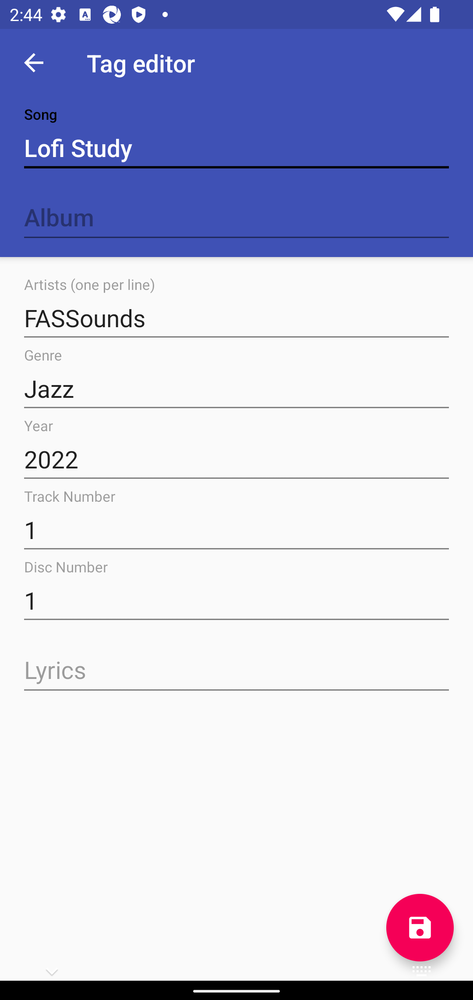

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/disc_number', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.EditText', 'text': '1', 'resource-id': 'disc_number', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,1304][1036,1435]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/-979703431/screenshot.png', 'textfield_tokens': ['number', 'disc', '1'], 'local_context': ['editables'], 'global_context': ['fas', 'jazz', '1', 'sounds', 'header', '2022', 'genre', 'album', 'action', 'track', 'lyrics', 'artist', 'navigate', 'year', 'content', 'background', 'lofi', 'study', 'view', 'disc', 'toolbar', 'observable', 'fab', 'up', 'title', 'number', 'bar', '2', 'p

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                      [numerical, enum]
GT_categories                       {'music': ['number'], 'numerical': ['enum']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(numerical, 0.43141015544533723), (device_pro...
secondary_categories_ranked    [(enum, 0.4567204713821411), (amount, 0.671377...
Name: 652, dtype: object

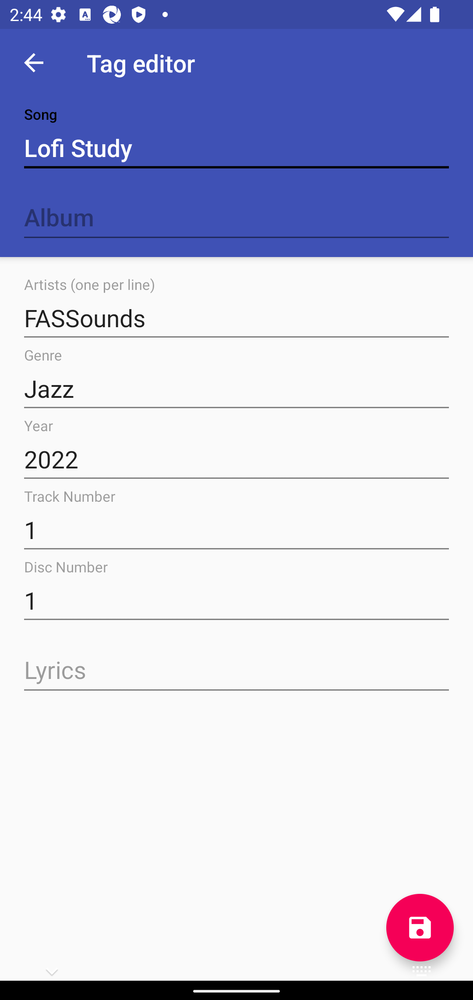

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/track_number', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.EditText', 'text': '1', 'resource-id': 'track_number', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,1143][1036,1274]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/-979703431/screenshot.png', 'textfield_tokens': ['number', 'track', '1'], 'local_context': ['editables'], 'global_context': ['fas', 'jazz', '1', 'sounds', 'header', '2022', 'genre', 'album', 'action', 'track', 'lyrics', 'artist', 'navigate', 'year', 'content', 'background', 'lofi', 'study', 'view', 'disc', 'toolbar', 'observable', 'fab', 'up', 'title', 'number', 'bar', '2',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                              com.poupa.vinylmusicplayer
tf_path                        data/OSS/textfield_contexts/com.poupa.vinylmus...
pred_top1                                                        [music, artist]
GT_categories                                              {'music': ['artist']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(music, 0.3102692121018966), (label, 0.641670...
secondary_categories_ranked    [(artist, 0.25071826825539273), (album, 0.4187...
Name: 664, dtype: object

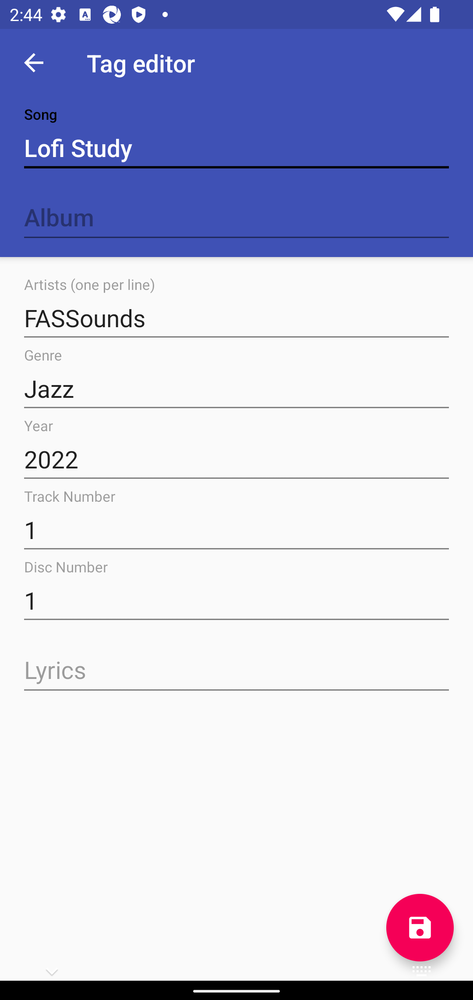

{'textfield_path': 'data/OSS/textfield_contexts/com.poupa.vinylmusicplayer_1/artist', 'textfield_info': {'index': '0', 'package': 'com.poupa.vinylmusicplayer', 'class': 'android.widget.EditText', 'text': 'FASSounds', 'resource-id': 'artist', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,660][1036,791]', 'displayed': 'true'}, 'app_name': 'com.poupa.vinylmusicplayer', 'screenshot_path': 'data/OSS/snapshots/com.poupa.vinylmusicplayer/-979703431/screenshot.png', 'textfield_tokens': ['artist', 'fas', 'sounds'], 'local_context': ['editables'], 'global_context': ['fas', 'jazz', '1', 'sounds', 'header', '2022', 'genre', 'album', 'action', 'track', 'lyrics', 'artist', 'navigate', 'year', 'content', 'background', 'lofi', 'study', 'view', 'disc', 'toolbar', 'observable', 'fab', 'up', 'title', 'number', 'bar', '2', 'p

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                               OK_Social_Network_v22.6.1
tf_path                        data/OSS/textfield_contexts/OK_Social_Network_...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.2094870435694853), (auth_code, 0....
secondary_categories_ranked    [(password, 0.1768600841363271), (email, 0.361...
Name: 676, dtype: object

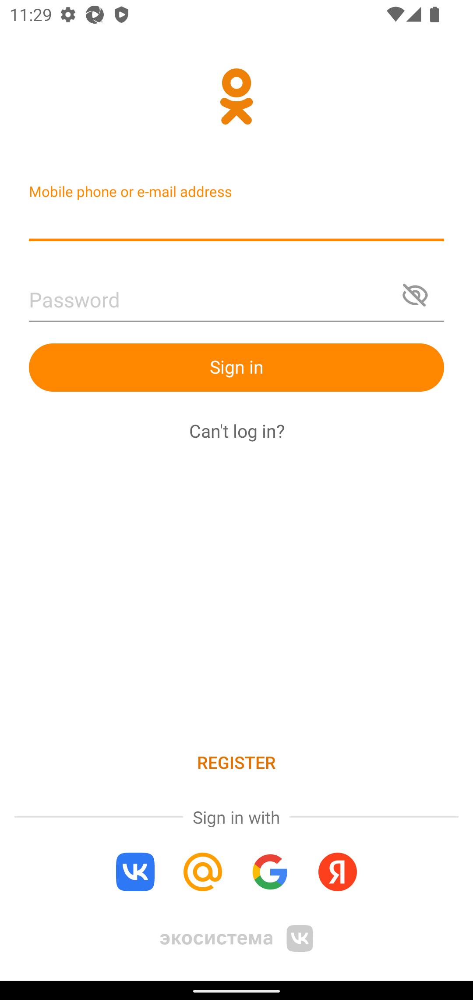

{'textfield_path': 'data/OSS/textfield_contexts/OK_Social_Network_v22.6.1_1/password_text', 'textfield_info': {'index': '0', 'package': 'ru.ok.android', 'class': 'android.widget.EditText', 'text': 'Password', 'resource-id': 'password_text', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[66,607][1014,739]', 'displayed': 'true'}, 'app_name': 'OK_Social_Network_v22.6.1', 'screenshot_path': 'data/OSS/snapshots/OK_Social_Network_v22.6.1/-1550987636/screenshot.png', 'textfield_tokens': ['password', 'text'], 'local_context': ['password', 'input', 'text'], 'global_context': ['container', 'input', 'registration', 'yandex', 'end', 'register', 'icon', 'mobile', 'sign', 'autocomplete', 'meter', 'mail', 'action', 'on', 'footer', 'parent', 'log', 'full', 'ok', 'content', 'background', 'address', 'networks', 'or', 'placeholde

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                               OK_Social_Network_v22.6.1
tf_path                        data/OSS/textfield_contexts/OK_Social_Network_...
pred_top1                                                       [profile, email]
GT_categories                                    {'profile': ['phone', 'email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.08356890479723612), (auth_code, 0...
secondary_categories_ranked    [(email, 0.15346323450406393), (phone, 0.16576...
Name: 688, dtype: object

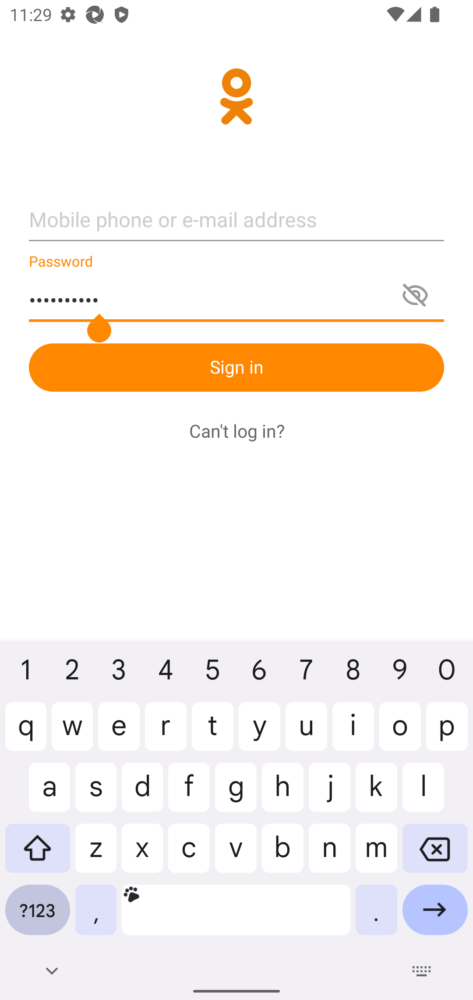

{'textfield_path': 'data/OSS/textfield_contexts/OK_Social_Network_v22.6.1_1/text_login', 'textfield_info': {'index': '0', 'package': 'ru.ok.android', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Mobile phone or e-mail address', 'resource-id': 'text_login', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[66,448][1014,555]', 'displayed': 'true'}, 'app_name': 'OK_Social_Network_v22.6.1', 'screenshot_path': 'data/OSS/snapshots/OK_Social_Network_v22.6.1/-711716765/screenshot.png', 'textfield_tokens': ['mobile', 'phone', 'text', 'address', 'or', 'login', 'email'], 'local_context': ['autocomplete', 'input', 'text'], 'global_context': ['container', 'input', 'registration', 'yandex', '3457', 'end', 'register', 'icon', 'mobile', 'sign', 'autocomplete', 'meter', 'mail', 'action', 'on', 'footer', 'parent', 'log

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                    Hulu
tf_path                                 data/OSS/textfield_contexts/Hulu_1/email
pred_top1                                                       [profile, email]
GT_categories                                             {'profile': ['email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.16348261932531993), (auth_code, 0...
secondary_categories_ranked    [(email, 0.0976274957259496), (password, 0.359...
Name: 700, dtype: object

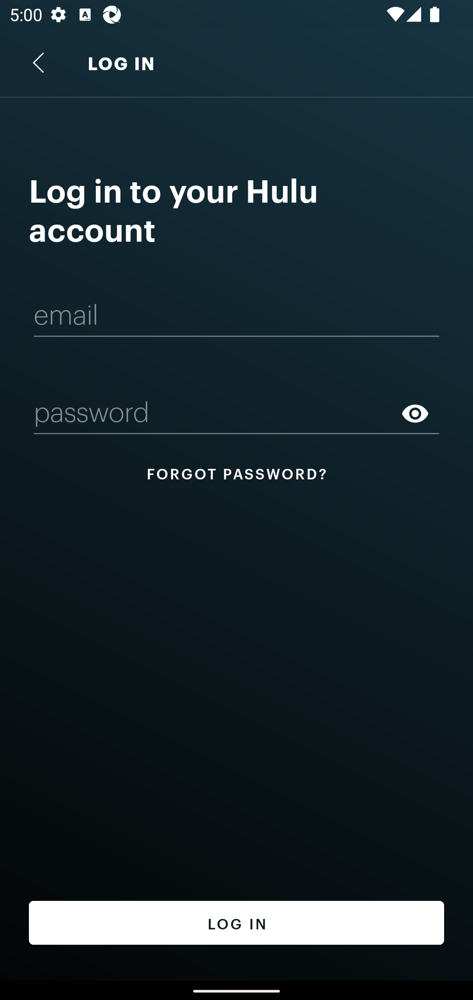

{'textfield_path': 'data/OSS/textfield_contexts/Hulu_1/email', 'textfield_info': {'index': '0', 'package': 'com.hulu.plus', 'class': 'android.widget.EditText', 'text': 'email', 'resource-id': 'email', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[66,653][1014,790]', 'displayed': 'true'}, 'app_name': 'Hulu', 'screenshot_path': 'data/OSS/snapshots/Hulu/638690253/screenshot.png', 'textfield_tokens': ['email'], 'local_context': ['linear', 'layout', 'log', 'in', 'your', 'hulu', 'account', 'to', 'password', 'forgot'], 'global_context': ['container', 'input', 'end', 'icon', 'account', 'action', 'linear', 'divider', 'log', 'fragment', 'navigate', 'forgot', 'content', 'background', 'show', 'view', 'toolbar', 'button', 'layout', 'password', 'coordinator', 'text', 'up', 'hulu', 'login', 'email', 'to', 'bar', 'root', 'na

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                                    Hulu
tf_path                              data/OSS/textfield_contexts/Hulu_1/password
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.13837434897820153), (auth_code, 0...
secondary_categories_ranked    [(password, 0.07471684863169988), (email, 0.38...
Name: 712, dtype: object

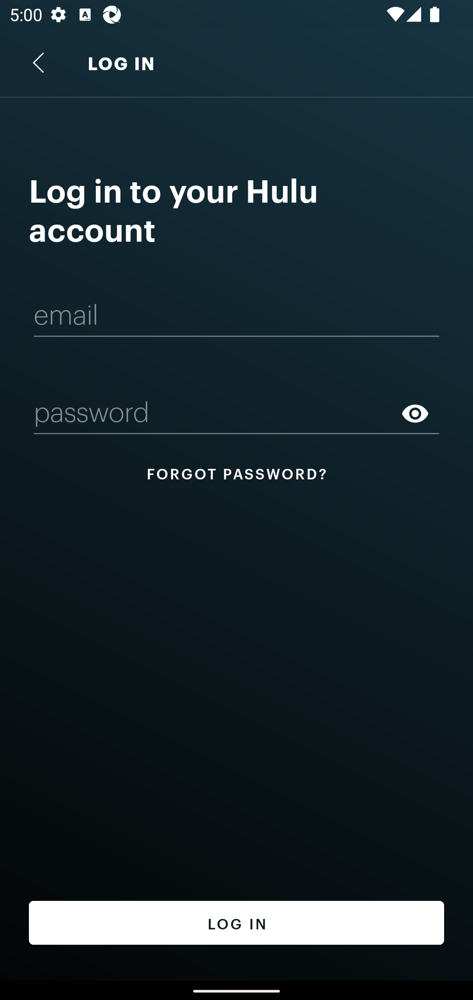

{'textfield_path': 'data/OSS/textfield_contexts/Hulu_1/password', 'textfield_info': {'index': '0', 'package': 'com.hulu.plus', 'class': 'android.widget.EditText', 'text': 'password', 'resource-id': 'password', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[66,875][1014,1012]', 'displayed': 'true'}, 'app_name': 'Hulu', 'screenshot_path': 'data/OSS/snapshots/Hulu/638690253/screenshot.png', 'textfield_tokens': ['password'], 'local_context': ['linear', 'layout', 'log', 'in', 'your', 'hulu', 'account', 'to', 'password', 'forgot'], 'global_context': ['container', 'input', 'end', 'icon', 'account', 'action', 'linear', 'divider', 'log', 'fragment', 'navigate', 'forgot', 'content', 'background', 'show', 'view', 'toolbar', 'button', 'layout', 'password', 'coordinator', 'text', 'up', 'hulu', 'login', 'email', 'to', 'bar',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      im.status.ethereum
tf_path                        data/OSS/textfield_contexts/im.status.ethereum...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.3313377077380816), (auth_code, 0....
secondary_categories_ranked    [(password, 0.19256468613942462), (username, 0...
Name: 724, dtype: object

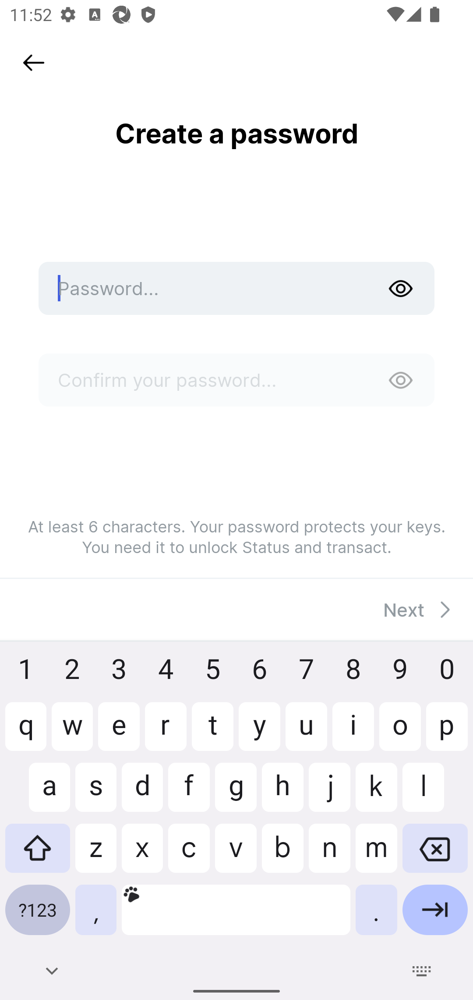

{'textfield_path': 'data/OSS/textfield_contexts/im.status.ethereum_1/-400961918', 'textfield_info': {'index': '0', 'package': 'im.status.ethereum', 'class': 'android.widget.EditText', 'text': 'Password...', 'content-desc': 'password-input', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[88,983][838,1104]', 'displayed': 'true'}, 'app_name': 'im.status.ethereum', 'screenshot_path': 'data/OSS/snapshots/im.status.ethereum/508861723/screenshot.png', 'textfield_tokens': ['password', 'input'], 'local_context': [], 'global_context': ['keys', 'input', 'unlock', '6', 'icon', 'it', 'at', 'confirm', 'action', 'a', 'onboardingnextbutton', 'navigate', 'content', 'background', 'characters', 'protects', 'and', 'transact', 'you', 'password', 'up', 'next', 'to', 'bar', 'least', 'root', 'navigation', 'your', 'need', 'status', 'cre

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      im.status.ethereum
tf_path                        data/OSS/textfield_contexts/im.status.ethereum...
pred_top1                                                    [profile, password]
GT_categories                                          {'profile': ['password']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.360184475282828), (auth_code, 0.4...
secondary_categories_ranked    [(password, 0.2282346412539482), (username, 0....
Name: 736, dtype: object

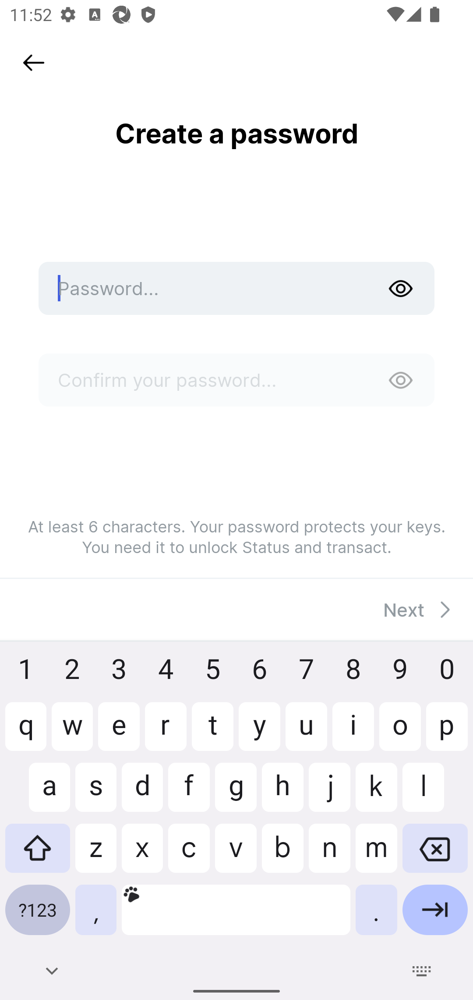

{'textfield_path': 'data/OSS/textfield_contexts/im.status.ethereum_1/-103358224', 'textfield_info': {'index': '0', 'package': 'im.status.ethereum', 'class': 'android.widget.EditText', 'text': 'Confirm your password...', 'content-desc': 'password-input', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'true', 'scrollable': 'false', 'selected': 'false', 'bounds': '[88,1192][838,1313]', 'displayed': 'true'}, 'app_name': 'im.status.ethereum', 'screenshot_path': 'data/OSS/snapshots/im.status.ethereum/508861723/screenshot.png', 'textfield_tokens': ['password', 'your', 'input', 'confirm'], 'local_context': [], 'global_context': ['keys', 'input', 'unlock', '6', 'icon', 'it', 'at', 'confirm', 'action', 'a', 'onboardingnextbutton', 'navigate', 'content', 'background', 'characters', 'protects', 'and', 'transact', 'you', 'password', 'up', 'next', 'to', 'bar', 'least', 'root', 'navigatio

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                org.totschnig.myexpenses
tf_path                        data/OSS/textfield_contexts/org.totschnig.myex...
pred_top1                                                        [ledger, payee]
GT_categories                     {'numerical': ['amount'], 'ledger': ['payee']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(ledger, 0.21694993376731872), (description, ...
secondary_categories_ranked    [(payee, 0.10216134289900462), (balance, 0.682...
Name: 760, dtype: object

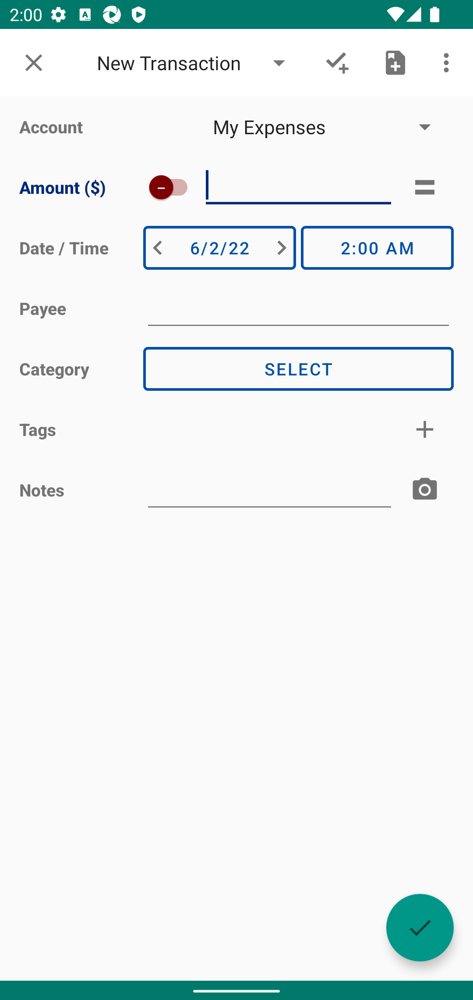

{'textfield_path': 'data/OSS/textfield_contexts/org.totschnig.myexpenses_1/Payee', 'textfield_info': {'index': '1', 'package': 'org.totschnig.myexpenses', 'class': 'android.widget.AutoCompleteTextView', 'text': '', 'resource-id': 'Payee', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[327,641][1036,765]', 'displayed': 'true'}, 'app_name': 'org.totschnig.myexpenses', 'screenshot_path': 'data/OSS/snapshots/org.totschnig.myexpenses/-1243134374/screenshot.png', 'textfield_tokens': ['payee'], 'local_context': ['row', 'payee', 'label', 'payee', 'payee'], 'global_context': ['container', 'notes', 'row', '1', 'close', '6', 'save', '00', 'as', 'account', 'action', 'expense', 'new', 'time', 'transaction', 'more', 'comment', 'navigate', 'scrollable', 'calculator', 'content', 'background', 'category', 'data', 'or', 'form',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                org.totschnig.myexpenses
tf_path                        data/OSS/textfield_contexts/org.totschnig.myex...
pred_top1                                                    [numerical, amount]
GT_categories                                          {'numerical': ['amount']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(numerical, 0.3491883516311645), (description...
secondary_categories_ranked    [(amount, 0.3400005139410496), (ratio, 0.62320...
Name: 772, dtype: object

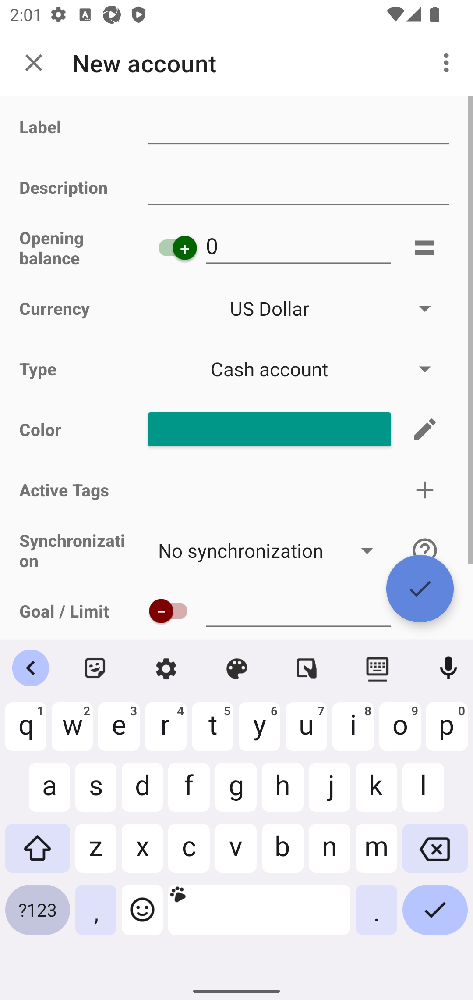

{'textfield_path': 'data/OSS/textfield_contexts/org.totschnig.myexpenses_1/AmountEditText', 'textfield_info': {'index': '1', 'package': 'org.totschnig.myexpenses', 'class': 'android.widget.EditText', 'text': '0', 'resource-id': 'AmountEditText', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[459,499][904,623]', 'displayed': 'true'}, 'app_name': 'org.totschnig.myexpenses', 'screenshot_path': 'data/OSS/snapshots/org.totschnig.myexpenses/-14726600/screenshot.png', 'textfield_tokens': ['edit', 'amount', '0', 'text'], 'local_context': ['balance', 'amount', 'opening', 'income', 'balance', 'ta', 'type', 'opening', 'edit', 'amount', '0', 'text', 'calculator', 'balance', 'opening'], 'global_context': ['container', 'synchronization', 'row', 'input', '1', 'close', 'save', 'balance', 'indicator', 'account', 'action', 'exp

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                org.totschnig.myexpenses
tf_path                        data/OSS/textfield_contexts/org.totschnig.myex...
pred_top1                                                            [tag, None]
GT_categories                                                        {'tag': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(tag, 0.22592405304312704), (description, 0.6...
secondary_categories_ranked                                                   []
Name: 784, dtype: object

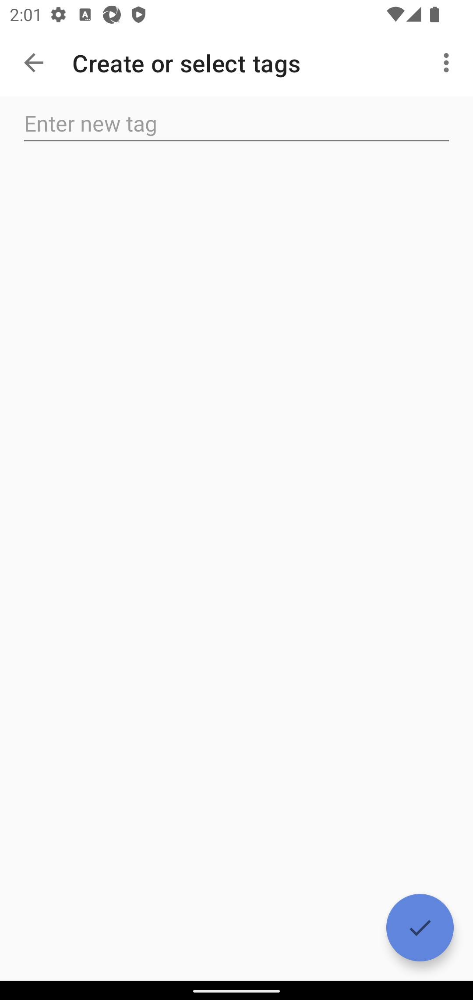

{'textfield_path': 'data/OSS/textfield_contexts/org.totschnig.myexpenses_1/tag_edit', 'textfield_info': {'index': '0', 'package': 'org.totschnig.myexpenses', 'class': 'android.widget.EditText', 'text': 'Enter new tag', 'resource-id': 'tag_edit', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[44,220][1036,344]', 'displayed': 'true'}, 'app_name': 'org.totschnig.myexpenses', 'screenshot_path': 'data/OSS/snapshots/org.totschnig.myexpenses/-1635201685/screenshot.png', 'textfield_tokens': ['edit', 'enter', 'new', 'tag'], 'local_context': ['edit', 'enter', 'new', 'tag', 'recycler', 'view'], 'global_context': ['container', 'confirm', 'action', 'new', 'fragment', 'more', 'navigate', 'content', 'background', 'enter', 'or', 'list', 'view', 'toolbar', 'command', 'select', 'options', 'tags', 'up', 'edit', 'bar', 'root', 't

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                org.totschnig.myexpenses
tf_path                        data/OSS/textfield_contexts/org.totschnig.myex...
pred_top1                                                          [label, None]
GT_categories                                                      {'label': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(label, 0.23404030427336692), (tag, 0.4901389...
secondary_categories_ranked                                                   []
Name: 796, dtype: object

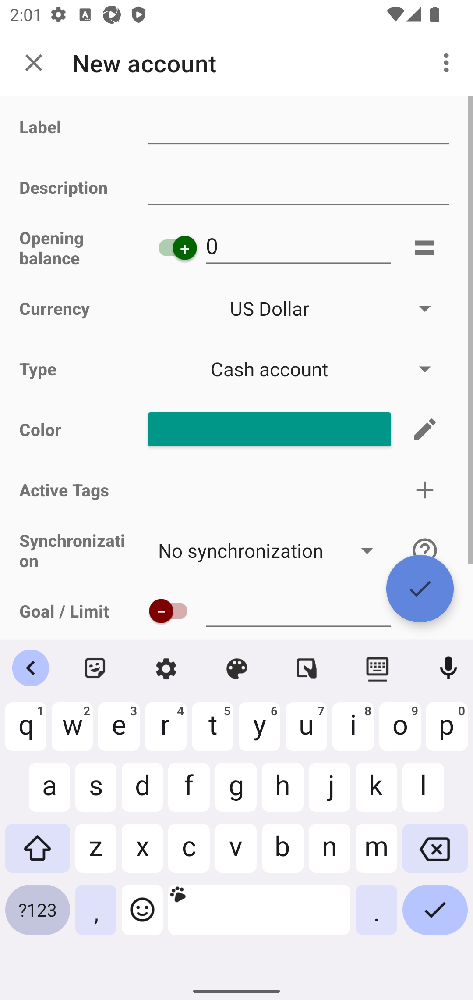

{'textfield_path': 'data/OSS/textfield_contexts/org.totschnig.myexpenses_1/Label', 'textfield_info': {'index': '1', 'package': 'org.totschnig.myexpenses', 'class': 'android.widget.EditText', 'text': '', 'resource-id': 'Label', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[327,227][1036,351]', 'displayed': 'true'}, 'app_name': 'org.totschnig.myexpenses', 'screenshot_path': 'data/OSS/snapshots/org.totschnig.myexpenses/-14726600/screenshot.png', 'textfield_tokens': ['label'], 'local_context': ['label', 'label'], 'global_context': ['container', 'synchronization', 'row', 'input', '1', 'close', 'save', 'balance', 'indicator', 'account', 'action', 'expense', 'new', 'description', 'more', 'navigate', 'active', 'income', 'calculator', 'cash', 'content', 'background', 'data', 'criterion', 'or', 'help', 'form', 'opening

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                org.totschnig.myexpenses
tf_path                        data/OSS/textfield_contexts/org.totschnig.myex...
pred_top1                                                    [description, None]
GT_categories                                                {'description': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(description, 0.17652519692977267), (tag, 0.5...
secondary_categories_ranked                                                   []
Name: 808, dtype: object

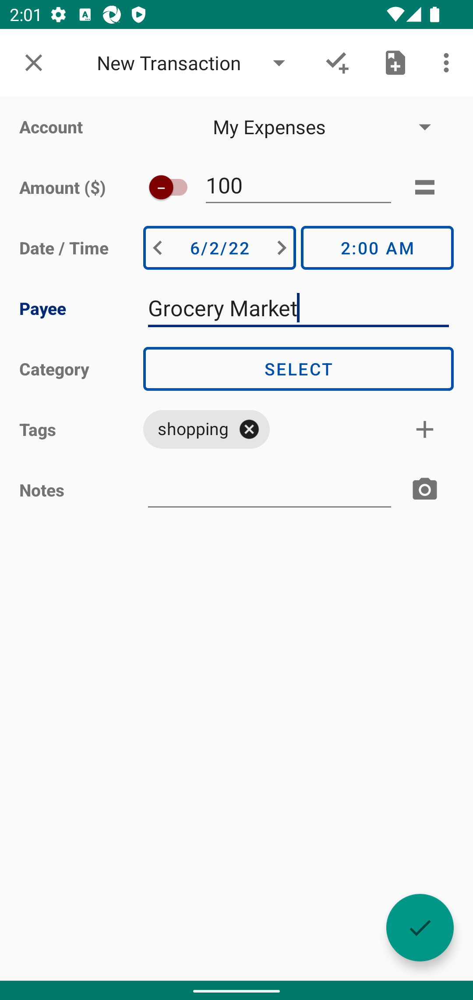

{'textfield_path': 'data/OSS/textfield_contexts/org.totschnig.myexpenses_1/Comment', 'textfield_info': {'index': '0', 'package': 'org.totschnig.myexpenses', 'class': 'android.widget.EditText', 'text': '', 'resource-id': 'Comment', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[327,1055][904,1179]', 'displayed': 'true'}, 'app_name': 'org.totschnig.myexpenses', 'screenshot_path': 'data/OSS/snapshots/org.totschnig.myexpenses/1111865268/screenshot.png', 'textfield_tokens': ['comment'], 'local_context': ['comment', 'transaction', 'to', 'image', 'attach'], 'global_context': ['container', 'notes', 'row', '1', 'close', '6', 'save', 'grocery', '00', 'as', 'account', 'action', 'expense', 'new', 'time', 'transaction', 'group', 'more', 'comment', 'navigate', 'scrollable', 'calculator', 'content', 'background', 'category',

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                   Podcast_Addict_Podcast_player_v2022.4
tf_path                        data/OSS/textfield_contexts/Podcast_Addict_Pod...
pred_top1                                                      [search, podcast]
GT_categories                                            {'search': ['podcast']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.32390322883923844), (label, 0.5345...
secondary_categories_ranked    [(podcast, 0.38894967238108313), (video, 0.421...
Name: 820, dtype: object

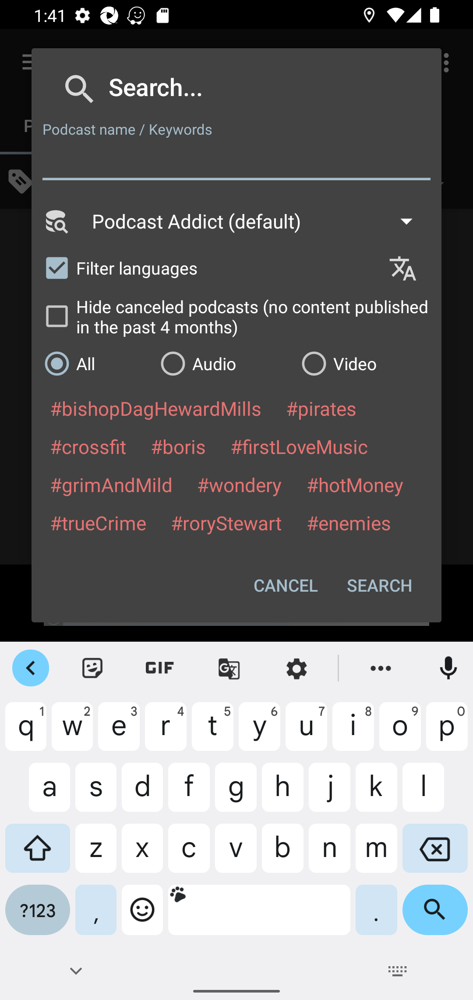

{'textfield_path': 'data/OSS/textfield_contexts/Podcast_Addict_Podcast_player_v2022.4_1/pattern', 'textfield_info': {'index': '0', 'package': 'com.bambuna.podcastaddict', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Podcast name / Keywords', 'resource-id': 'pattern', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'true', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[86,306][994,430]', 'displayed': 'true'}, 'app_name': 'Podcast_Addict_Podcast_player_v2022.4', 'screenshot_path': 'data/OSS/snapshots/Podcast_Addict_Podcast_player_v2022.4/-596023753/screenshot.png', 'textfield_tokens': ['name', 'keywords', 'podcast', 'pattern'], 'local_context': [], 'global_context': ['selection', 'true', 'name', '1', 'audio', 'icon', 'crossfit', 'boris', 'wondery', 'hot', 'filter', 'grim', 'music', 'rory', 'default', 'panel', 'action', 'he', 'stewart', 'parent', 'custom', 

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                        BBC_News_v5.23.0
tf_path                        data/OSS/textfield_contexts/BBC_News_v5.23.0_1...
pred_top1                                                         [search, news]
GT_categories                                               {'search': ['news']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.4373947240412235), (description, 0...
secondary_categories_ranked    [(news, 0.5882747011880081), (location, 0.6595...
Name: 832, dtype: object

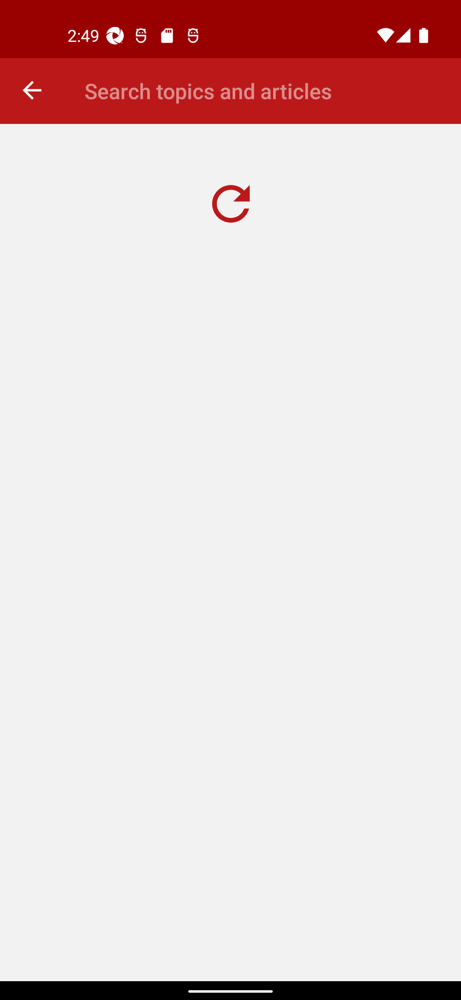

{'textfield_path': 'data/OSS/textfield_contexts/BBC_News_v5.23.0_1/search', 'textfield_info': {'index': '2', 'package': 'bbc.mobile.news.ww', 'class': 'android.widget.EditText', 'text': 'Search topics and articles', 'resource-id': 'search', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[198,179][1058,246]', 'displayed': 'true'}, 'app_name': 'BBC_News_v5.23.0', 'screenshot_path': 'data/OSS/snapshots/BBC_News_v5.23.0/-1912259750/screenshot.png', 'textfield_tokens': ['search', 'articles', 'topics', 'and'], 'local_context': ['toolbar', 'back', 'search', 'articles', 'topics', 'and'], 'global_context': ['action', 'bar', 'container', 'toolbar', 'drawer', 'and', 'articles', 'topics', 'root', 'back', 'navigation', 'content', 'layout', 'background', 'search', 'list']}

##845


source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                Podcast_Player_v7.0.0-220308033.rd0a0ae8
tf_path                        data/OSS/textfield_contexts/Podcast_Player_v7....
pred_top1                                                      [search, podcast]
GT_categories                                            {'search': ['podcast']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.40775956933697066), (description, ...
secondary_categories_ranked    [(podcast, 0.6197788181404273), (tv_show, 0.68...
Name: 844, dtype: object

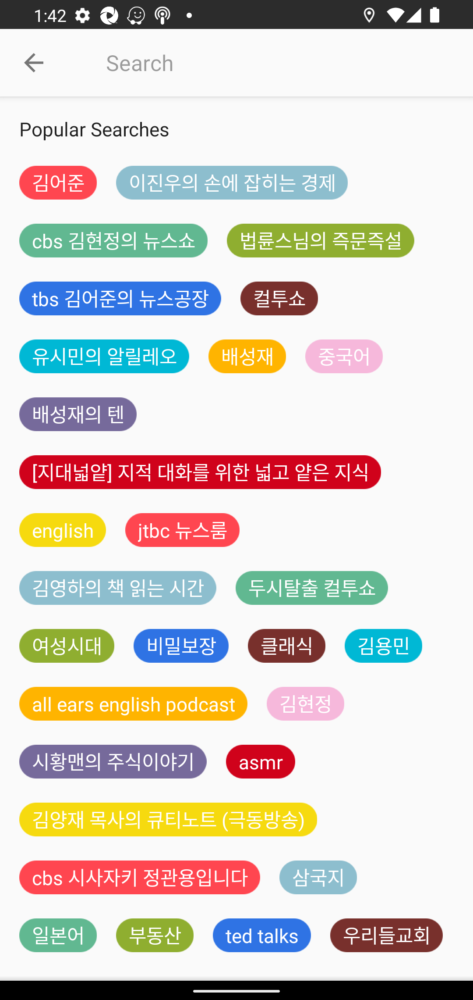

{'textfield_path': 'data/OSS/textfield_contexts/Podcast_Player_v7.0.0-220308033.rd0a0ae8_1/zk', 'textfield_info': {'index': '0', 'package': 'com.podcast.podcasts', 'class': 'android.widget.AutoCompleteTextView', 'text': 'Search', 'resource-id': 'zk', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'true', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[220,93][1056,192]', 'displayed': 'true'}, 'app_name': 'Podcast_Player_v7.0.0-220308033.rd0a0ae8', 'screenshot_path': 'data/OSS/snapshots/Podcast_Player_v7.0.0-220308033.rd0a0ae8/-1405221607/screenshot.png', 'textfield_tokens': ['search', 'zk'], 'local_context': ['zj', 'search', 'zk'], 'global_context': ['j', 'english', 'b', 'ze', 'cbs', 'zk', 'q', 'u', 'a', 'av', 'zb', '7', '3', 'zj', 'content', 'ears', 'background', 'collapse', 'search', 'talks', 'asmr', '5', 'o', 'tbs', 'all', 'searches', '0', 'rb', 'bar', 'zf', '2'

source                                          data/textfield_features_OSS.json
setting                                                         weight_g_0.3_0.5
app_name                                                      deep.ryd.rydplayer
tf_path                        data/OSS/textfield_contexts/deep.ryd.rydplayer...
pred_top1                                                  [music, playlist_url]
GT_categories                                        {'music': ['playlist_url']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(music, 0.5125475086271762), (description, 0....
secondary_categories_ranked    [(playlist_url, 0.0), (song, 0.514916801825165...
Name: 856, dtype: object

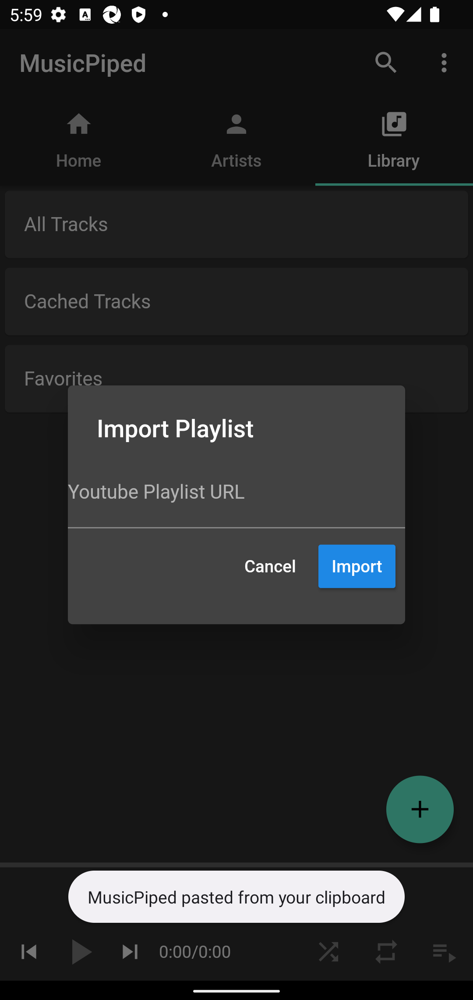

{'textfield_path': 'data/OSS/textfield_contexts/deep.ryd.rydplayer_1/617068565', 'textfield_info': {'index': '0', 'package': 'deep.ryd.rydplayer', 'class': 'android.widget.EditText', 'text': 'Youtube Playlist URL', 'resource-id': '', 'checkable': 'false', 'checked': 'false', 'clickable': 'true', 'enabled': 'true', 'focusable': 'true', 'focused': 'false', 'long-clickable': 'false', 'password': 'false', 'scrollable': 'false', 'selected': 'false', 'bounds': '[155,1041][925,1203]', 'displayed': 'true'}, 'app_name': 'deep.ryd.rydplayer', 'screenshot_path': 'data/OSS/snapshots/deep.ryd.rydplayer/-762092943/screenshot.png', 'textfield_tokens': ['url', 'playlist', 'youtube'], 'local_context': ['url', 'playlist', 'youtube', 'cancel', 'import'], 'global_context': ['bar', 'playlist', 'import', 'clipboard', 'cancel', 'youtube', 'from', 'pasted', 'url', 'navigation', 'content', 'background', 'your', 'piped', 'music']}

##869


source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                My Files
tf_path                        data/samsung_internal/My Files/state_2022-11-0...
pred_top1                                                      [search, storage]
GT_categories                                            {'search': ['storage']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.4639335094640652), (description, 0...
secondary_categories_ranked    [(storage, 0.4450510715444883), (video, 0.4576...
Name: 868, dtype: object

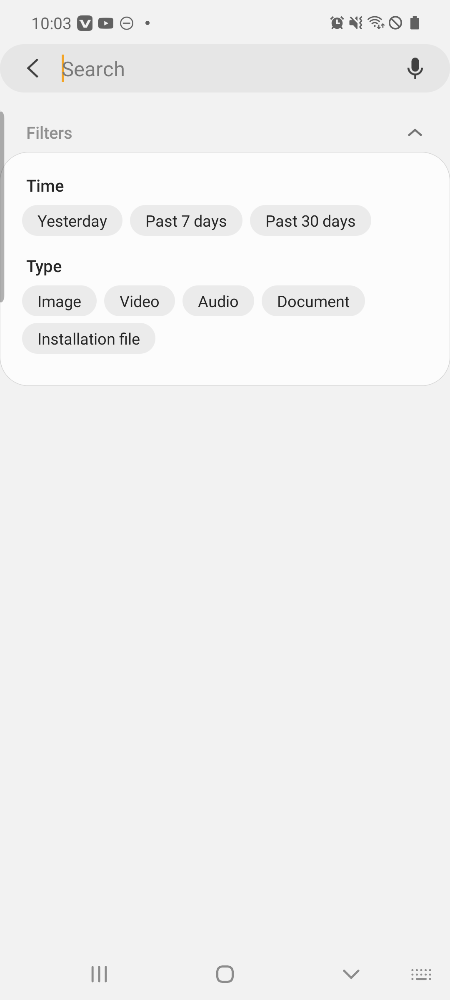

{'textfield_path': 'data/samsung_internal/My Files/state_2022-11-02_100330860289.json:search_src_text', 'textfield_info': {'activity_name': 'com.sec.android.app.myfiles/.external.ui.MainActivity', 'resource_id': 'com.sec.android.app.myfiles:id/search_src_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Search', 'text_hint': 'None', 'bounds': '[137, 106, 939, 222]', 'rel_bounds': '[137, 106, 939, 222]', 'uid': '2fcff61a871a31d9fc069d074d991edb', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.myfiles', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'search_src_text', 'content-desc': 'None'}, 'app_name': 'My Files', 'screenshot_path': 'data/samsung_internal/My Files/screen_2022-

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                My Files
tf_path                        data/samsung_internal/My Files/state_2022-11-0...
pred_top1                                                      [search, storage]
GT_categories                                            {'search': ['storage']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.45947310167054334), (description, ...
secondary_categories_ranked    [(storage, 0.4368847707907359), (video, 0.4536...
Name: 880, dtype: object

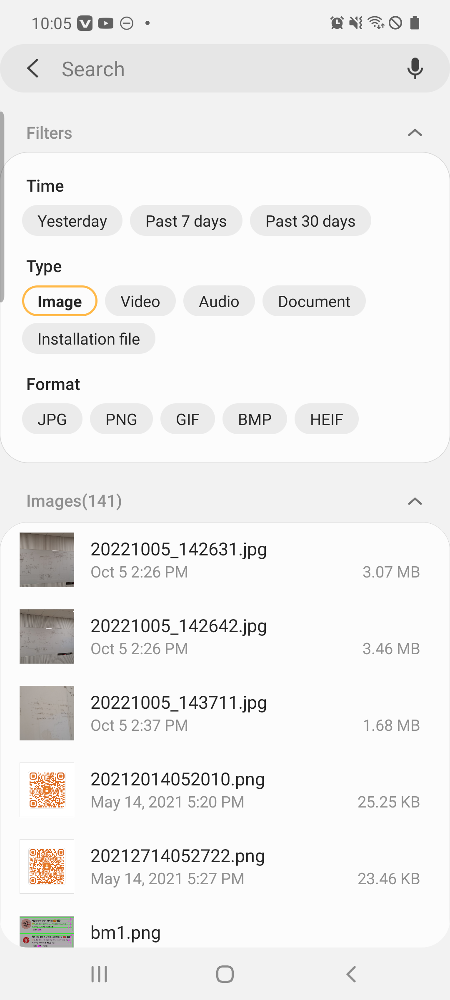

{'textfield_path': 'data/samsung_internal/My Files/state_2022-11-02_100555195131.json:search_src_text', 'textfield_info': {'activity_name': 'com.sec.android.app.myfiles/.external.ui.MainActivity', 'resource_id': 'com.sec.android.app.myfiles:id/search_src_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Search', 'text_hint': 'None', 'bounds': '[137, 106, 939, 222]', 'rel_bounds': '[137, 106, 939, 222]', 'uid': '2fcff61a871a31d9fc069d074d991edb', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.myfiles', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'search_src_text', 'content-desc': 'None'}, 'app_name': 'My Files', 'screenshot_path': 'data/samsung_internal/My Files/screen_2022-

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                             SmartThings
tf_path                        data/samsung_internal/SmartThings/state_2022-1...
pred_top1                                                   [location, location]
GT_categories                                         {'location': ['location']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(location, 0.4413842002550761), (profile, 0.5...
secondary_categories_ranked    [(location, 0.23313652724027634), (city, 0.654...
Name: 892, dtype: object

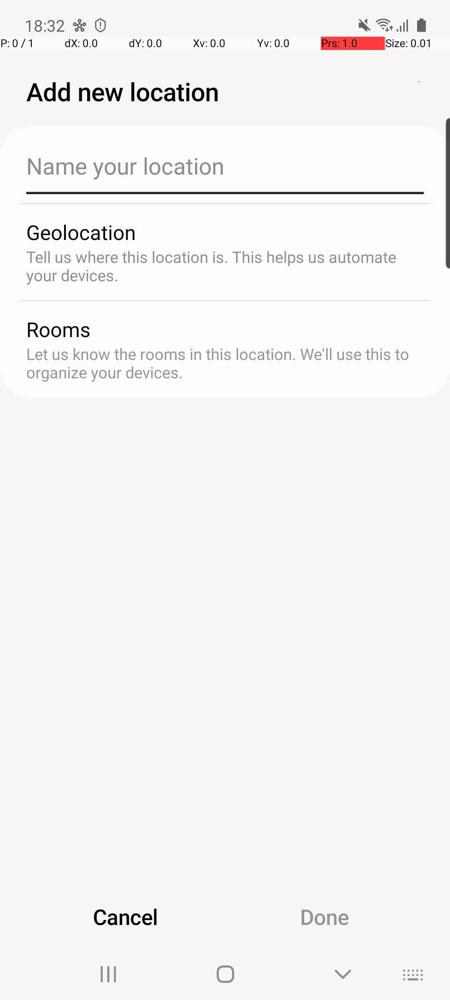

{'textfield_path': 'data/samsung_internal/SmartThings/state_2022-11-01_183300373138.json:edit_text_name', 'textfield_info': {'activity_name': 'com.samsung.android.oneconnect/.ui.mainmenu.addlocation.AddNewLocationActivity', 'resource_id': 'com.samsung.android.oneconnect:id/edit_text_name', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Name your location', 'text_hint': 'None', 'bounds': '[47, 303, 1017, 466]', 'rel_bounds': '[47, 303, 1017, 466]', 'uid': '41b60dd63a1c06fa2e35683801704b67', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.oneconnect', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'edit_text_name', 'content-desc': 'None'}, 'app_name': 'SmartThings', 'screenshot_path'

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                             SmartThings
tf_path                        data/samsung_internal/SmartThings/state_2022-1...
pred_top1                                             [profile, samsung_account]
GT_categories                          {'profile': ['samsung_account', 'email']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.2779720182220141), (auth_code, 0....
secondary_categories_ranked    [(samsung_account, 0.1031504472096761), (email...
Name: 904, dtype: object

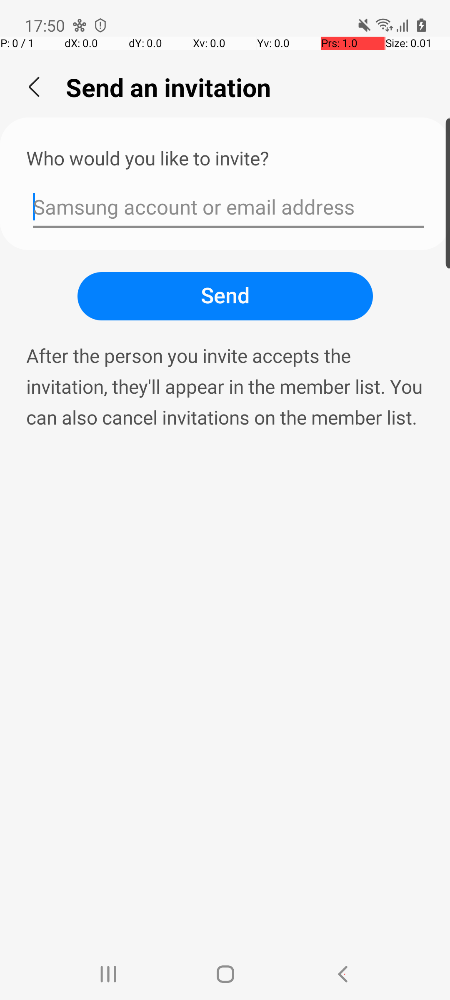

{'textfield_path': 'data/samsung_internal/SmartThings/state_2022-11-01_175008826290.json:inviteAccountText', 'textfield_info': {'activity_name': 'com.samsung.android.oneconnect/.ui.invite.view.InviteUsingEmailActivity', 'resource_id': 'com.samsung.android.oneconnect:id/inviteAccountText', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Samsung account or email address', 'text_hint': 'None', 'bounds': '[63, 463, 1017, 547]', 'rel_bounds': '[63, 463, 1017, 547]', 'uid': '7c5be68203edfd90d97a865a8ed73c0c', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.oneconnect', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'inviteAccountText', 'content-desc': 'None'}, 'app_name': 'SmartThings', '

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                             SmartThings
tf_path                        data/samsung_internal/SmartThings/state_2022-1...
pred_top1                                                   [search, iot_device]
GT_categories                                         {'search': ['iot_device']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.426839904487133), (profile, 0.6330...
secondary_categories_ranked    [(iot_device, 0.1313779279589653), (storage, 0...
Name: 916, dtype: object

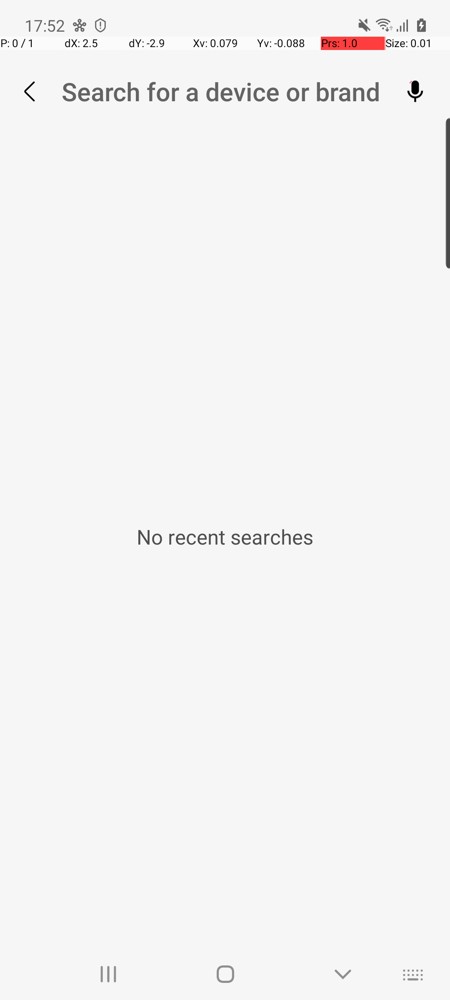

{'textfield_path': 'data/samsung_internal/SmartThings/state_2022-11-01_175242663868.json:search_src_text', 'textfield_info': {'activity_name': 'com.samsung.android.oneconnect/.ui.catalog.adddevice.search.activity.DeviceCatalogSearchActivity', 'resource_id': 'com.samsung.android.oneconnect:id/search_src_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Search for a device or brand', 'text_hint': 'None', 'bounds': '[137, 178, 939, 260]', 'rel_bounds': '[137, 178, 939, 260]', 'uid': 'e44212ea8efc951ef178e24a7e8d0684', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.oneconnect', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'search_src_text', 'content-desc': 'None'}, 'app_name': '

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Messages
tf_path                        data/samsung_internal/Messages/state_2022-11-0...
pred_top1                                                 [messenger, recipient]
GT_categories                                       {'messenger': ['recipient']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(messenger, 0.6031806118786335), (profile, 0....
secondary_categories_ranked    [(recipient, 0.22014928857485452), (message, 0...
Name: 940, dtype: object

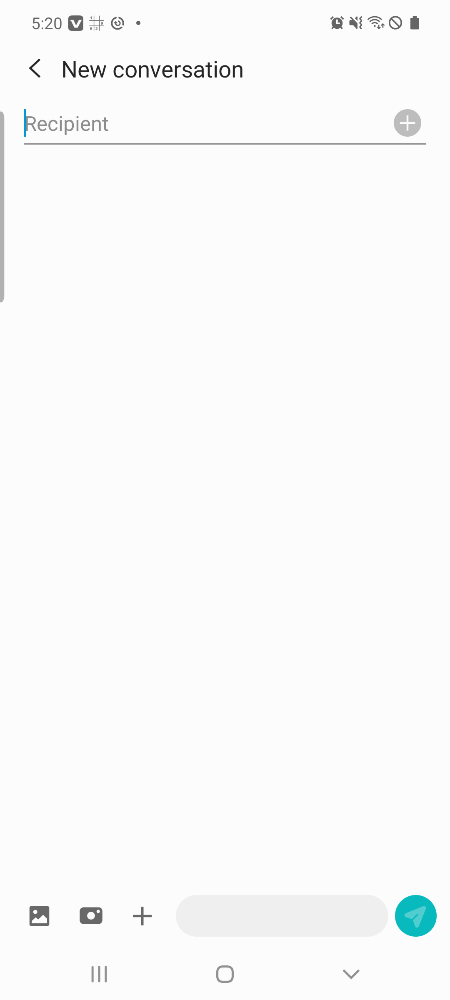

{'textfield_path': 'data/samsung_internal/Messages/state_2022-11-01_172019083263.json:recipients_editor_to', 'textfield_info': {'activity_name': 'com.samsung.android.messaging/com.android.mms.ui.ConversationComposer', 'resource_id': 'com.samsung.android.messaging:id/recipients_editor_to', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Recipient', 'text_hint': 'None', 'bounds': '[58, 262, 918, 328]', 'rel_bounds': '[58, 262, 918, 328]', 'uid': '382b41f84e0ec16af4026c9965ceb092', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.messaging', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'recipients_editor_to', 'content-desc': 'None'}, 'app_name': 'Messages', 'screenshot_path': 'data/sa

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Messages
tf_path                        data/samsung_internal/Messages/state_2022-11-0...
pred_top1                                                   [messenger, message]
GT_categories                                         {'messenger': ['message']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(messenger, 0.3585872856279214), (auth_code, ...
secondary_categories_ranked    [(message, 0.2861312267680963), (recipient, 0....
Name: 952, dtype: object

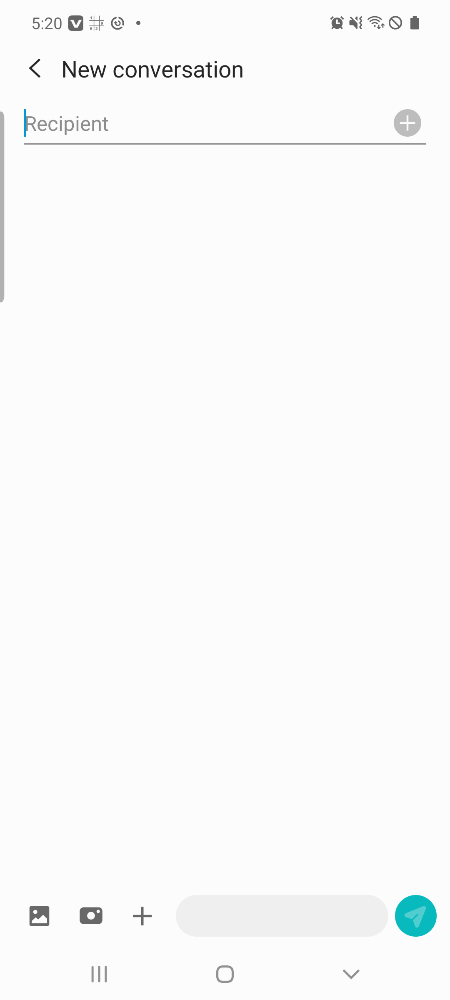

{'textfield_path': 'data/samsung_internal/Messages/state_2022-11-01_172019083263.json:message_edit_text', 'textfield_info': {'activity_name': 'com.samsung.android.messaging/com.android.mms.ui.ConversationComposer', 'resource_id': 'com.samsung.android.messaging:id/message_edit_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': '', 'text_hint': 'None', 'bounds': '[440, 2154, 914, 2242]', 'rel_bounds': '[440, 2154, 914, 2242]', 'uid': '4b3fa5f5a2c65a6fcc317f3b44ee4620', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.messaging', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'message_edit_text', 'content-desc': 'None'}, 'app_name': 'Messages', 'screenshot_path': 'data/samsung_intern

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                            Galaxy Store
tf_path                        data/samsung_internal/Galaxy Store/state_2022-...
pred_top1                                                        [profile, name]
GT_categories                                              {'profile': ['name']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.4579579561948776), (label, 0.5616...
secondary_categories_ranked    [(name, 0.2786439011494319), (phone, 0.4295480...
Name: 964, dtype: object

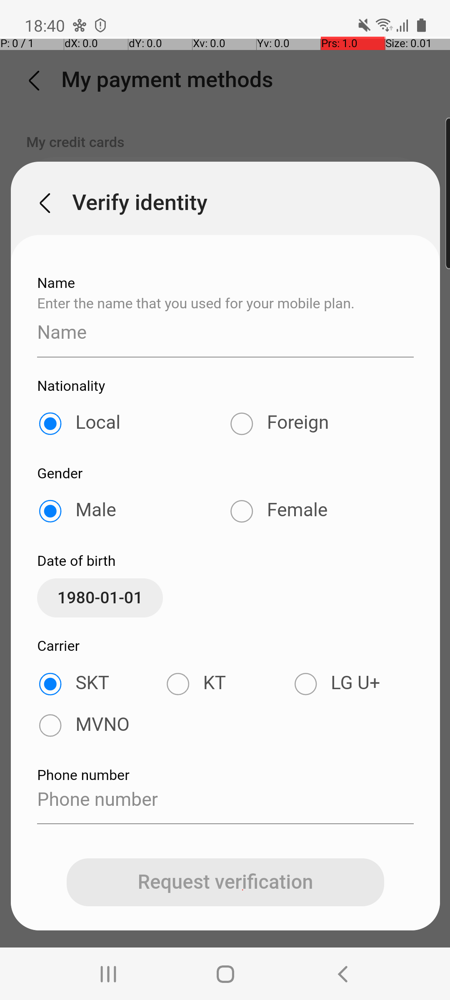

{'textfield_path': 'data/samsung_internal/Galaxy Store/state_2022-11-01_184025384712.json:name', 'textfield_info': {'activity_name': 'com.sec.android.app.billing/.unifiedpayment.activity.CreditCardRegisterActivity', 'resource_id': 'name', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'false', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': '', 'text_hint': 'None', 'bounds': '[86, 725, 994, 859]', 'rel_bounds': '[86, 725, 994, 859]', 'uid': '2a345e25968f5797cb2151451111b411', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.billing', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'name', 'content-desc': 'None'}, 'app_name': 'Galaxy Store', 'screenshot_path': 'data/samsung_internal/Galaxy Store/screen_2022-11-01_184025384712.png', 'textfie

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                            Galaxy Store
tf_path                        data/samsung_internal/Galaxy Store/state_2022-...
pred_top1                                                    [code, coupon_code]
GT_categories                                          {'code': ['coupon_code']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(code, 0.23850253721078235), (auth_code, 0.43...
secondary_categories_ranked    [(coupon_code, 0.12230235834916432), (card_id,...
Name: 988, dtype: object

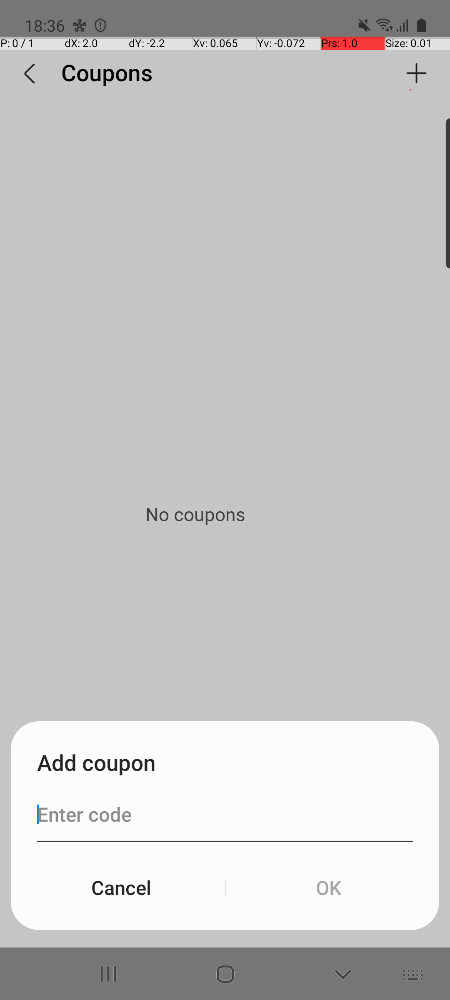

{'textfield_path': 'data/samsung_internal/Galaxy Store/state_2022-11-01_183635589137.json:coupon_edit', 'textfield_info': {'activity_name': 'com.sec.android.app.samsungapps/.promotion.mcs.McsWebViewActivity', 'resource_id': 'com.sec.android.app.samsungapps:id/coupon_edit', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Enter code', 'text_hint': 'None', 'bounds': '[89, 1912, 991, 2020]', 'rel_bounds': '[89, 1912, 991, 2020]', 'uid': '8f70160ffc8e1249dbd54475deac8c99', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.samsungapps', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'coupon_edit', 'content-desc': 'None'}, 'app_name': 'Galaxy Store', 'screenshot_path': 'data/samsung_internal

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                            Galaxy Store
tf_path                        data/samsung_internal/Galaxy Store/state_2022-...
pred_top1                                                          [search, app]
GT_categories                                                {'search': ['app']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.4565422600756089), (auth_code, 0.6...
secondary_categories_ranked    [(app, 0.48459992806116736), (web, 0.675455212...
Name: 1000, dtype: object

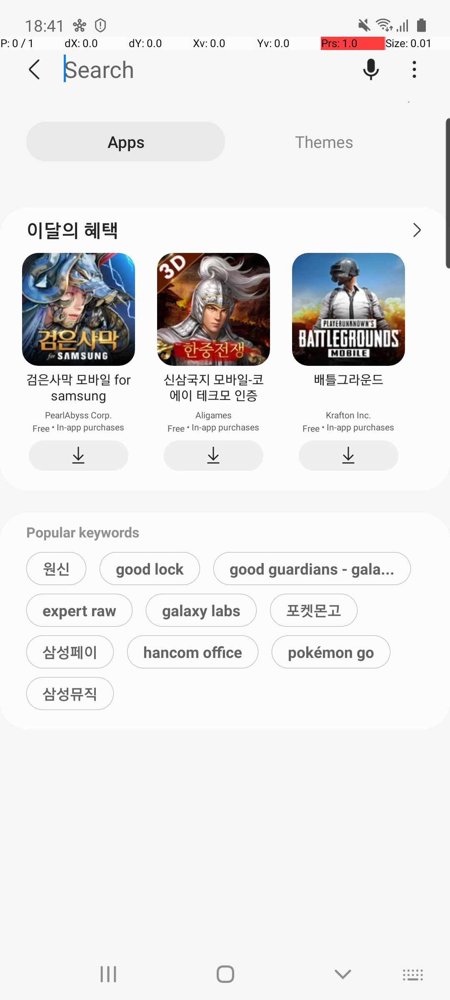

{'textfield_path': 'data/samsung_internal/Galaxy Store/state_2022-11-01_184121181885.json:search_src_text', 'textfield_info': {'activity_name': 'com.sec.android.app.samsungapps/.SearchResultActivity', 'resource_id': 'android:id/search_src_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Search', 'text_hint': 'None', 'bounds': '[153, 118, 680, 213]', 'rel_bounds': '[153, 118, 680, 213]', 'uid': '038c2a2aad1d2ed292ae09d0dc1903c3', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.samsungapps', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'search_src_text', 'content-desc': 'None'}, 'app_name': 'Galaxy Store', 'screenshot_path': 'data/samsung_internal/Galaxy Store/screen_2022-11-0

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Contacts
tf_path                        data/samsung_internal/Contacts/state_2022-11-0...
pred_top1                                                        [profile, name]
GT_categories                                              {'profile': ['name']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.4362713038921356), (label, 0.5243...
secondary_categories_ranked    [(name, 0.3703176137059927), (email, 0.4319608...
Name: 1036, dtype: object

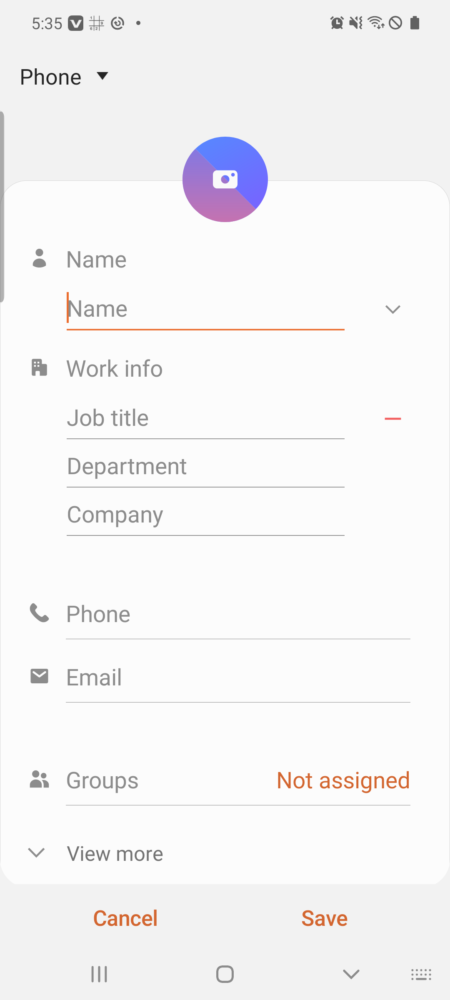

{'textfield_path': 'data/samsung_internal/Contacts/state_2022-11-01_173529930391.json:nameEdit', 'textfield_info': {'activity_name': 'com.samsung.android.app.contacts/com.samsung.android.contacts.editor.ContactEditorActivity', 'resource_id': 'com.samsung.android.app.contacts:id/nameEdit', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Name', 'text_hint': 'None', 'bounds': '[144, 701, 827, 793]', 'rel_bounds': '[144, 701, 827, 793]', 'uid': '3f49fcaf713cbde7ab98449877ba5976', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.app.contacts', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'nameEdit', 'content-desc': 'None'}, 'app_name': 'Contacts', 'screenshot_path': 'data/samsung_intern

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Contacts
tf_path                        data/samsung_internal/Contacts/state_2022-11-0...
pred_top1                                                         [profile, job]
GT_categories                                               {'profile': ['job']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.35501793349782623), (label, 0.411...
secondary_categories_ranked    [(job, 0.20512947191794711), (company, 0.39813...
Name: 1048, dtype: object

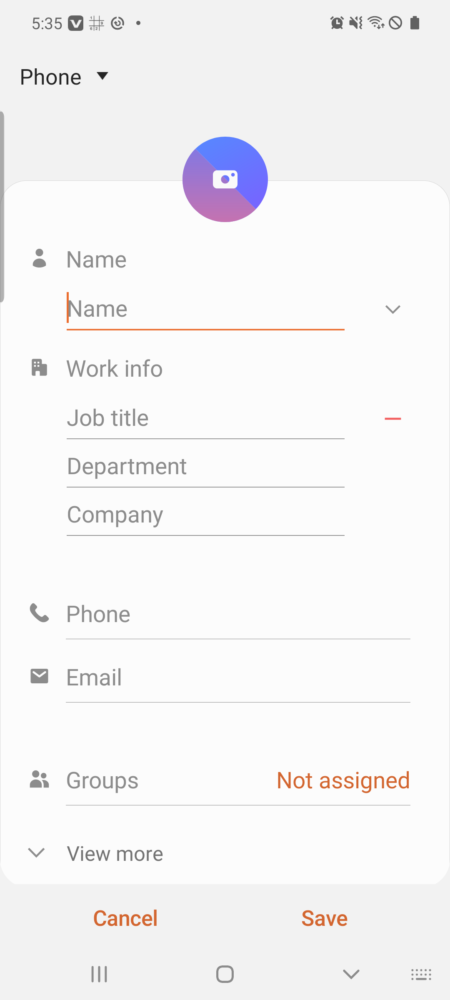

{'textfield_path': 'data/samsung_internal/Contacts/state_2022-11-01_173529930391.json:editOrganizationTitle', 'textfield_info': {'activity_name': 'com.samsung.android.app.contacts/com.samsung.android.contacts.editor.ContactEditorActivity', 'resource_id': 'com.samsung.android.app.contacts:id/editOrganizationTitle', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Job title', 'text_hint': 'None', 'bounds': '[144, 963, 827, 1055]', 'rel_bounds': '[144, 963, 827, 1055]', 'uid': '7a1375a7d0d3888f78c52195d891e748', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.app.contacts', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'editOrganizationTitle', 'content-desc': 'None'}, 'app_name': 'Cont

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Contacts
tf_path                        data/samsung_internal/Contacts/state_2022-11-0...
pred_top1                                                  [profile, department]
GT_categories                                        {'profile': ['department']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.3387673964103063), (auth_code, 0....
secondary_categories_ranked    [(department, 0.23190143518149853), (job, 0.34...
Name: 1060, dtype: object

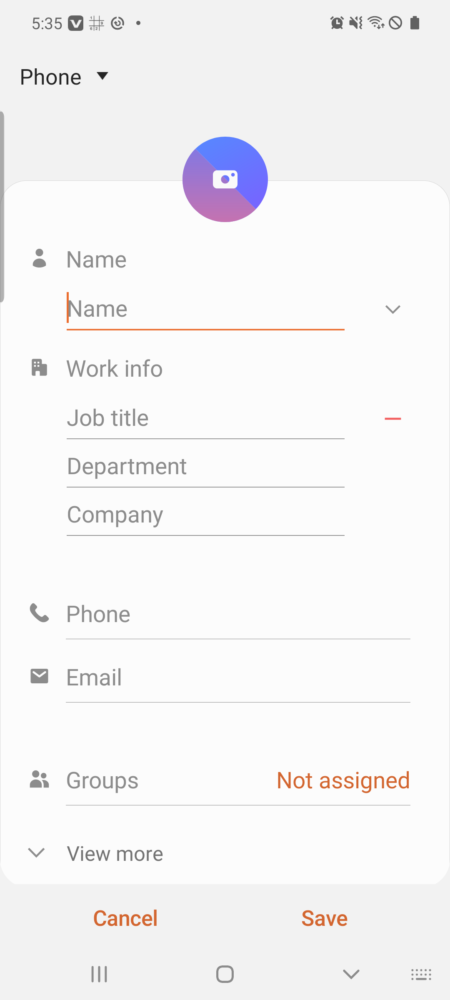

{'textfield_path': 'data/samsung_internal/Contacts/state_2022-11-01_173529930391.json:editOrganizationDepartment', 'textfield_info': {'activity_name': 'com.samsung.android.app.contacts/com.samsung.android.contacts.editor.ContactEditorActivity', 'resource_id': 'com.samsung.android.app.contacts:id/editOrganizationDepartment', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Department', 'text_hint': 'None', 'bounds': '[144, 1079, 827, 1171]', 'rel_bounds': '[144, 1079, 827, 1171]', 'uid': 'dd55922b8dbda53f15f78fabce61ac7d', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.app.contacts', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'editOrganizationDepartment', 'content-desc': 'None'},

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Contacts
tf_path                        data/samsung_internal/Contacts/state_2022-11-0...
pred_top1                                                     [profile, company]
GT_categories                                           {'profile': ['company']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.32645297000805534), (label, 0.610...
secondary_categories_ranked    [(company, 0.22510106085489195), (job, 0.34367...
Name: 1072, dtype: object

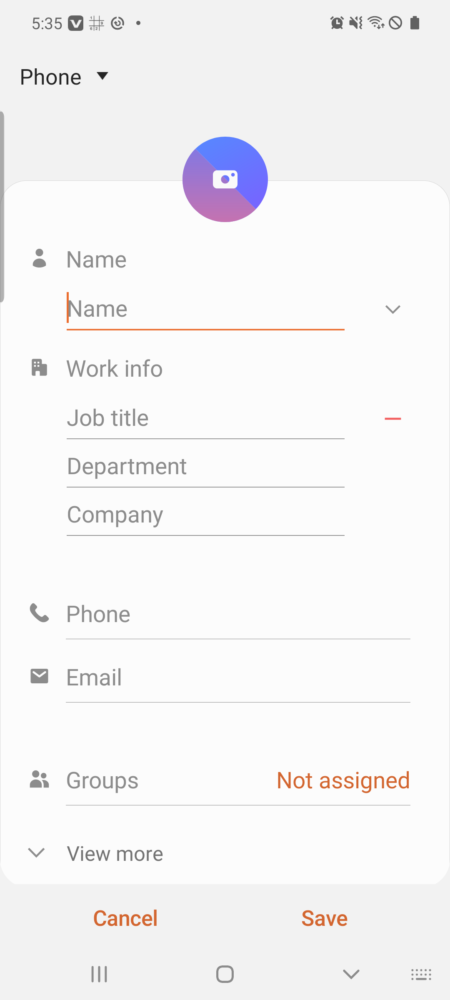

{'textfield_path': 'data/samsung_internal/Contacts/state_2022-11-01_173529930391.json:editOrganizationCompany', 'textfield_info': {'activity_name': 'com.samsung.android.app.contacts/com.samsung.android.contacts.editor.ContactEditorActivity', 'resource_id': 'com.samsung.android.app.contacts:id/editOrganizationCompany', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Company', 'text_hint': 'None', 'bounds': '[144, 1195, 827, 1287]', 'rel_bounds': '[144, 1195, 827, 1287]', 'uid': '5331e810968eb09e5e2b399615b25e55', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.app.contacts', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'editOrganizationCompany', 'content-desc': 'None'}, 'app_name':

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                         Samsung Members
tf_path                        data/samsung_internal/Samsung Members/state_20...
pred_top1                                        [device_profile, serial_number]
GT_categories                              {'device_profile': ['serial_number']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(device_profile, 0.5856691269824902), (profil...
secondary_categories_ranked    [(serial_number, 0.47755449203153455), (model_...
Name: 1096, dtype: object

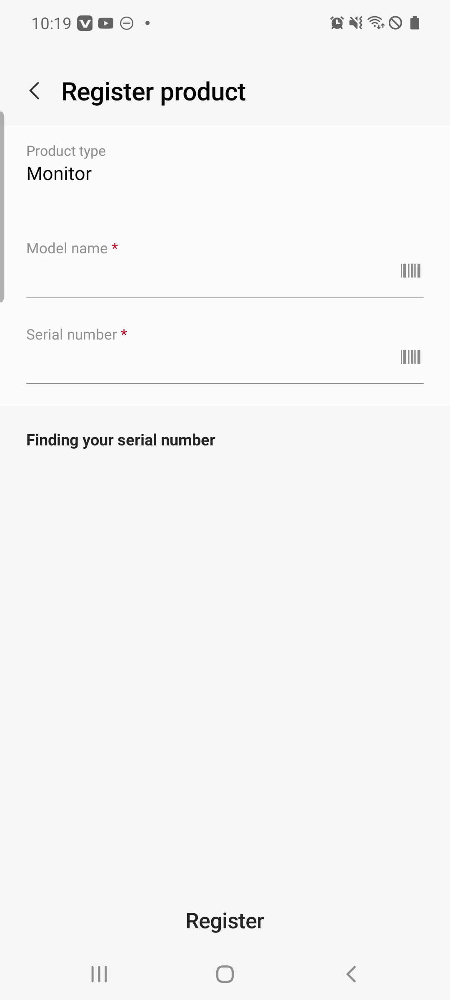

{'textfield_path': 'data/samsung_internal/Samsung Members/state_2022-11-02_101955202341.json:inputEditText', 'textfield_info': {'activity_name': 'com.samsung.android.voc/.myproduct.register.ProductRegisterActivity', 'resource_id': 'com.samsung.android.voc:id/inputEditText', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'None', 'text_hint': 'None', 'bounds': '[47, 825, 1017, 922]', 'rel_bounds': '[47, 825, 1017, 922]', 'uid': '89b573c1d10401ea5d9e839fb97eaf1a', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.voc', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'inputEditText', 'content-desc': 'None'}, 'app_name': 'Samsung Members', 'screenshot_path': 'data/samsung_internal/Samsung M

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                         Samsung Members
tf_path                        data/samsung_internal/Samsung Members/state_20...
pred_top1                                                    [profile, username]
GT_categories                                          {'profile': ['username']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(profile, 0.6354260449608167), (label, 0.6795...
secondary_categories_ranked    [(username, 0.3134225991864999), (name, 0.5065...
Name: 1108, dtype: object

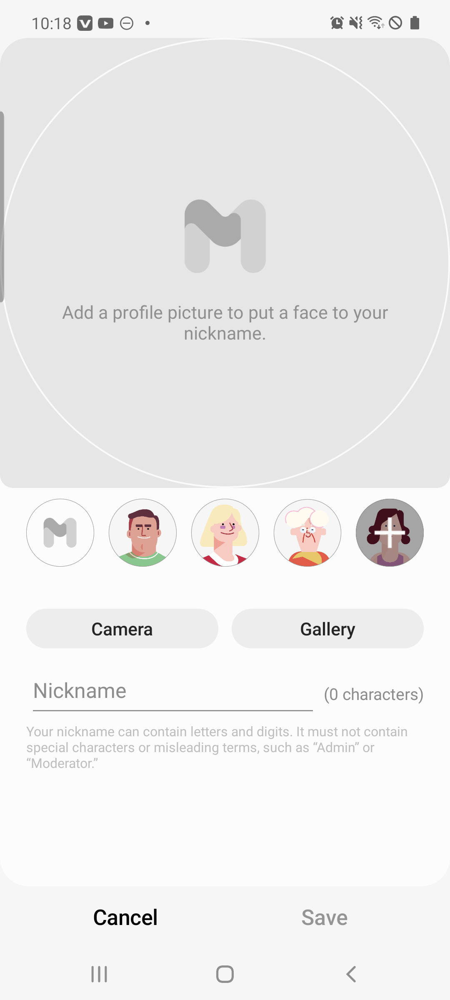

{'textfield_path': 'data/samsung_internal/Samsung Members/state_2022-11-02_101839943819.json:nickname', 'textfield_info': {'activity_name': 'com.samsung.android.voc/.community.myprofile.ProfileEditActivity', 'resource_id': 'com.samsung.android.voc:id/nickname', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Nickname', 'text_hint': 'None', 'bounds': '[63, 1622, 751, 1707]', 'rel_bounds': '[63, 1622, 751, 1707]', 'uid': 'cc8e6926ffee83ae4239837a93a5be26', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.voc', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'nickname', 'content-desc': 'None'}, 'app_name': 'Samsung Members', 'screenshot_path': 'data/samsung_internal/Samsung Members/scree

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                        Samsung Internet
tf_path                        data/samsung_internal/Samsung Internet/state_2...
pred_top1                                                          [search, web]
GT_categories                                                {'search': ['web']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(search, 0.423888948559761), (location, 0.534...
secondary_categories_ranked    [(web, 0.377252034842968), (location, 0.525221...
Name: 1132, dtype: object

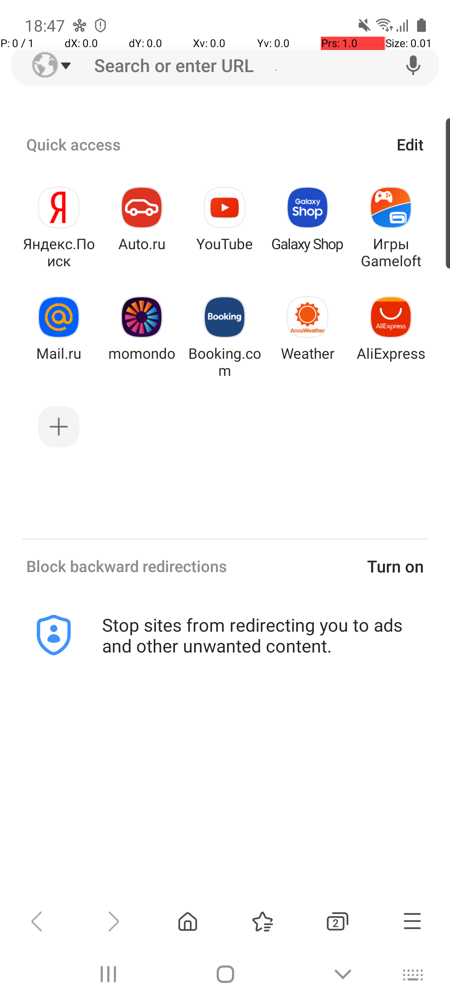

{'textfield_path': 'data/samsung_internal/Samsung Internet/state_2022-11-01_184749322308.json:location_bar_edit_text', 'textfield_info': {'activity_name': 'com.sec.android.app.sbrowser/.SBrowserMainActivity', 'resource_id': 'com.sec.android.app.sbrowser:id/location_bar_edit_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Search or enter URL', 'text_hint': 'None', 'bounds': '[205, 106, 959, 206]', 'rel_bounds': '[205, 106, 959, 206]', 'uid': '3790f1a46c671e6c0702330849f8e12b', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.sbrowser', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'location_bar_edit_text', 'content-desc': 'None'}, 'app_name': 'Samsung Internet', 'screenshot_pa

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                   Clock
tf_path                        data/samsung_internal/Clock/state_2022-11-01_1...
pred_top1                                                    [location, country]
GT_categories                   {'search': ['country'], 'location': ['country']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(location, 0.0), (profile, 0.3594583963354428...
secondary_categories_ranked    [(country, 0.16187579929828644), (city, 0.1914...
Name: 1144, dtype: object

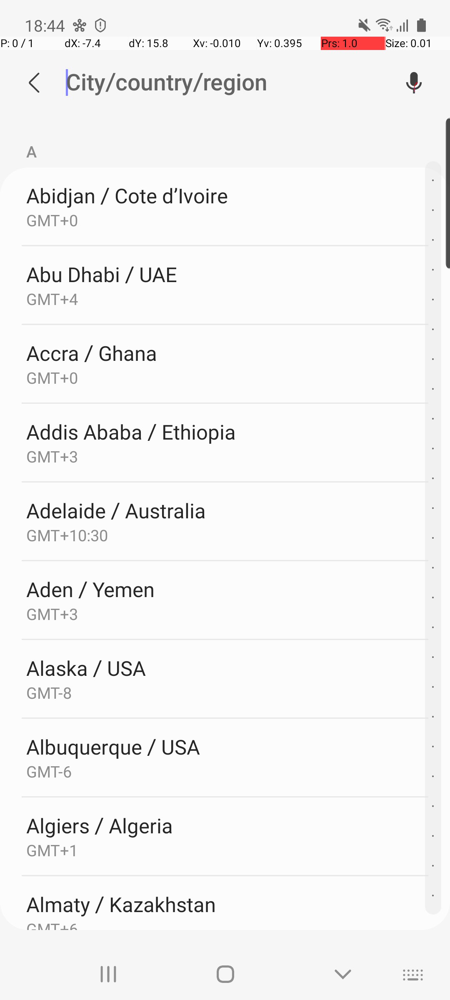

{'textfield_path': 'data/samsung_internal/Clock/state_2022-11-01_184421020236.json:worldclock_search_map_txt_find', 'textfield_info': {'activity_name': 'com.sec.android.app.clockpackage/.worldclock.viewmodel.WorldclockGlobeMain', 'resource_id': 'com.sec.android.app.clockpackage:id/worldclock_search_map_txt_find', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'City/country/region', 'text_hint': 'None', 'bounds': '[158, 140, 928, 256]', 'rel_bounds': '[158, 140, 928, 256]', 'uid': '16adb8c6527f4412ad75dc214239b2dd', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.clockpackage', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'worldclock_search_map_txt_find', 'content-desc': 'None'}, '

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                   Clock
tf_path                        data/samsung_internal/Clock/state_2022-11-01_1...
pred_top1                                                       [datetime, hour]
GT_categories                                             {'datetime': ['hour']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(datetime, 0.6452925351758797), (profile, 0.7...
secondary_categories_ranked    [(hour, 0.46299660826722777), (minute, 0.57033...
Name: 1180, dtype: object

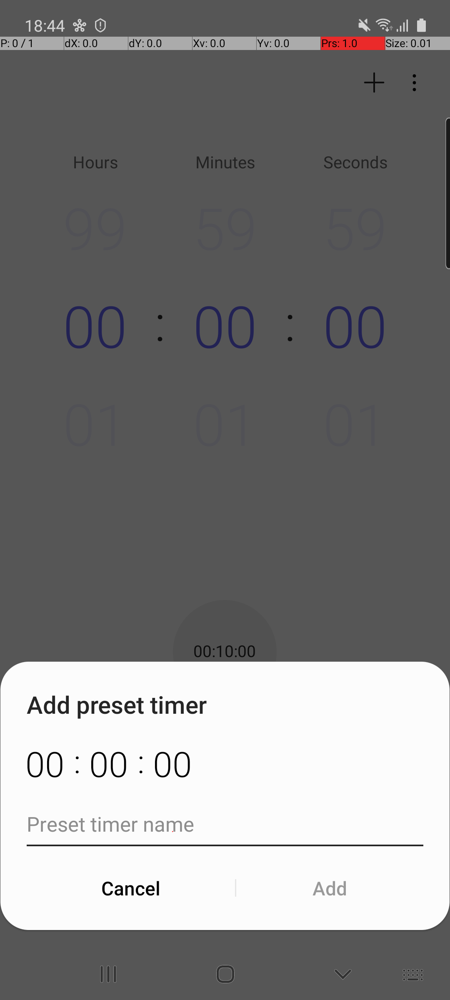

{'textfield_path': 'data/samsung_internal/Clock/state_2022-11-01_184455299444.json:hour', 'textfield_info': {'activity_name': 'com.sec.android.app.clockpackage/.ClockPackage', 'resource_id': 'com.sec.android.app.clockpackage:id/hour', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': '00', 'text_hint': 'None', 'bounds': '[48, 1787, 169, 1886]', 'rel_bounds': '[48, 1787, 169, 1886]', 'uid': '787a173ee52daf26bec91c7c87282150', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.clockpackage', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'hour', 'content-desc': 'None'}, 'app_name': 'Clock', 'screenshot_path': 'data/samsung_internal/Clock/screen_2022-11-01_184455299444.png', 'textfield_token

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                   Clock
tf_path                        data/samsung_internal/Clock/state_2022-11-01_1...
pred_top1                                                     [datetime, minute]
GT_categories                                           {'datetime': ['minute']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(datetime, 0.6462606328229109), (profile, 0.7...
secondary_categories_ranked    [(minute, 0.45477667450904846), (hour, 0.57855...
Name: 1192, dtype: object

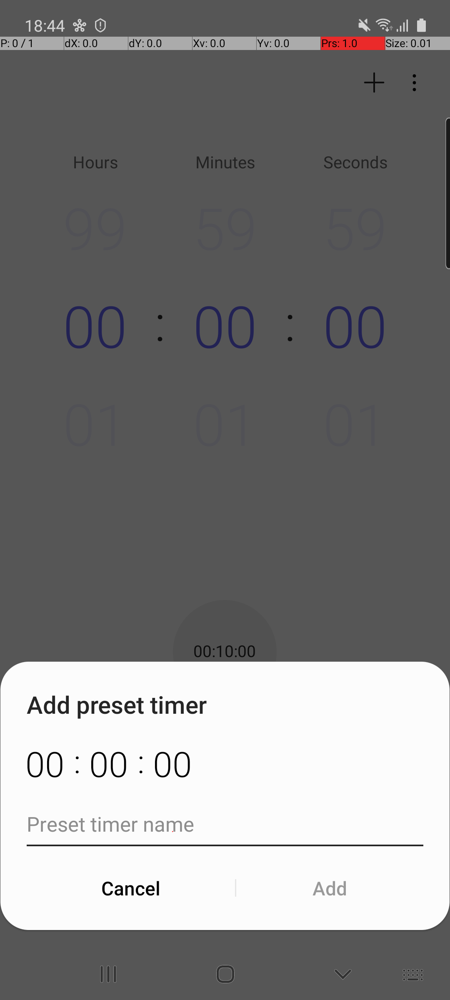

{'textfield_path': 'data/samsung_internal/Clock/state_2022-11-01_184455299444.json:minute', 'textfield_info': {'activity_name': 'com.sec.android.app.clockpackage/.ClockPackage', 'resource_id': 'com.sec.android.app.clockpackage:id/minute', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': '00', 'text_hint': 'None', 'bounds': '[201, 1787, 322, 1886]', 'rel_bounds': '[201, 1787, 322, 1886]', 'uid': '4d974e44eff699a31b813f309cf0fe8b', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.clockpackage', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'minute', 'content-desc': 'None'}, 'app_name': 'Clock', 'screenshot_path': 'data/samsung_internal/Clock/screen_2022-11-01_184455299444.png', 'textfie

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                   Clock
tf_path                        data/samsung_internal/Clock/state_2022-11-01_1...
pred_top1                                                     [datetime, second]
GT_categories                                           {'datetime': ['second']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(datetime, 0.6586182167132695), (profile, 0.7...
secondary_categories_ranked    [(second, 0.5160047913280627), (time, 0.673015...
Name: 1204, dtype: object

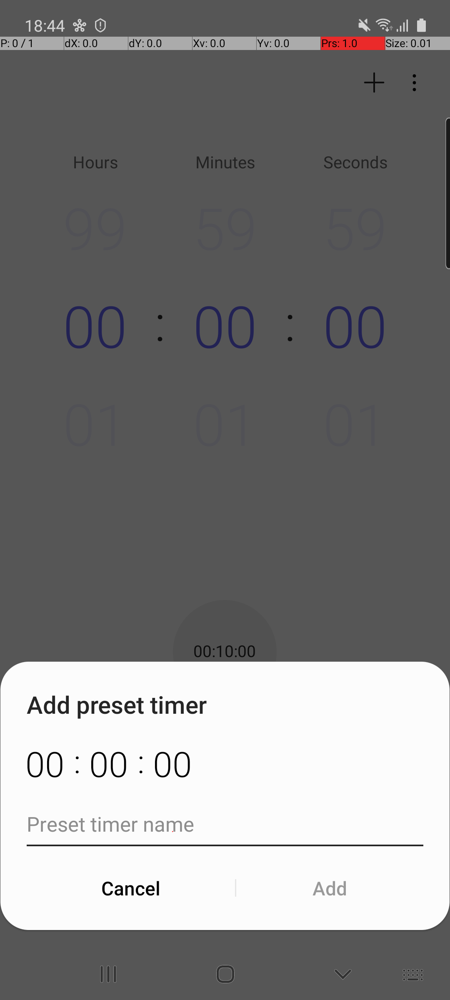

{'textfield_path': 'data/samsung_internal/Clock/state_2022-11-01_184455299444.json:second', 'textfield_info': {'activity_name': 'com.sec.android.app.clockpackage/.ClockPackage', 'resource_id': 'com.sec.android.app.clockpackage:id/second', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': '00', 'text_hint': 'None', 'bounds': '[354, 1787, 475, 1886]', 'rel_bounds': '[354, 1787, 475, 1886]', 'uid': '484d3e7feca69f9d55d8788cb4159dff', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.sec.android.app.clockpackage', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'second', 'content-desc': 'None'}, 'app_name': 'Clock', 'screenshot_path': 'data/samsung_internal/Clock/screen_2022-11-01_184455299444.png', 'textfie

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Calendar
tf_path                        data/samsung_internal/Calendar/state_2022-11-0...
pred_top1                                                          [label, None]
GT_categories                                                      {'label': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(label, 0.2421195566654205), (description, 0....
secondary_categories_ranked                                                   []
Name: 1228, dtype: object

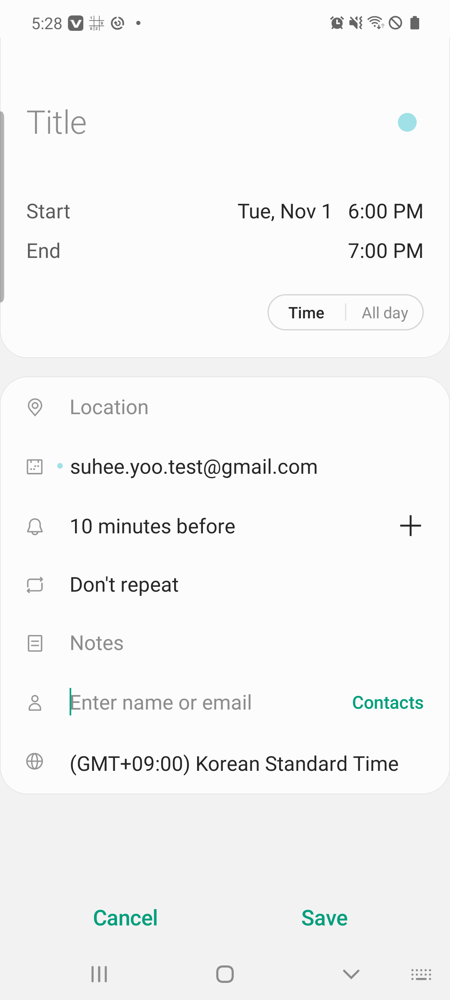

{'textfield_path': 'data/samsung_internal/Calendar/state_2022-11-01_172842215734.json:title', 'textfield_info': {'activity_name': 'com.samsung.android.calendar/com.samsung.android.app.calendar.activity.DetailActivity', 'resource_id': 'com.samsung.android.calendar:id/title', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Title', 'text_hint': 'None', 'bounds': '[63, 238, 906, 343]', 'rel_bounds': '[63, 238, 906, 343]', 'uid': 'b8c38a0b2e5438f6c58c9256b982a28b', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.calendar', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'title', 'content-desc': 'None'}, 'app_name': 'Calendar', 'screenshot_path': 'data/samsung_internal/Calendar/screen_2022

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Calendar
tf_path                        data/samsung_internal/Calendar/state_2022-11-0...
pred_top1                                                   [location, location]
GT_categories                                         {'location': ['location']}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(location, 0.27741306473811467), (datetime, 0...
secondary_categories_ranked    [(location, 0.11815407623847325), (city, 0.632...
Name: 1240, dtype: object

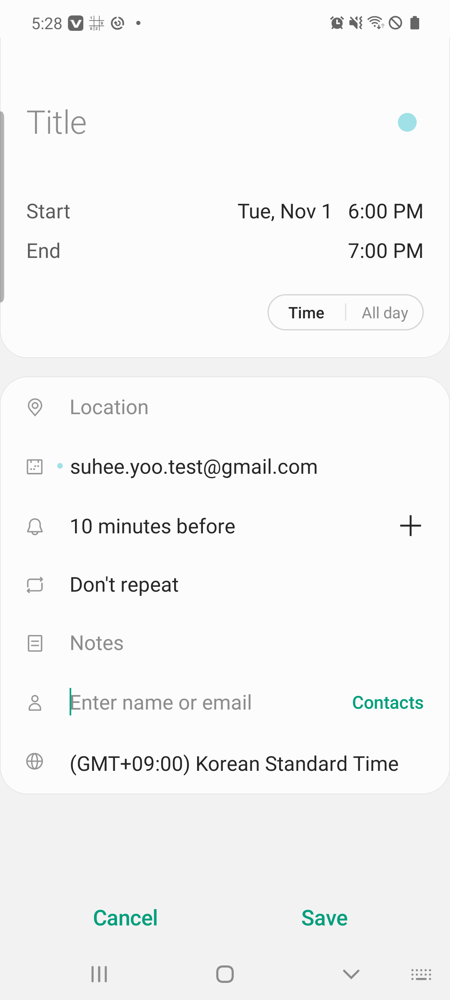

{'textfield_path': 'data/samsung_internal/Calendar/state_2022-11-01_172842215734.json:location', 'textfield_info': {'activity_name': 'com.samsung.android.calendar/com.samsung.android.app.calendar.activity.DetailActivity', 'resource_id': 'com.samsung.android.calendar:id/location', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Location', 'text_hint': 'None', 'bounds': '[167, 907, 996, 1044]', 'rel_bounds': '[167, 907, 996, 1044]', 'uid': '5c6f07d83d9b5fa70a7e128d51d7b237', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.calendar', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'location', 'content-desc': 'None'}, 'app_name': 'Calendar', 'screenshot_path': 'data/samsung_internal/Cale

source                                      data/textfield_features_samsung.json
setting                                                         weight_g_0.3_0.5
app_name                                                                Calendar
tf_path                        data/samsung_internal/Calendar/state_2022-11-0...
pred_top1                                                    [description, None]
GT_categories                                                {'description': []}
pcat_rank                                                                      1
scat_rank                                                                      1
primary_categories_ranked      [(description, 0.3755759512384732), (auth_code...
secondary_categories_ranked                                                   []
Name: 1252, dtype: object

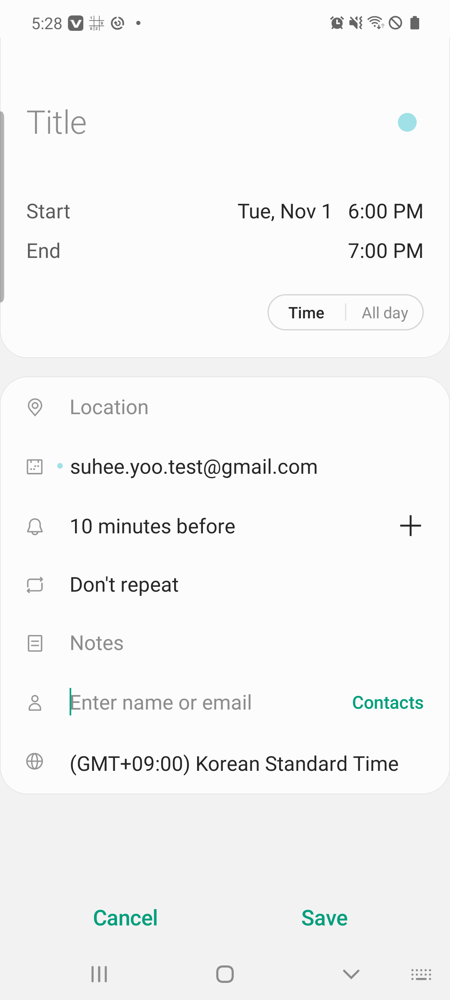

{'textfield_path': 'data/samsung_internal/Calendar/state_2022-11-01_172842215734.json:note_text', 'textfield_info': {'activity_name': 'com.samsung.android.calendar/com.samsung.android.app.calendar.activity.DetailActivity', 'resource_id': 'com.samsung.android.calendar:id/note_text', 'class': 'android.widget.EditText', 'pointer': 'None', 'content_desc': 'None', 'enabled': 'true', 'visible': 'true', 'checked': 'false', 'selected': 'false', 'editable': 'true', 'clickable': 'true', 'long_clickable': 'true', 'scrollable_horizontal': 'false', 'scrollable_vertical': 'false', 'checkable': 'false', 'text': 'Notes', 'text_hint': 'None', 'bounds': '[167, 1473, 1017, 1610]', 'rel_bounds': '[167, 1473, 1017, 1610]', 'uid': '12bd04673b59081e282e5d3620eadc4c', 'serialize_class': 'AndroidViewTree', 'package_name': 'com.samsung.android.calendar', 'fingerprint': '', 'type': 'textfield', 'resource-id': 'note_text', 'content-desc': 'None'}, 'app_name': 'Calendar', 'screenshot_path': 'data/samsung_internal/

In [89]:
import time
from IPython.display import Image

# df = rank_df[rank_df.pcat_rank > 1]
df = rank_df[rank_df.scat_rank == 1]

tf_features_dict = {}

for ff in queue:
    tf_features_dict[ff] = json.load(open(ff))

for i, row in df.iterrows():
    print(f'##{i+1}')
    display(row)
    tf_info = tf_features_dict[row['source']][row['tf_path']]
    display(Image(filename=tf_info['screenshot_path'], width=200))
    print(tf_info, end='\n\n')
    time.sleep(0.5)
    

In [38]:
(len(rank_df)-16)/len(rank_df)

0.8476190476190476